參考：https://github.com/rishabhd786/VAE-GAN-PYTORCH/blob/master/README.md

論文連結：https://arxiv.org/pdf/1512.09300.pdf

In [ ]:
! pip install -q kaggle

from google.colab import files
files.upload()
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json


In [ ]:
!kaggle datasets download ipythonx/mvtec-ad

In [ ]:
! mkdir mvtec
!unzip mvtec-ad.zip -d mvtec

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import random
import torch
import torchvision
from torchvision import transforms
from torch.utils.data import DataLoader, random_split
from torch import nn
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable
import cv2
from skimage import data, img_as_float
from skimage.metrics import structural_similarity as ssim

In [ ]:
from pathlib import Path
mvtec_path = Path("./mvtec")
capsule_path_train = mvtec_path / "capsule/train/good"
capsule_path_valid = mvtec_path / "capsule/test/good"
capsule_path_test_c = mvtec_path / "capsule/test/crack"
capsule_path_test_f = mvtec_path / "capsule/test/faulty_imprint"
capsule_path_test_p = mvtec_path / "capsule/test/poke"
capsule_path_test_sc = mvtec_path / "capsule/test/scratch"
capsule_path_test_sq = mvtec_path / "capsule/test/squeeze"

In [ ]:
import os
def walk_through_dir(dir_path):
  for dirpath, dirnames, filenames in os.walk(dir_path):
    print(f"There are {len(dirnames)} directories and {len(filenames)} images in '{dirpath}'.")


In [ ]:
walk_through_dir(capsule_path_train)
walk_through_dir(capsule_path_valid)
walk_through_dir(capsule_path_test_c)
walk_through_dir(capsule_path_test_f)
walk_through_dir(capsule_path_test_p)
walk_through_dir(capsule_path_test_sc)
walk_through_dir(capsule_path_test_sq)

In [ ]:
# Write a custom dataset class (inherits from torch.utils.data.Dataset)
from torch.utils.data import Dataset
import pathlib
from PIL import Image

# 1. Subclass torch.utils.data.Dataset
class ImageFolderCustom(Dataset):

    # 2. Initialize with a targ_dir and transform (optional) parameter
    def __init__(self, targ_dir: str, transform=None):

        # 3. Create class attributes
        # Get all image paths
        self.paths = list(pathlib.Path(targ_dir).glob("*.png")) # note: you'd have to update this if you've got .png's or .jpeg's
        #self.paths = list(pathlib.Path(targ_dir).glob("*.jpg")) # note: you'd have to update this if you've got .png's or .jpeg's
        # Setup transforms
        self.transform = transform

    # 4. Make function to load images
    def load_image(self, index: int):
        "Opens an image via a path and returns it."
        image_path = self.paths[index]
        return Image.open(image_path).convert("RGB")

    # 5. Overwrite the __len__() method (optional but recommended for subclasses of torch.utils.data.Dataset)
    def __len__(self) -> int:
        "Returns the total number of samples."
        return len(self.paths)

    # 6. Overwrite the __getitem__() method (required for subclasses of torch.utils.data.Dataset)
    def __getitem__(self, index: int):
        "Returns one sample of data, data and label (X, y)."
        img = self.load_image(index)

        # Transform if necessary
        if self.transform:
            return self.transform(img) # return data, label (X, y)
        else:
            return img # return data, label (X, y)

In [ ]:
transform = transforms.Compose([transforms.Resize([128,128]),transforms.RandomVerticalFlip(p=0.5),transforms.Grayscale(),transforms.ToTensor()])
capsule_train = ImageFolderCustom(capsule_path_train, transform)
capsule_valid = ImageFolderCustom(capsule_path_valid,transform)
capsule_test_c = ImageFolderCustom(capsule_path_test_c, transform)
capsule_test_f = ImageFolderCustom(capsule_path_test_f,transform)
capsule_test_p= ImageFolderCustom(capsule_path_test_p,transform)
capsule_test_sc = ImageFolderCustom(capsule_path_test_sc,transform)
capsule_test_sq= ImageFolderCustom(capsule_path_test_sq,transform)

batch_size = 10
capsule_trainloader = torch.utils.data.DataLoader(capsule_train, batch_size=batch_size, shuffle=True)
capsule_validloader = torch.utils.data.DataLoader(capsule_valid, batch_size=batch_size, shuffle=False)
capsule_test_cloader= torch.utils.data.DataLoader(capsule_test_c, batch_size=batch_size, shuffle=False)
capsule_test_floader= torch.utils.data.DataLoader(capsule_test_f, batch_size=batch_size, shuffle=False)
capsule_test_ploader= torch.utils.data.DataLoader(capsule_test_p, batch_size=batch_size, shuffle=False)
capsule_test_scloader= torch.utils.data.DataLoader(capsule_test_sc, batch_size=batch_size, shuffle=False)
capsule_test_sqloader= torch.utils.data.DataLoader(capsule_test_sq, batch_size=batch_size, shuffle=False)

In [ ]:
def check_visual_data(train_data, test_data):
  img = train_data[0]
  print(f"Image tensor:\n{img}")
  print(f"Image shape: {img.shape}")
  print(f"Image datatype: {img.dtype}")
  for i in range(9):
    image_t =test_data[i]
    img=image_t.permute(1,2,0)
    plt.subplot(3,3,i+1)
    plt.imshow(img.cpu().numpy(), cmap="gray")
    print(image_t.shape)
  plt.show()

In [ ]:
check_visual_data(capsule_train, capsule_valid)

In [ ]:
def check_dataloader(train_loader, val_loader, test_loader):
  img = next(iter(train_loader))
  print(f"Image shape: {img.shape} -> [batch_size, color_channels, height, width]")
  #print(f"Label shape: {label.shape}")
  print("valid part ---------")
  img_vd = next(iter(val_loader))
  print(f"Image shape: {img_vd.shape} -> [batch_size, color_channels, height, width]")
  #print(f"Label shape: {label_vd.shape}")
  print("test part ---------")
  img_test = next(iter(test_loader))
  print(f"Image shape: {img_test.shape} -> [batch_size, color_channels, height, width]")
  #print(f"Label shape: {label_test.shape}")


In [ ]:
check_dataloader(capsule_trainloader, capsule_validloader, capsule_test_floader)

#**define encoder and decoder**

In [ ]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


# **encoder class**

In [ ]:
class Encoder(nn.Module):
  def __init__(self):
    super(Encoder,self).__init__()
    self.conv1=nn.Conv2d(1,64,5,padding=2,stride=2)   #in_channels=3
    self.bn1=nn.BatchNorm2d(64,momentum=0.9)
    self.conv2=nn.Conv2d(64,128,5,padding=2,stride=2)
    self.bn2=nn.BatchNorm2d(128,momentum=0.9)
    self.conv3=nn.Conv2d(128,256,5,padding=2,stride=2)
    self.bn3=nn.BatchNorm2d(256,momentum=0.9)
    self.relu=nn.LeakyReLU(0.2)
    self.fc1=nn.Linear(256*16*16,2048)
    self.bn4=nn.BatchNorm1d(2048,momentum=0.9)
    self.fc_mean=nn.Linear(2048,128)
    self.fc_logvar=nn.Linear(2048,128)   #latent dim=128

  def forward(self,x):
    batch_size=x.size()[0]
    out=self.relu(self.bn1(self.conv1(x)))
    out=self.relu(self.bn2(self.conv2(out)))
    out=self.relu(self.bn3(self.conv3(out)))
    out=out.view(batch_size,-1)
    out=self.relu(self.bn4(self.fc1(out)))
    mean=self.fc_mean(out)
    logvar=self.fc_logvar(out)

    return mean,logvar


# **decoder class**

In [ ]:
class Decoder(nn.Module):
  def __init__(self):
    super(Decoder,self).__init__()
    self.fc1=nn.Linear(128,256*16*16)
    self.bn1=nn.BatchNorm1d(256*16*16,momentum=0.9)
    self.relu=nn.LeakyReLU(0.2)
    self.deconv1=nn.ConvTranspose2d(256,256,6, stride=2, padding=2)
    self.bn2=nn.BatchNorm2d(256,momentum=0.9)
    self.deconv2=nn.ConvTranspose2d(256,128,6, stride=2, padding=2)
    self.bn3=nn.BatchNorm2d(128,momentum=0.9)
    self.deconv3=nn.ConvTranspose2d(128,32,6, stride=2, padding=2)
    self.bn4=nn.BatchNorm2d(32,momentum=0.9)
    self.deconv4=nn.ConvTranspose2d(32,1,5, stride=1, padding=2)
    self.tanh=nn.Tanh()

  def forward(self,x):
    batch_size=x.size()[0]
    x=self.relu(self.bn1(self.fc1(x)))
    x=x.view(-1,256,16,16)
    x=self.relu(self.bn2(self.deconv1(x)))
    x=self.relu(self.bn3(self.deconv2(x)))
    x=self.relu(self.bn4(self.deconv3(x)))
    x=self.tanh(self.deconv4(x))
    return x


In [ ]:
class Discriminator(nn.Module):
  def __init__(self):
    super(Discriminator,self).__init__()
    self.conv1=nn.Conv2d(1,32,5,padding=2,stride=1)
    self.relu=nn.LeakyReLU(0.2)
    self.conv2=nn.Conv2d(32,128,5,padding=2,stride=2)
    self.bn1=nn.BatchNorm2d(128,momentum=0.9)
    self.conv3=nn.Conv2d(128,256,5,padding=2,stride=2)
    self.bn2=nn.BatchNorm2d(256,momentum=0.9)
    self.conv4=nn.Conv2d(256,256,5,padding=2,stride=2)
    self.bn3=nn.BatchNorm2d(256,momentum=0.9)
    self.fc1=nn.Linear(256*16*16,512)
    self.bn4=nn.BatchNorm1d(512,momentum=0.9)
    self.fc2=nn.Linear(512,1)
    self.sigmoid=nn.Sigmoid()

  def forward(self,x):
    batch_size=x.size()[0]
    x=self.relu(self.conv1(x))
    x=self.relu(self.bn1(self.conv2(x)))
    x=self.relu(self.bn2(self.conv3(x)))
    x=self.relu(self.bn3(self.conv4(x)))
    x=x.view(-1,256*16*16)
    x1=x;
    x=self.relu(self.bn4(self.fc1(x)))
    x=self.sigmoid(self.fc2(x))

    return x,x1

In [ ]:
class VAE_GAN(nn.Module):
  def __init__(self):
    super(VAE_GAN,self).__init__()
    self.encoder=Encoder()
    self.decoder=Decoder()
    self.discriminator=Discriminator()
    self.encoder.apply(weights_init)
    self.decoder.apply(weights_init)
    self.discriminator.apply(weights_init)


  def forward(self,x):
    bs=x.size()[0]
    z_mean,z_logvar=self.encoder(x)
    std = z_logvar.mul(0.5).exp_()

    #sampling epsilon from normal distribution
    epsilon=Variable(torch.randn(bs,128)).to(device)
    z=z_mean+std*epsilon
    x_tilda=self.decoder(z)

    return x_tilda,z_mean,z_logvar

#lossfunction, optimizer

In [ ]:

#loss_fn = torch.nn.MSELoss()
lr = 0.0002
torch.manual_seed(0)
#initialize the network
d=1

vae = VAE_GAN()
optimizer = torch.optim.Adam(vae.parameters(),lr=lr,weight_decay=1e-05)
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')
vae.to(device)

Selected device: cuda


VAE_GAN(
  (encoder): Encoder(
    (conv1): Conv2d(1, 64, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2))
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.9, affine=True, track_running_stats=True)
    (conv2): Conv2d(64, 128, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2))
    (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.9, affine=True, track_running_stats=True)
    (conv3): Conv2d(128, 256, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2))
    (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.9, affine=True, track_running_stats=True)
    (relu): LeakyReLU(negative_slope=0.2)
    (fc1): Linear(in_features=65536, out_features=2048, bias=True)
    (bn4): BatchNorm1d(2048, eps=1e-05, momentum=0.9, affine=True, track_running_stats=True)
    (fc_mean): Linear(in_features=2048, out_features=128, bias=True)
    (fc_logvar): Linear(in_features=2048, out_features=128, bias=True)
  )
  (decoder): Decoder(
    (fc1): Linear(in_features=128, out_features=65536, bias=True)
    (bn1): BatchNorm1

#**training and evaluation**

In [ ]:
from torch.distributions.kl import kl_divergence

def train_epoch(autoencoder, device, dataloader, optimizer,loss_fn):
    # Set train mode for both the encoder and the decoder
    autoencoder.train()

    train_loss = []
    pair_train_loss = 0
    # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
    for image_batch in dataloader: # with "_" we just ignore the labels (the second element of the dataloader tuple)
        # Move tensor to the proper device
        image_batch = image_batch.to(device)
        decoded_data, mu, logvar = autoencoder(image_batch)
        # Evaluate loss
        #kl_divergence = 0.5*torch.sum(-1 - logvar + mu.pow(2) + logvar.exp())
        kl_divergence = -0.5 * torch.sum(1+logvar - mu.pow(2) - logvar.exp())
        #loss = torch.nn.functional.binary_cross_entropy(decoded_data, image_batch, size_average=False) + kl_divergence
        #loss = (1-loss_fn(decoded_data,image_batch)) + kl_divergence
        loss = loss_fn(decoded_data, image_batch) + kl_divergence
        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        # Print batch loss
        print('\t partial train loss (single batch): %f' % (loss.data))
        train_loss.append(loss.detach().cpu().numpy())
    pair_train_loss = np.mean(train_loss)
    return pair_train_loss, train_loss

#**test**

In [ ]:
def test_epoch(autoencoder, device, dataloader, loss_fn):
  autoencoder.eval()
  with torch.no_grad():
    conc_out=[]
    conc_label=[]
    for image_batch in dataloader:
      image_batch = image_batch.to(device)
      decoded_data, mu, logvar = autoencoder(image_batch)
      # Append the network output and the original image to the lists
      conc_out.append(decoded_data.cpu())
      conc_label.append(image_batch.cpu())

    #create a single tensor with all the value in lists
    conc_out = torch.cat(conc_out)
    conc_label = torch.cat(conc_label)
    #evalute global loss
    #kl_divergence = 0.5*torch.sum(-1 - logvar + mu.pow(2) + logvar.exp())
    kl_divergence = -0.5 * torch.sum(1+logvar - mu.pow(2) - logvar.exp())
    #val_loss = torch.nn.functional.binary_cross_entropy(conc_out, conc_label, size_average=False) + kl_divergence
    #val_loss = loss_fn(conc_out, conc_label) + kl_divergence
    val_loss = (1-loss_fn(conc_out, conc_label)) + kl_divergence
  return val_loss.data


# **autoencoder learning to reconstruct the image**



In [ ]:


def plot_ae_outputs_den(autoencoder,n=4):
    scores = []
    plt.figure(figsize=(16,6))
    for i in range(n):
      ax = plt.subplot(4,5,i+1)
      img_train = capsule_train[i].unsqueeze(0)
      print("train",img_train.shape)
      img_test = capsule_valid[i].unsqueeze(0)
      print("test",img_test.shape)
      img_test = img_test.to(device)
      n=n+1
      autoencoder.eval()
      with torch.no_grad():
         rec_img,_,_ = autoencoder(img_test)

      img_train=img_train.squeeze(0).permute(1,2,0)
      #img_train = img_train.permute(1,2,0)
      print(i,img_train.shape)
      plt.imshow(img_train.cpu().numpy(),cmap="gray")
      ax.get_xaxis().set_visible(True)
      ax.get_yaxis().set_visible(False)
      if i == n//2:
        ax.set_title('Original images')
      ax = plt.subplot(4,5,i+1+5)
      img_test=img_test.squeeze(0).permute(1,2,0)
      print(img_test.shape)
      plt.imshow(img_test.cpu().numpy(),cmap="gray")
      ax.get_xaxis().set_visible(True)
      ax.get_yaxis().set_visible(False)
      if i == n//2:
        ax.set_title('Corrupted images')
      ax = plt.subplot(4,5,i+1+10)
      rec_img=rec_img.squeeze(0).permute(1,2,0)
      print(rec_img.shape)
      plt.imshow(rec_img.cpu().numpy())
      ax.get_xaxis().set_visible(True)
      ax.get_yaxis().set_visible(False)
      if i == n//2:
         ax.set_title('Reconstructed images')
      ax = plt.subplot(4,5, i+1+15)
      diff_img = np.abs(rec_img.cpu().numpy() - img_test.cpu().numpy())
      diff = np.sum(diff_img)
      plt.gray()
      plt.imshow(diff_img,cmap='jet')
      ax.get_xaxis().set_visible(True)
      ax.get_yaxis().set_visible(False)
      ax.set_xlabel('score = ' + str(diff))
      scores.append(diff)
      plt.subplots_adjust(left=0.1,
                    bottom=0.1,
                    right=0.7,
                    top=0.9,
                    wspace=0.3,
                    hspace=0.3)
    plt.show()

#**trianing cycle**

In [ ]:
! pip install dill
! pip install pytorch_msssim

EPOCH 1/110
	 partial train loss (single batch): 165.774872
	 partial train loss (single batch): 682.323669
	 partial train loss (single batch): 336.173584
	 partial train loss (single batch): 123.552521
	 partial train loss (single batch): 56.829815
	 partial train loss (single batch): 37.393883
	 partial train loss (single batch): 41.713802
	 partial train loss (single batch): 37.891781
	 partial train loss (single batch): 34.319378
	 partial train loss (single batch): 43.541130
	 partial train loss (single batch): 33.965466
	 partial train loss (single batch): 37.516651
	 partial train loss (single batch): 29.277922
	 partial train loss (single batch): 26.843494
	 partial train loss (single batch): 19.691755
	 partial train loss (single batch): 16.386723
	 partial train loss (single batch): 13.992518
	 partial train loss (single batch): 14.057364
	 partial train loss (single batch): 11.373890
	 partial train loss (single batch): 10.897610
	 partial train loss (single batch): 10.1540

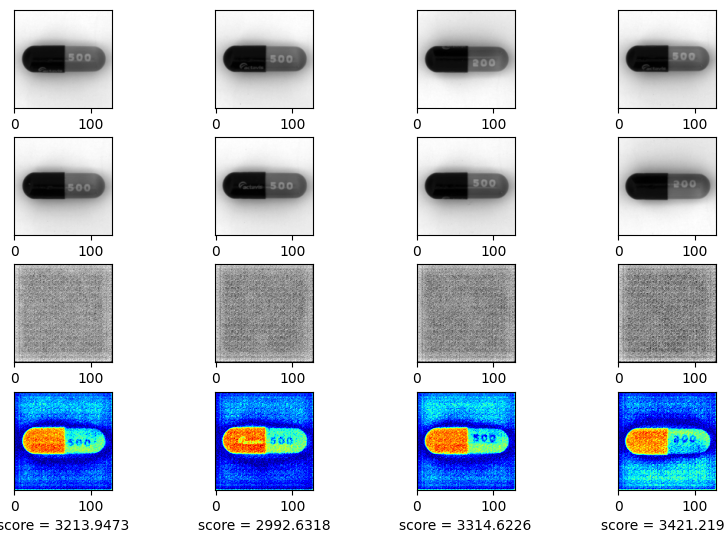

EPOCH 2/110
	 partial train loss (single batch): 9.951976
	 partial train loss (single batch): 9.156108
	 partial train loss (single batch): 7.465141
	 partial train loss (single batch): 7.159901
	 partial train loss (single batch): 5.986448
	 partial train loss (single batch): 5.303215
	 partial train loss (single batch): 7.345263
	 partial train loss (single batch): 4.089457
	 partial train loss (single batch): 5.376661
	 partial train loss (single batch): 4.029286
	 partial train loss (single batch): 5.610371
	 partial train loss (single batch): 3.531013
	 partial train loss (single batch): 3.369785
	 partial train loss (single batch): 3.038121
	 partial train loss (single batch): 2.905433
	 partial train loss (single batch): 3.224999
	 partial train loss (single batch): 3.785248
	 partial train loss (single batch): 3.378551
	 partial train loss (single batch): 2.407091
	 partial train loss (single batch): 2.007521
	 partial train loss (single batch): 4.636060
	 partial train loss (

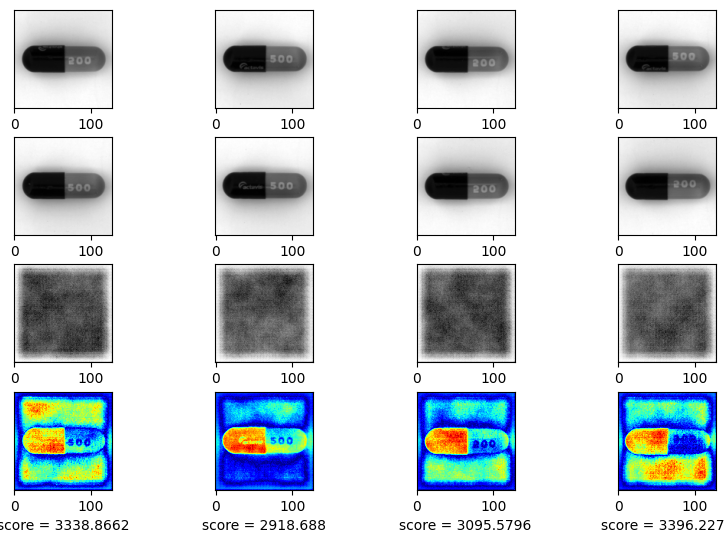

EPOCH 3/110
	 partial train loss (single batch): 2.851410
	 partial train loss (single batch): 2.196177
	 partial train loss (single batch): 2.238435
	 partial train loss (single batch): 2.928037
	 partial train loss (single batch): 1.878528
	 partial train loss (single batch): 1.651673
	 partial train loss (single batch): 2.381880
	 partial train loss (single batch): 1.396531
	 partial train loss (single batch): 1.797300
	 partial train loss (single batch): 1.923166
	 partial train loss (single batch): 1.509219
	 partial train loss (single batch): 1.673927
	 partial train loss (single batch): 1.074743
	 partial train loss (single batch): 1.344124
	 partial train loss (single batch): 1.208283
	 partial train loss (single batch): 2.009117
	 partial train loss (single batch): 1.377657
	 partial train loss (single batch): 1.168610
	 partial train loss (single batch): 1.198979
	 partial train loss (single batch): 1.191492
	 partial train loss (single batch): 0.903283
	 partial train loss (

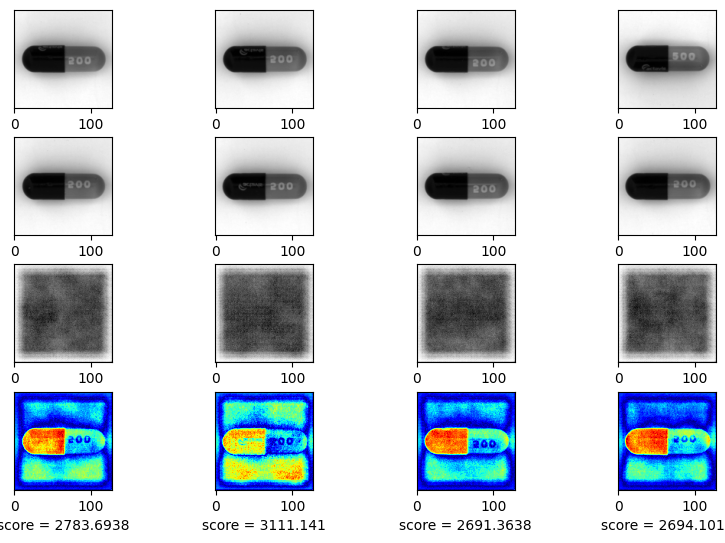

EPOCH 4/110
	 partial train loss (single batch): 1.264483
	 partial train loss (single batch): 0.819847
	 partial train loss (single batch): 1.223703
	 partial train loss (single batch): 1.330264
	 partial train loss (single batch): 0.638017
	 partial train loss (single batch): 0.760757
	 partial train loss (single batch): 0.715657
	 partial train loss (single batch): 0.855284
	 partial train loss (single batch): 0.647034
	 partial train loss (single batch): 0.824002
	 partial train loss (single batch): 0.610003
	 partial train loss (single batch): 0.589058
	 partial train loss (single batch): 0.904066
	 partial train loss (single batch): 0.967222
	 partial train loss (single batch): 0.646877
	 partial train loss (single batch): 0.888259
	 partial train loss (single batch): 1.036299
	 partial train loss (single batch): 1.035175
	 partial train loss (single batch): 0.774075
	 partial train loss (single batch): 0.463365
	 partial train loss (single batch): 0.556467
	 partial train loss (

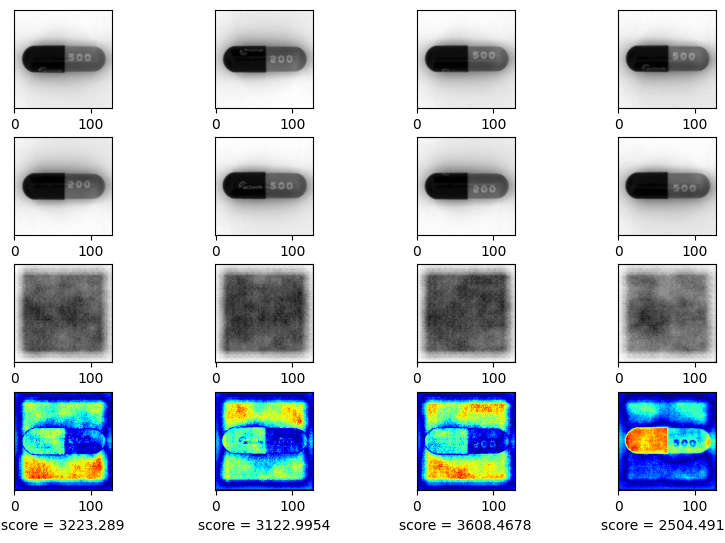

EPOCH 5/110
	 partial train loss (single batch): 0.661764
	 partial train loss (single batch): 0.439860
	 partial train loss (single batch): 1.006452
	 partial train loss (single batch): 0.541164
	 partial train loss (single batch): 0.867005
	 partial train loss (single batch): 0.621493
	 partial train loss (single batch): 0.848651
	 partial train loss (single batch): 0.640019
	 partial train loss (single batch): 0.446912
	 partial train loss (single batch): 0.641029
	 partial train loss (single batch): 0.590845
	 partial train loss (single batch): 0.446850
	 partial train loss (single batch): 0.486911
	 partial train loss (single batch): 0.486501
	 partial train loss (single batch): 0.359959
	 partial train loss (single batch): 0.351020
	 partial train loss (single batch): 0.407340
	 partial train loss (single batch): 0.295688
	 partial train loss (single batch): 0.418177
	 partial train loss (single batch): 0.321701
	 partial train loss (single batch): 0.295299
	 partial train loss (

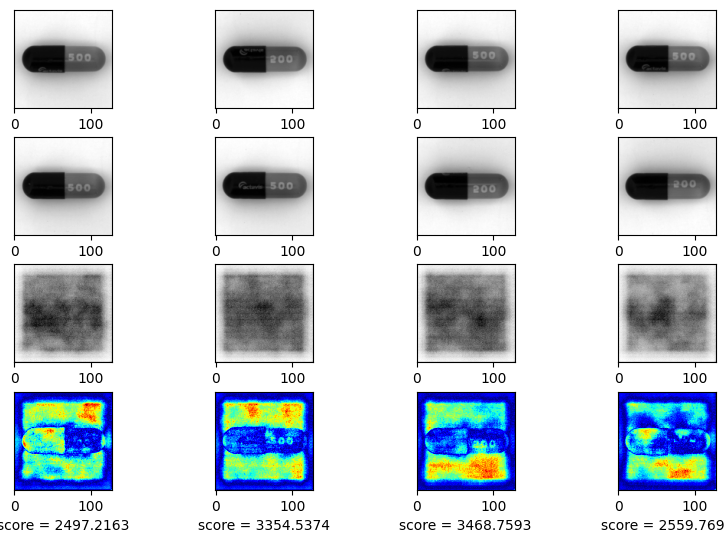

EPOCH 6/110
	 partial train loss (single batch): 0.464587
	 partial train loss (single batch): 0.375513
	 partial train loss (single batch): 0.512779
	 partial train loss (single batch): 0.266067
	 partial train loss (single batch): 0.285531
	 partial train loss (single batch): 0.307794
	 partial train loss (single batch): 0.300712
	 partial train loss (single batch): 0.215209
	 partial train loss (single batch): 0.351167
	 partial train loss (single batch): 0.274621
	 partial train loss (single batch): 0.285636
	 partial train loss (single batch): 0.438109
	 partial train loss (single batch): 0.335285
	 partial train loss (single batch): 0.257896
	 partial train loss (single batch): 0.279171
	 partial train loss (single batch): 0.327047
	 partial train loss (single batch): 0.255649
	 partial train loss (single batch): 0.289747
	 partial train loss (single batch): 0.205047
	 partial train loss (single batch): 0.339477
	 partial train loss (single batch): 0.195889
	 partial train loss (

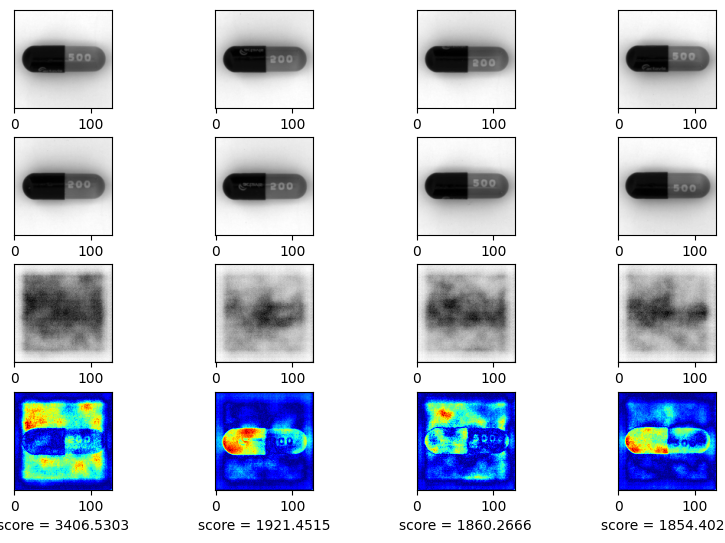

EPOCH 7/110
	 partial train loss (single batch): 0.243892
	 partial train loss (single batch): 0.182224
	 partial train loss (single batch): 0.429606
	 partial train loss (single batch): 0.197017
	 partial train loss (single batch): 0.350560
	 partial train loss (single batch): 0.201496
	 partial train loss (single batch): 0.203695
	 partial train loss (single batch): 0.276391
	 partial train loss (single batch): 0.171754
	 partial train loss (single batch): 0.222296
	 partial train loss (single batch): 0.451452
	 partial train loss (single batch): 0.362217
	 partial train loss (single batch): 0.197415
	 partial train loss (single batch): 0.308521
	 partial train loss (single batch): 0.183803
	 partial train loss (single batch): 0.300150
	 partial train loss (single batch): 0.302139
	 partial train loss (single batch): 0.286074
	 partial train loss (single batch): 0.260472
	 partial train loss (single batch): 0.205475
	 partial train loss (single batch): 0.185844
	 partial train loss (

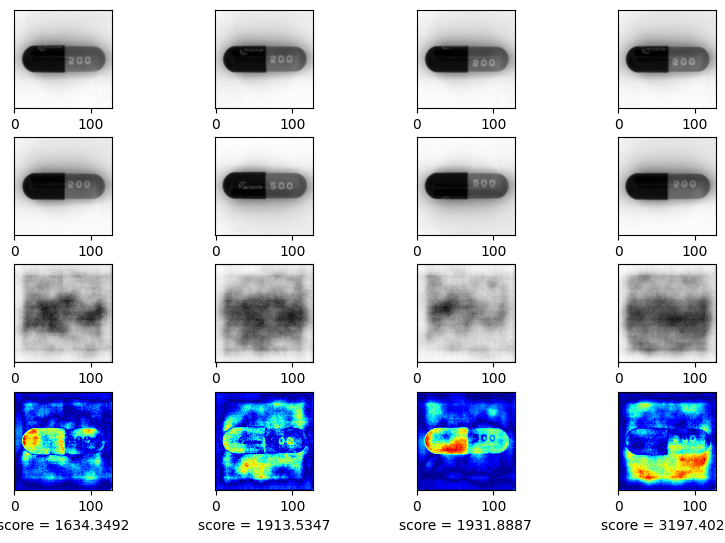

EPOCH 8/110
	 partial train loss (single batch): 0.234235
	 partial train loss (single batch): 0.268246
	 partial train loss (single batch): 0.300905
	 partial train loss (single batch): 0.211186
	 partial train loss (single batch): 0.347962
	 partial train loss (single batch): 0.254818
	 partial train loss (single batch): 0.270912
	 partial train loss (single batch): 0.230922
	 partial train loss (single batch): 0.184097
	 partial train loss (single batch): 0.215030
	 partial train loss (single batch): 0.285501
	 partial train loss (single batch): 0.315119
	 partial train loss (single batch): 1.051069
	 partial train loss (single batch): 0.420058
	 partial train loss (single batch): 0.507188
	 partial train loss (single batch): 0.270468
	 partial train loss (single batch): 0.447979
	 partial train loss (single batch): 0.288658
	 partial train loss (single batch): 0.326702
	 partial train loss (single batch): 0.252652
	 partial train loss (single batch): 0.242303
	 partial train loss (

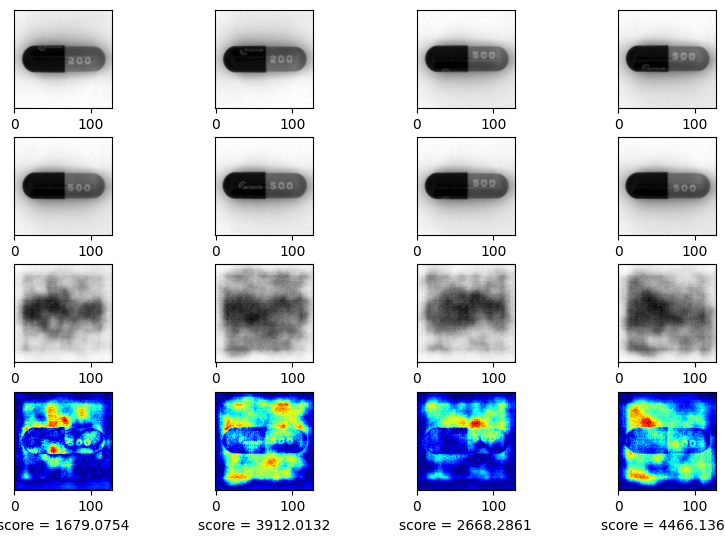

EPOCH 9/110
	 partial train loss (single batch): 0.231286
	 partial train loss (single batch): 0.383510
	 partial train loss (single batch): 0.288449
	 partial train loss (single batch): 0.373639
	 partial train loss (single batch): 0.327614
	 partial train loss (single batch): 0.508457
	 partial train loss (single batch): 0.334212
	 partial train loss (single batch): 0.324699
	 partial train loss (single batch): 0.406289
	 partial train loss (single batch): 0.503987
	 partial train loss (single batch): 0.286822
	 partial train loss (single batch): 0.283816
	 partial train loss (single batch): 0.236515
	 partial train loss (single batch): 0.379619
	 partial train loss (single batch): 0.406020
	 partial train loss (single batch): 0.609788
	 partial train loss (single batch): 0.333858
	 partial train loss (single batch): 0.226661
	 partial train loss (single batch): 0.300922
	 partial train loss (single batch): 0.341411
	 partial train loss (single batch): 0.225093
	 partial train loss (

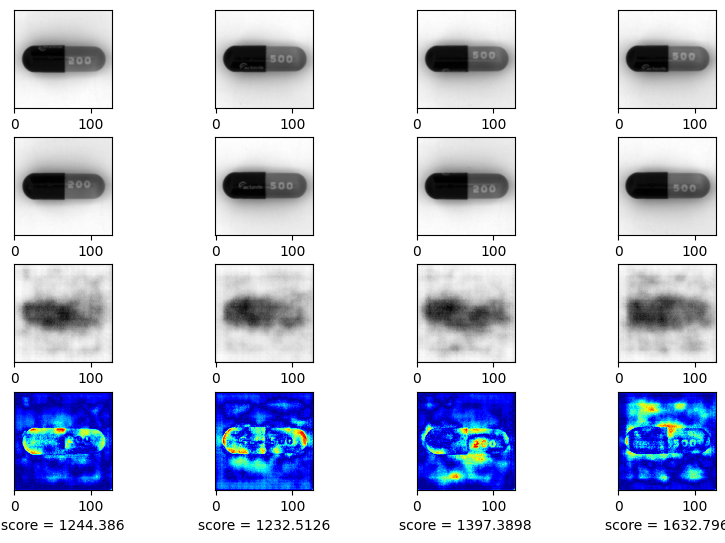

EPOCH 10/110
	 partial train loss (single batch): 0.328459
	 partial train loss (single batch): 0.298536
	 partial train loss (single batch): 0.238098
	 partial train loss (single batch): 0.255928
	 partial train loss (single batch): 0.237607
	 partial train loss (single batch): 0.172528
	 partial train loss (single batch): 0.252515
	 partial train loss (single batch): 0.286856
	 partial train loss (single batch): 0.291905
	 partial train loss (single batch): 0.389610
	 partial train loss (single batch): 0.229695
	 partial train loss (single batch): 0.298182
	 partial train loss (single batch): 0.190482
	 partial train loss (single batch): 0.188133
	 partial train loss (single batch): 0.248280
	 partial train loss (single batch): 0.202392
	 partial train loss (single batch): 0.183280
	 partial train loss (single batch): 0.198741
	 partial train loss (single batch): 0.183197
	 partial train loss (single batch): 0.221911
	 partial train loss (single batch): 0.196240
	 partial train loss 

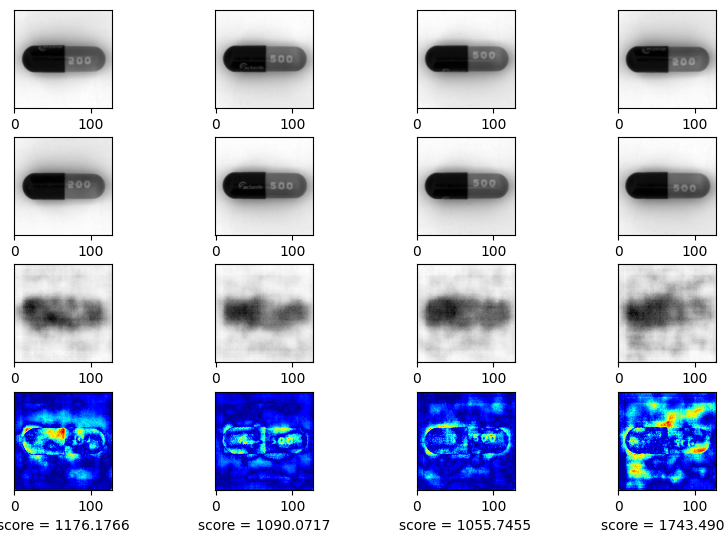

EPOCH 11/110
	 partial train loss (single batch): 0.207093
	 partial train loss (single batch): 0.207780
	 partial train loss (single batch): 0.140075
	 partial train loss (single batch): 0.183269
	 partial train loss (single batch): 0.170370
	 partial train loss (single batch): 0.203220
	 partial train loss (single batch): 0.170243
	 partial train loss (single batch): 0.193745
	 partial train loss (single batch): 0.184026
	 partial train loss (single batch): 0.389036
	 partial train loss (single batch): 0.767060
	 partial train loss (single batch): 0.285928
	 partial train loss (single batch): 0.336111
	 partial train loss (single batch): 0.286762
	 partial train loss (single batch): 0.434017
	 partial train loss (single batch): 0.248109
	 partial train loss (single batch): 0.351298
	 partial train loss (single batch): 0.205243
	 partial train loss (single batch): 0.176818
	 partial train loss (single batch): 0.202723
	 partial train loss (single batch): 0.189482
	 partial train loss 

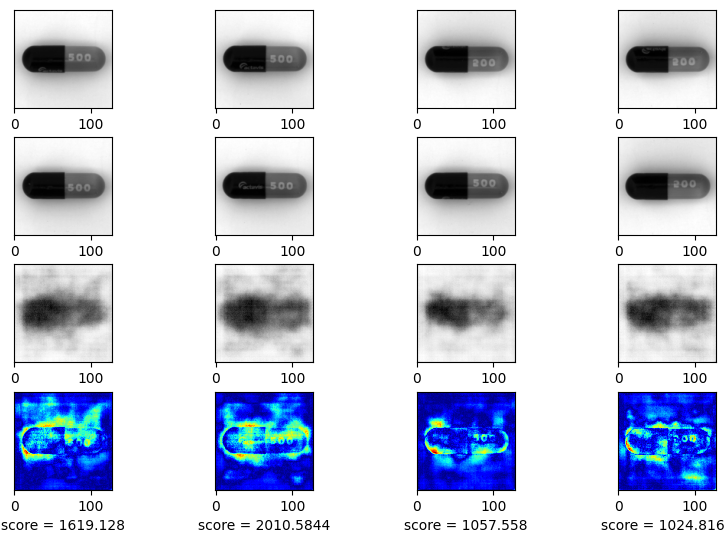

EPOCH 12/110
	 partial train loss (single batch): 0.337113
	 partial train loss (single batch): 0.242542
	 partial train loss (single batch): 0.282934
	 partial train loss (single batch): 0.186680
	 partial train loss (single batch): 0.240198
	 partial train loss (single batch): 0.171500
	 partial train loss (single batch): 0.209314
	 partial train loss (single batch): 0.349666
	 partial train loss (single batch): 0.240484
	 partial train loss (single batch): 0.252820
	 partial train loss (single batch): 0.179579
	 partial train loss (single batch): 0.203073
	 partial train loss (single batch): 0.240215
	 partial train loss (single batch): 0.209288
	 partial train loss (single batch): 0.181501
	 partial train loss (single batch): 0.184852
	 partial train loss (single batch): 0.155040
	 partial train loss (single batch): 0.160485
	 partial train loss (single batch): 0.183798
	 partial train loss (single batch): 0.135950
	 partial train loss (single batch): 0.219821
	 partial train loss 

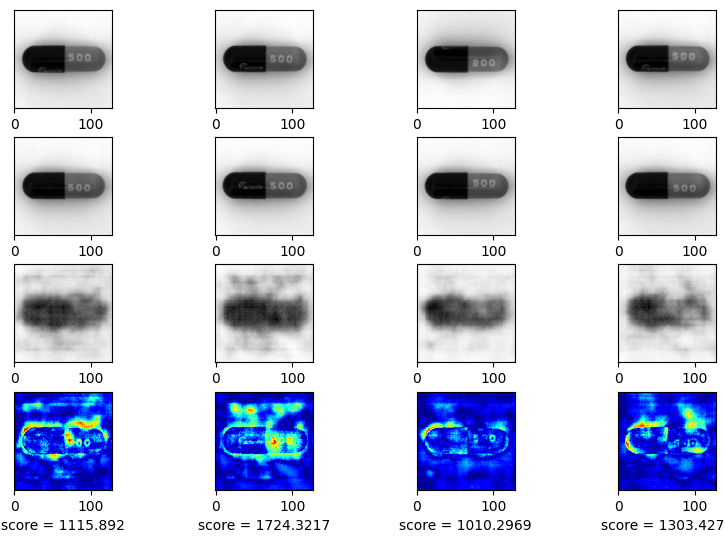

EPOCH 13/110
	 partial train loss (single batch): 0.207028
	 partial train loss (single batch): 0.143896
	 partial train loss (single batch): 0.255379
	 partial train loss (single batch): 0.145971
	 partial train loss (single batch): 13.078509
	 partial train loss (single batch): 0.948475
	 partial train loss (single batch): 0.874322
	 partial train loss (single batch): 2.716823
	 partial train loss (single batch): 2.524281
	 partial train loss (single batch): 0.839233
	 partial train loss (single batch): 3.159946
	 partial train loss (single batch): 1.988282
	 partial train loss (single batch): 4.271239
	 partial train loss (single batch): 2.185138
	 partial train loss (single batch): 0.851831
	 partial train loss (single batch): 1.708853
	 partial train loss (single batch): 2.101056
	 partial train loss (single batch): 1.163505
	 partial train loss (single batch): 3.175434
	 partial train loss (single batch): 2.432166
	 partial train loss (single batch): 1.274631
	 partial train loss

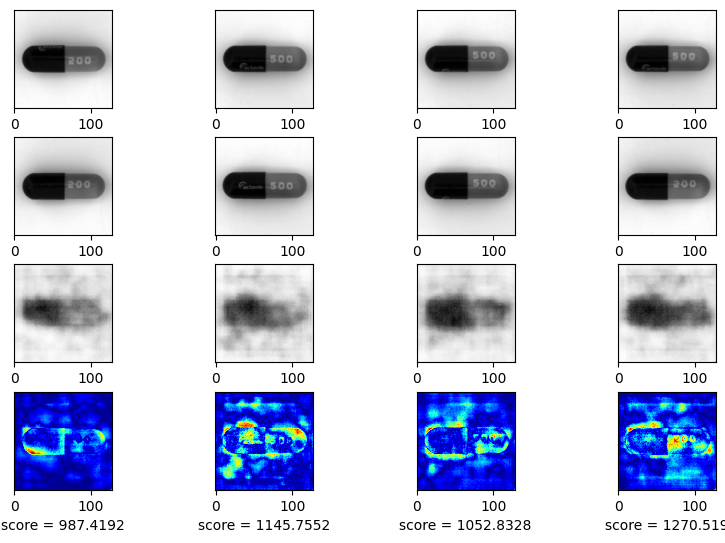

EPOCH 14/110
	 partial train loss (single batch): 1.486291
	 partial train loss (single batch): 0.909573
	 partial train loss (single batch): 1.696982
	 partial train loss (single batch): 0.816198
	 partial train loss (single batch): 1.764668
	 partial train loss (single batch): 0.639735
	 partial train loss (single batch): 0.797300
	 partial train loss (single batch): 0.586887
	 partial train loss (single batch): 0.718892
	 partial train loss (single batch): 0.914758
	 partial train loss (single batch): 0.985091
	 partial train loss (single batch): 0.712150
	 partial train loss (single batch): 0.616613
	 partial train loss (single batch): 0.640260
	 partial train loss (single batch): 0.487209
	 partial train loss (single batch): 0.488657
	 partial train loss (single batch): 0.634053
	 partial train loss (single batch): 0.694707
	 partial train loss (single batch): 0.443085
	 partial train loss (single batch): 0.440949
	 partial train loss (single batch): 0.399642
	 partial train loss 

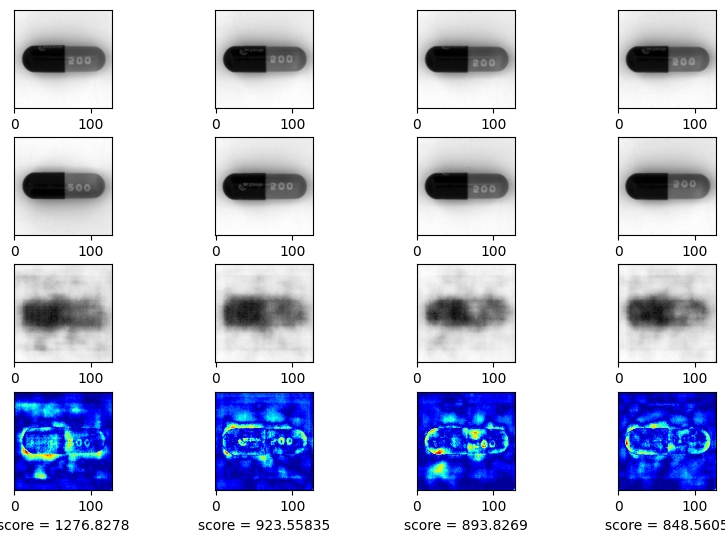

EPOCH 15/110
	 partial train loss (single batch): 0.471550
	 partial train loss (single batch): 0.359871
	 partial train loss (single batch): 0.518850
	 partial train loss (single batch): 0.471837
	 partial train loss (single batch): 0.864751
	 partial train loss (single batch): 0.725328
	 partial train loss (single batch): 0.486743
	 partial train loss (single batch): 0.473612
	 partial train loss (single batch): 0.564062
	 partial train loss (single batch): 0.331385
	 partial train loss (single batch): 0.961785
	 partial train loss (single batch): 0.499754
	 partial train loss (single batch): 0.365705
	 partial train loss (single batch): 0.397951
	 partial train loss (single batch): 0.442847
	 partial train loss (single batch): 0.373869
	 partial train loss (single batch): 0.338097
	 partial train loss (single batch): 0.239444
	 partial train loss (single batch): 0.372444
	 partial train loss (single batch): 0.315873
	 partial train loss (single batch): 0.255314
	 partial train loss 

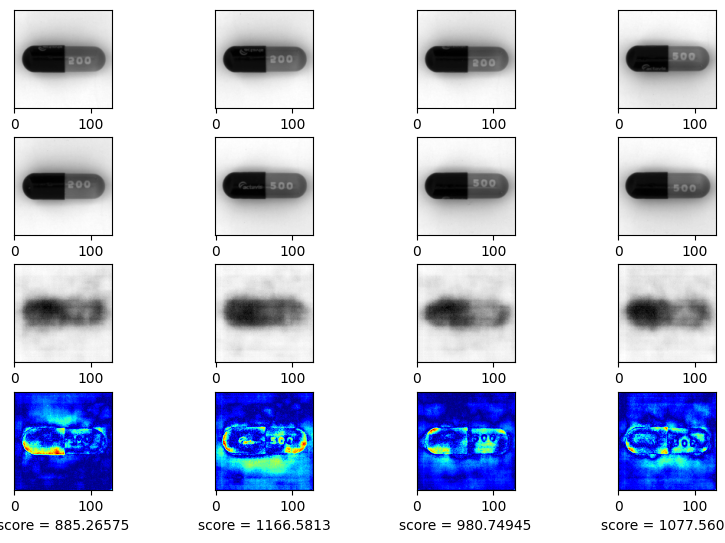

EPOCH 16/110
	 partial train loss (single batch): 0.280772
	 partial train loss (single batch): 0.262690
	 partial train loss (single batch): 0.309341
	 partial train loss (single batch): 0.203577
	 partial train loss (single batch): 0.192886
	 partial train loss (single batch): 0.321384
	 partial train loss (single batch): 0.262434
	 partial train loss (single batch): 0.371239
	 partial train loss (single batch): 0.208375
	 partial train loss (single batch): 0.371382
	 partial train loss (single batch): 0.182686
	 partial train loss (single batch): 0.153057
	 partial train loss (single batch): 0.300310
	 partial train loss (single batch): 0.183488
	 partial train loss (single batch): 0.245725
	 partial train loss (single batch): 0.284047
	 partial train loss (single batch): 0.250969
	 partial train loss (single batch): 0.135537
	 partial train loss (single batch): 0.169445
	 partial train loss (single batch): 0.215875
	 partial train loss (single batch): 0.157760
	 partial train loss 

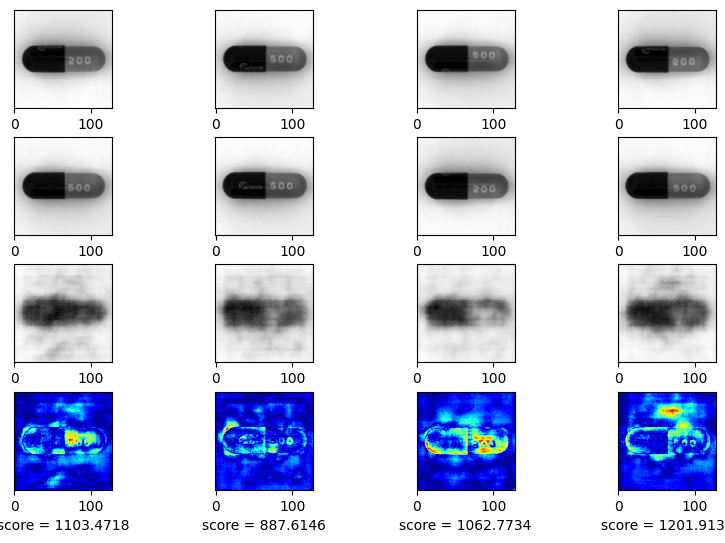

EPOCH 17/110
	 partial train loss (single batch): 0.170295
	 partial train loss (single batch): 0.215495
	 partial train loss (single batch): 0.156679
	 partial train loss (single batch): 0.167296
	 partial train loss (single batch): 0.170328
	 partial train loss (single batch): 0.159883
	 partial train loss (single batch): 0.113152
	 partial train loss (single batch): 0.316460
	 partial train loss (single batch): 0.172220
	 partial train loss (single batch): 0.222771
	 partial train loss (single batch): 0.191116
	 partial train loss (single batch): 0.176296
	 partial train loss (single batch): 0.153455
	 partial train loss (single batch): 0.243411
	 partial train loss (single batch): 0.194770
	 partial train loss (single batch): 0.287723
	 partial train loss (single batch): 0.204413
	 partial train loss (single batch): 0.194537
	 partial train loss (single batch): 0.141009
	 partial train loss (single batch): 0.190435
	 partial train loss (single batch): 0.187301
	 partial train loss 

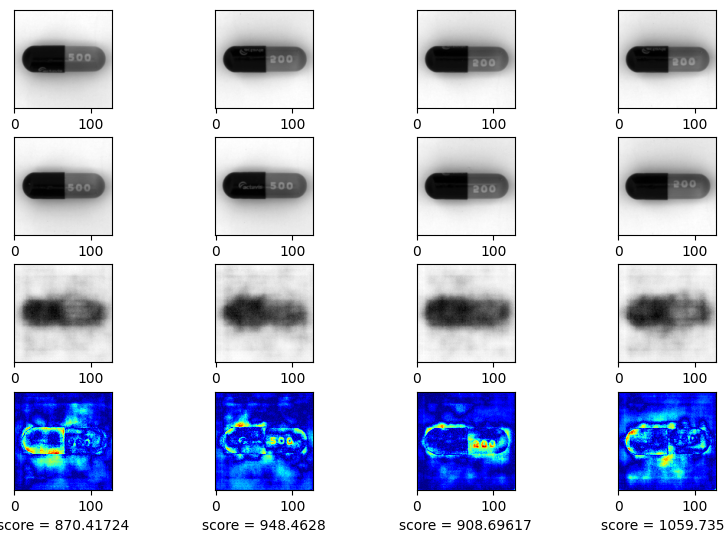

EPOCH 18/110
	 partial train loss (single batch): 0.158222
	 partial train loss (single batch): 0.131664
	 partial train loss (single batch): 0.098058
	 partial train loss (single batch): 0.120578
	 partial train loss (single batch): 0.204339
	 partial train loss (single batch): 0.177616
	 partial train loss (single batch): 0.179926
	 partial train loss (single batch): 0.143797
	 partial train loss (single batch): 0.141980
	 partial train loss (single batch): 0.126970
	 partial train loss (single batch): 0.169447
	 partial train loss (single batch): 0.137376
	 partial train loss (single batch): 0.138334
	 partial train loss (single batch): 0.118230
	 partial train loss (single batch): 0.106759
	 partial train loss (single batch): 0.081666
	 partial train loss (single batch): 0.172096
	 partial train loss (single batch): 0.205570
	 partial train loss (single batch): 0.113379
	 partial train loss (single batch): 0.124396
	 partial train loss (single batch): 0.133413
	 partial train loss 

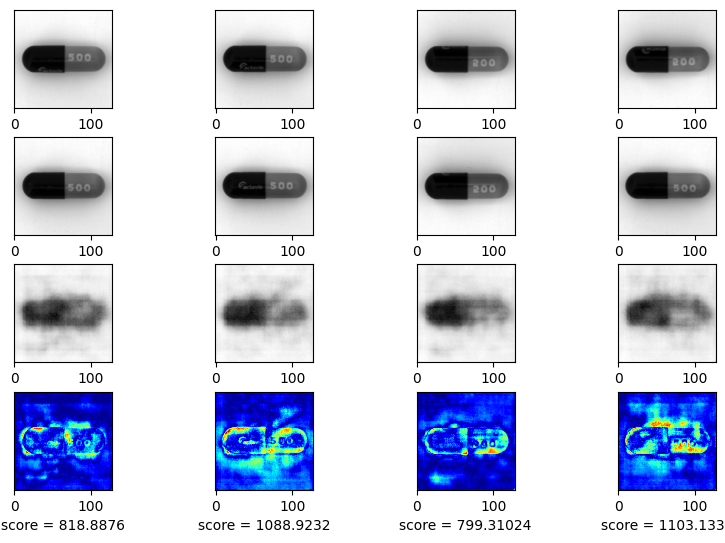

EPOCH 19/110
	 partial train loss (single batch): 0.098581
	 partial train loss (single batch): 0.101426
	 partial train loss (single batch): 0.076886
	 partial train loss (single batch): 0.075826
	 partial train loss (single batch): 0.063661
	 partial train loss (single batch): 0.094381
	 partial train loss (single batch): 0.064312
	 partial train loss (single batch): 0.093146
	 partial train loss (single batch): 0.061633
	 partial train loss (single batch): 0.070744
	 partial train loss (single batch): 0.083865
	 partial train loss (single batch): 0.114339
	 partial train loss (single batch): 0.086585
	 partial train loss (single batch): 0.129102
	 partial train loss (single batch): 0.061334
	 partial train loss (single batch): 0.068795
	 partial train loss (single batch): 0.088801
	 partial train loss (single batch): 0.078355
	 partial train loss (single batch): 0.061800
	 partial train loss (single batch): 0.099156
	 partial train loss (single batch): 0.054169
	 partial train loss 

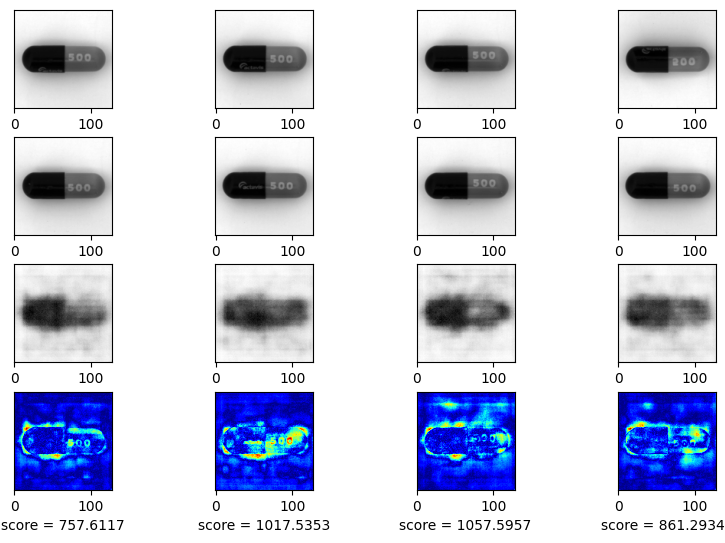

EPOCH 20/110
	 partial train loss (single batch): 0.116509
	 partial train loss (single batch): 0.060328
	 partial train loss (single batch): 0.151319
	 partial train loss (single batch): 0.130630
	 partial train loss (single batch): 0.172425
	 partial train loss (single batch): 0.092682
	 partial train loss (single batch): 0.081272
	 partial train loss (single batch): 0.075034
	 partial train loss (single batch): 0.191899
	 partial train loss (single batch): 0.113974
	 partial train loss (single batch): 0.107282
	 partial train loss (single batch): 0.110017
	 partial train loss (single batch): 0.062396
	 partial train loss (single batch): 0.093974
	 partial train loss (single batch): 0.083415
	 partial train loss (single batch): 0.068708
	 partial train loss (single batch): 0.050613
	 partial train loss (single batch): 0.081002
	 partial train loss (single batch): 0.056417
	 partial train loss (single batch): 0.082442
	 partial train loss (single batch): 0.085505
	 partial train loss 

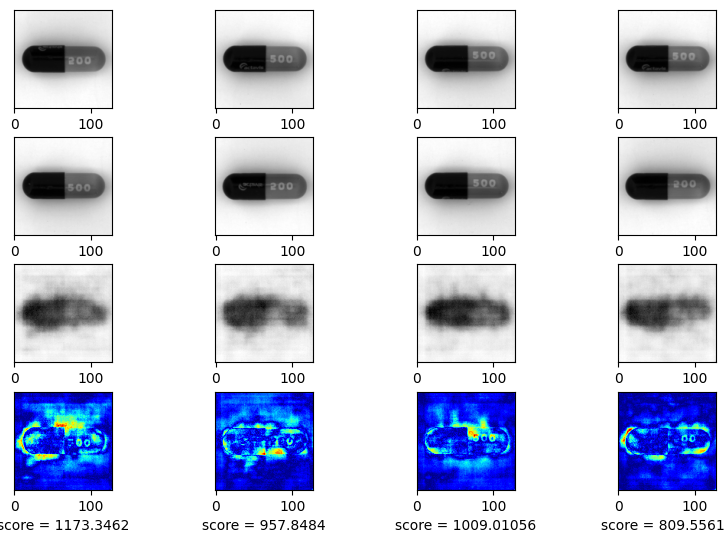

EPOCH 21/110
	 partial train loss (single batch): 0.122373
	 partial train loss (single batch): 0.125526
	 partial train loss (single batch): 0.065306
	 partial train loss (single batch): 0.077581
	 partial train loss (single batch): 0.090638
	 partial train loss (single batch): 0.092760
	 partial train loss (single batch): 0.102255
	 partial train loss (single batch): 0.123814
	 partial train loss (single batch): 0.101884
	 partial train loss (single batch): 0.078067
	 partial train loss (single batch): 0.106437
	 partial train loss (single batch): 0.082287
	 partial train loss (single batch): 0.079593
	 partial train loss (single batch): 24.042931
	 partial train loss (single batch): 0.755731
	 partial train loss (single batch): 5.862386
	 partial train loss (single batch): 2.595330
	 partial train loss (single batch): 4.010234
	 partial train loss (single batch): 4.945391
	 partial train loss (single batch): 9.089800
	 partial train loss (single batch): 4.267636
	 partial train loss

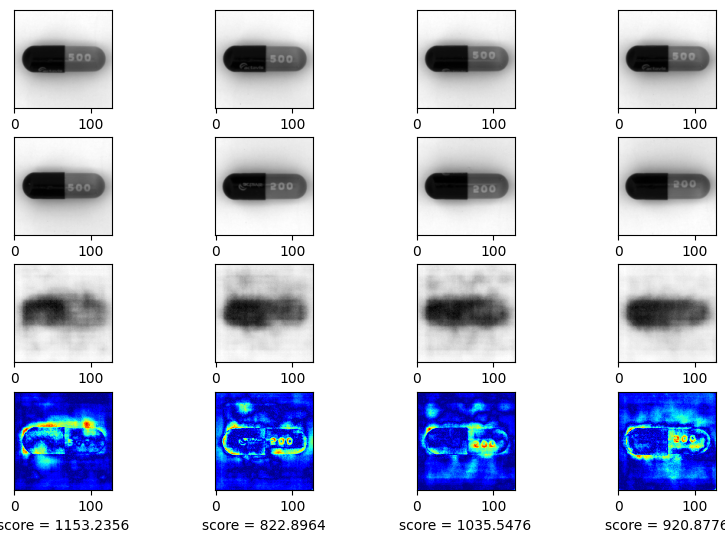

EPOCH 22/110
	 partial train loss (single batch): 1.755098
	 partial train loss (single batch): 2.380046
	 partial train loss (single batch): 1.440240
	 partial train loss (single batch): 2.595649
	 partial train loss (single batch): 2.912402
	 partial train loss (single batch): 2.764146
	 partial train loss (single batch): 1.518356
	 partial train loss (single batch): 2.076717
	 partial train loss (single batch): 0.893542
	 partial train loss (single batch): 1.241015
	 partial train loss (single batch): 1.144085
	 partial train loss (single batch): 7.557055
	 partial train loss (single batch): 1.263640
	 partial train loss (single batch): 1.761465
	 partial train loss (single batch): 1.178615
	 partial train loss (single batch): 1.436041
	 partial train loss (single batch): 1.431711
	 partial train loss (single batch): 0.801234
	 partial train loss (single batch): 0.742856
	 partial train loss (single batch): 1.471119
	 partial train loss (single batch): 1.674015
	 partial train loss 

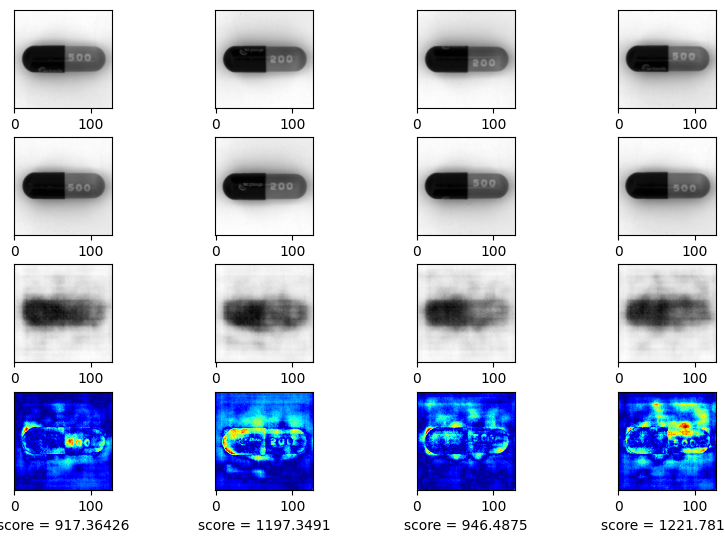

EPOCH 23/110
	 partial train loss (single batch): 1.092019
	 partial train loss (single batch): 0.805896
	 partial train loss (single batch): 0.922517
	 partial train loss (single batch): 0.398031
	 partial train loss (single batch): 0.586668
	 partial train loss (single batch): 1.064851
	 partial train loss (single batch): 0.642089
	 partial train loss (single batch): 0.688361
	 partial train loss (single batch): 0.729584
	 partial train loss (single batch): 0.410707
	 partial train loss (single batch): 0.395680
	 partial train loss (single batch): 0.703329
	 partial train loss (single batch): 0.401318
	 partial train loss (single batch): 0.636618
	 partial train loss (single batch): 0.425024
	 partial train loss (single batch): 0.336153
	 partial train loss (single batch): 0.315399
	 partial train loss (single batch): 0.411964
	 partial train loss (single batch): 0.217710
	 partial train loss (single batch): 0.402587
	 partial train loss (single batch): 0.356343
	 partial train loss 

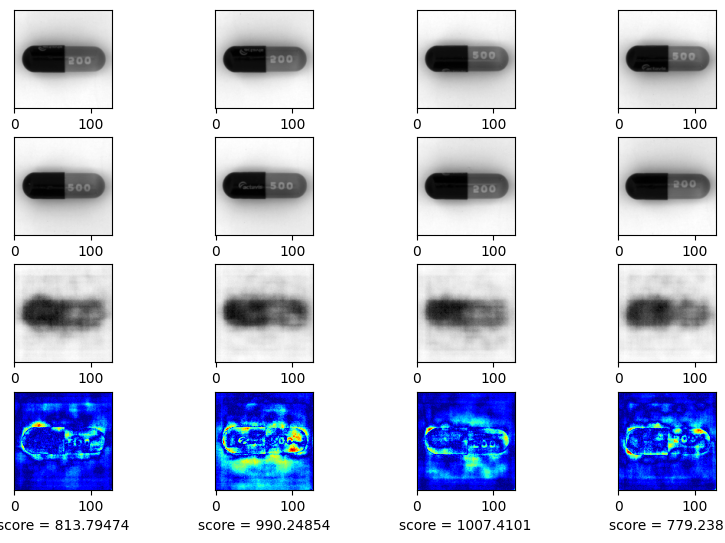

EPOCH 24/110
	 partial train loss (single batch): 0.229506
	 partial train loss (single batch): 0.245190
	 partial train loss (single batch): 0.210336
	 partial train loss (single batch): 0.193445
	 partial train loss (single batch): 0.347773
	 partial train loss (single batch): 0.444478
	 partial train loss (single batch): 0.194183
	 partial train loss (single batch): 0.235485
	 partial train loss (single batch): 0.316978
	 partial train loss (single batch): 0.255850
	 partial train loss (single batch): 0.225335
	 partial train loss (single batch): 0.221924
	 partial train loss (single batch): 0.219355
	 partial train loss (single batch): 0.176909
	 partial train loss (single batch): 0.241354
	 partial train loss (single batch): 0.253259
	 partial train loss (single batch): 0.175604
	 partial train loss (single batch): 0.264387
	 partial train loss (single batch): 0.181733
	 partial train loss (single batch): 0.146465
	 partial train loss (single batch): 0.193013
	 partial train loss 

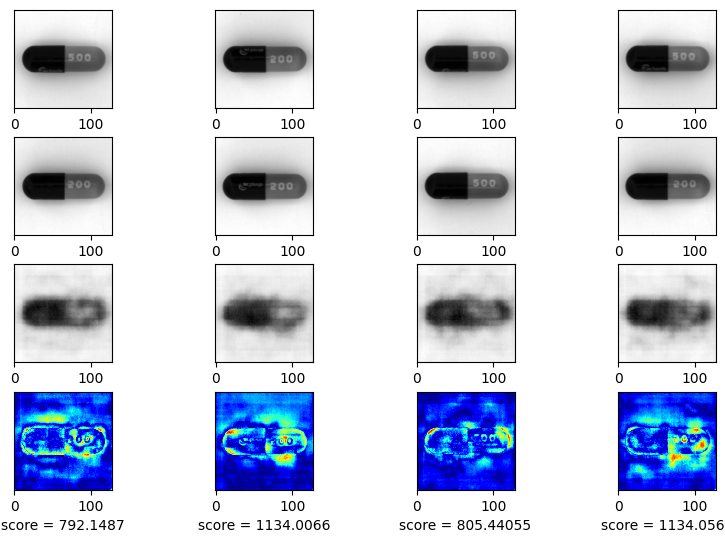

EPOCH 25/110
	 partial train loss (single batch): 0.161508
	 partial train loss (single batch): 0.147121
	 partial train loss (single batch): 0.323801
	 partial train loss (single batch): 0.573968
	 partial train loss (single batch): 0.218263
	 partial train loss (single batch): 0.218525
	 partial train loss (single batch): 0.176718
	 partial train loss (single batch): 0.448457
	 partial train loss (single batch): 0.139327
	 partial train loss (single batch): 0.146502
	 partial train loss (single batch): 0.163313
	 partial train loss (single batch): 0.160495
	 partial train loss (single batch): 0.146336
	 partial train loss (single batch): 0.147216
	 partial train loss (single batch): 0.150503
	 partial train loss (single batch): 0.150395
	 partial train loss (single batch): 0.145424
	 partial train loss (single batch): 0.169144
	 partial train loss (single batch): 0.122857
	 partial train loss (single batch): 0.132096
	 partial train loss (single batch): 0.218412
	 partial train loss 

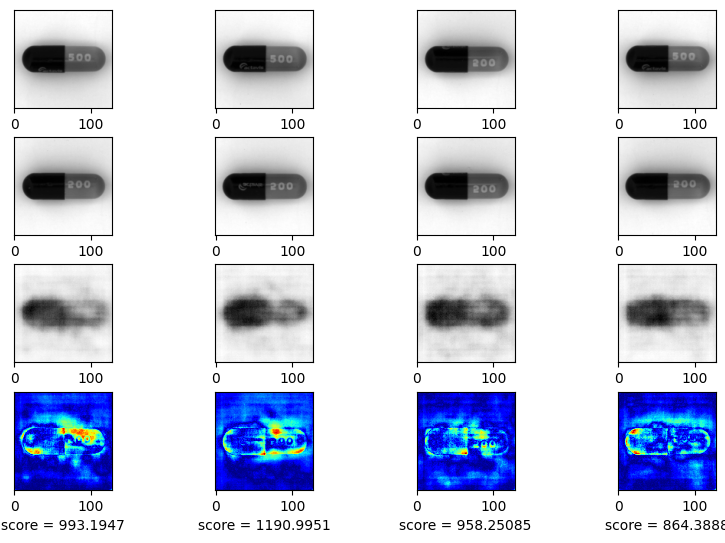

EPOCH 26/110
	 partial train loss (single batch): 0.192373
	 partial train loss (single batch): 0.141047
	 partial train loss (single batch): 0.088702
	 partial train loss (single batch): 0.112446
	 partial train loss (single batch): 0.092429
	 partial train loss (single batch): 0.093932
	 partial train loss (single batch): 0.092910
	 partial train loss (single batch): 0.075900
	 partial train loss (single batch): 0.078150
	 partial train loss (single batch): 0.083375
	 partial train loss (single batch): 0.062415
	 partial train loss (single batch): 0.060378
	 partial train loss (single batch): 0.079584
	 partial train loss (single batch): 0.067524
	 partial train loss (single batch): 0.109086
	 partial train loss (single batch): 0.177251
	 partial train loss (single batch): 0.095004
	 partial train loss (single batch): 0.074359
	 partial train loss (single batch): 0.079792
	 partial train loss (single batch): 0.043745
	 partial train loss (single batch): 0.115669
	 partial train loss 

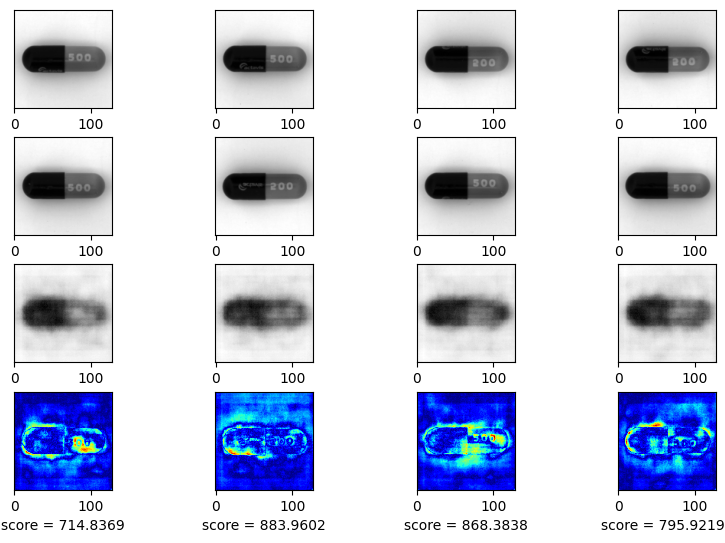

EPOCH 27/110
	 partial train loss (single batch): 0.061742
	 partial train loss (single batch): 0.050126
	 partial train loss (single batch): 0.471703
	 partial train loss (single batch): 0.079726
	 partial train loss (single batch): 0.135894
	 partial train loss (single batch): 0.120467
	 partial train loss (single batch): 0.111735
	 partial train loss (single batch): 0.091087
	 partial train loss (single batch): 0.091182
	 partial train loss (single batch): 0.146196
	 partial train loss (single batch): 0.068176
	 partial train loss (single batch): 0.099737
	 partial train loss (single batch): 0.082035
	 partial train loss (single batch): 0.072748
	 partial train loss (single batch): 0.090751
	 partial train loss (single batch): 0.037593
	 partial train loss (single batch): 0.058752
	 partial train loss (single batch): 0.115672
	 partial train loss (single batch): 0.042845
	 partial train loss (single batch): 0.062495
	 partial train loss (single batch): 0.062130
	 partial train loss 

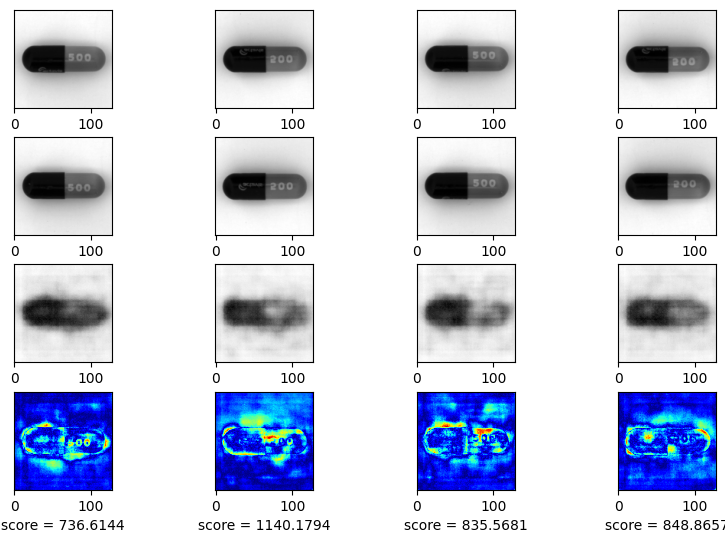

EPOCH 28/110
	 partial train loss (single batch): 0.054109
	 partial train loss (single batch): 0.139535
	 partial train loss (single batch): 0.160150
	 partial train loss (single batch): 0.082119
	 partial train loss (single batch): 0.084749
	 partial train loss (single batch): 0.144831
	 partial train loss (single batch): 0.085333
	 partial train loss (single batch): 0.075788
	 partial train loss (single batch): 0.055958
	 partial train loss (single batch): 0.077526
	 partial train loss (single batch): 0.082018
	 partial train loss (single batch): 0.061901
	 partial train loss (single batch): 0.085700
	 partial train loss (single batch): 0.056629
	 partial train loss (single batch): 0.042853
	 partial train loss (single batch): 0.101275
	 partial train loss (single batch): 0.096059
	 partial train loss (single batch): 0.057800
	 partial train loss (single batch): 0.077319
	 partial train loss (single batch): 0.038910
	 partial train loss (single batch): 0.058620
	 partial train loss 

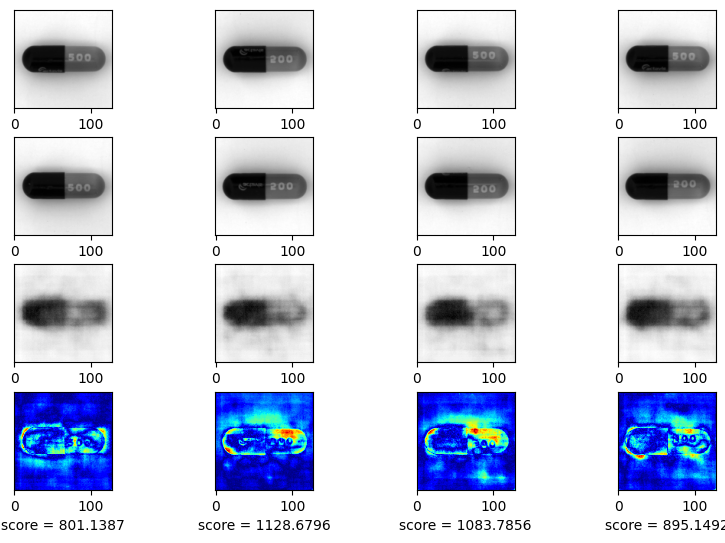

EPOCH 29/110
	 partial train loss (single batch): 0.055455
	 partial train loss (single batch): 0.039185
	 partial train loss (single batch): 0.057671
	 partial train loss (single batch): 0.041166
	 partial train loss (single batch): 0.042685
	 partial train loss (single batch): 0.050142
	 partial train loss (single batch): 0.038009
	 partial train loss (single batch): 0.236692
	 partial train loss (single batch): 0.103154
	 partial train loss (single batch): 0.095236
	 partial train loss (single batch): 0.064671
	 partial train loss (single batch): 0.096874
	 partial train loss (single batch): 0.098601
	 partial train loss (single batch): 0.065905
	 partial train loss (single batch): 0.066882
	 partial train loss (single batch): 0.096491
	 partial train loss (single batch): 0.054572
	 partial train loss (single batch): 0.060383
	 partial train loss (single batch): 0.049845
	 partial train loss (single batch): 0.063563
	 partial train loss (single batch): 0.069258
	 partial train loss 

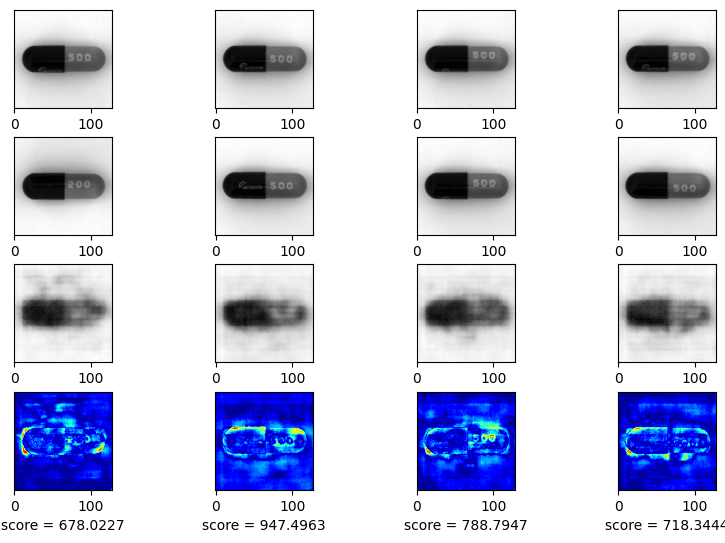

EPOCH 30/110
	 partial train loss (single batch): 0.055282
	 partial train loss (single batch): 0.040601
	 partial train loss (single batch): 0.053159
	 partial train loss (single batch): 0.045177
	 partial train loss (single batch): 0.064233
	 partial train loss (single batch): 0.037045
	 partial train loss (single batch): 0.093283
	 partial train loss (single batch): 0.041460
	 partial train loss (single batch): 0.045939
	 partial train loss (single batch): 0.076238
	 partial train loss (single batch): 0.042434
	 partial train loss (single batch): 0.049088
	 partial train loss (single batch): 0.043501
	 partial train loss (single batch): 0.053244
	 partial train loss (single batch): 0.070044
	 partial train loss (single batch): 0.041023
	 partial train loss (single batch): 0.063328
	 partial train loss (single batch): 0.062014
	 partial train loss (single batch): 0.188688
	 partial train loss (single batch): 0.094484
	 partial train loss (single batch): 0.157087
	 partial train loss 

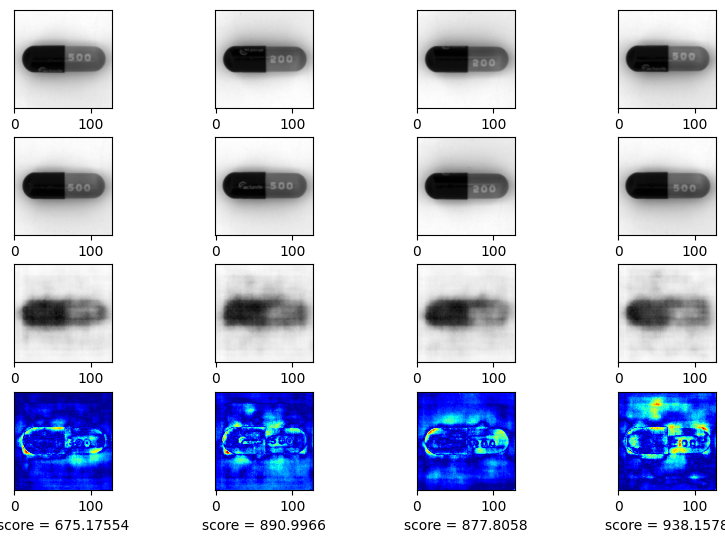

EPOCH 31/110
	 partial train loss (single batch): 0.163519
	 partial train loss (single batch): 0.071621
	 partial train loss (single batch): 0.057866
	 partial train loss (single batch): 0.071700
	 partial train loss (single batch): 0.060496
	 partial train loss (single batch): 0.090500
	 partial train loss (single batch): 0.055612
	 partial train loss (single batch): 0.111338
	 partial train loss (single batch): 0.072767
	 partial train loss (single batch): 0.101645
	 partial train loss (single batch): 0.064882
	 partial train loss (single batch): 0.080252
	 partial train loss (single batch): 0.065301
	 partial train loss (single batch): 0.064656
	 partial train loss (single batch): 0.112197
	 partial train loss (single batch): 0.052656
	 partial train loss (single batch): 0.080831
	 partial train loss (single batch): 0.073248
	 partial train loss (single batch): 0.083022
	 partial train loss (single batch): 0.068163
	 partial train loss (single batch): 0.061374
	 partial train loss 

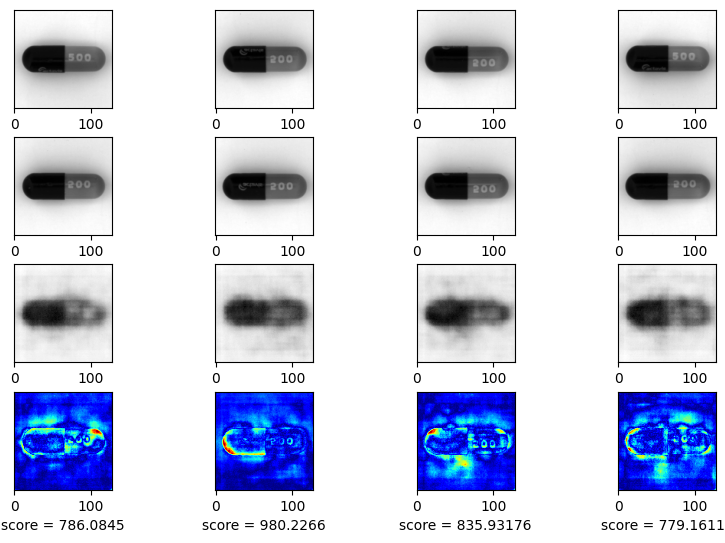

EPOCH 32/110
	 partial train loss (single batch): 0.063788
	 partial train loss (single batch): 0.063096
	 partial train loss (single batch): 0.077373
	 partial train loss (single batch): 0.052283
	 partial train loss (single batch): 0.100509
	 partial train loss (single batch): 0.064236
	 partial train loss (single batch): 0.048209
	 partial train loss (single batch): 0.039811
	 partial train loss (single batch): 0.046735
	 partial train loss (single batch): 0.046048
	 partial train loss (single batch): 0.053191
	 partial train loss (single batch): 0.118455
	 partial train loss (single batch): 0.048776
	 partial train loss (single batch): 0.098064
	 partial train loss (single batch): 0.050780
	 partial train loss (single batch): 0.047025
	 partial train loss (single batch): 0.071870
	 partial train loss (single batch): 0.055700
	 partial train loss (single batch): 0.046763
	 partial train loss (single batch): 0.049675
	 partial train loss (single batch): 0.042770
	 partial train loss 

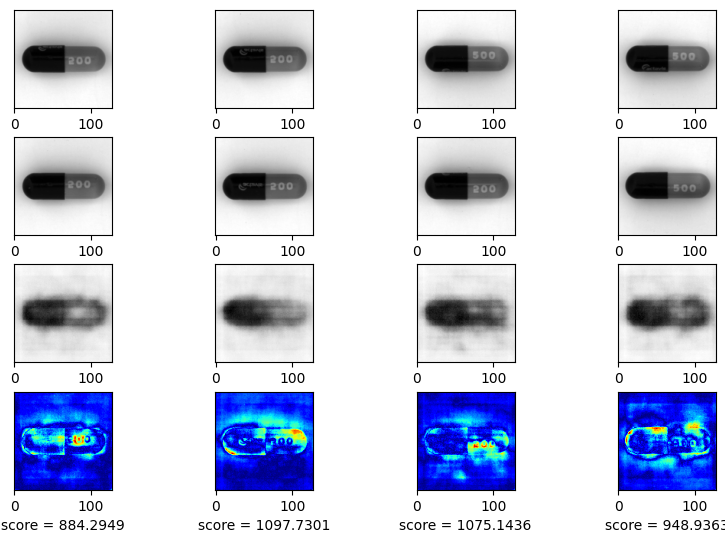

EPOCH 33/110
	 partial train loss (single batch): 0.073759
	 partial train loss (single batch): 0.061123
	 partial train loss (single batch): 0.044083
	 partial train loss (single batch): 0.039671
	 partial train loss (single batch): 0.033006
	 partial train loss (single batch): 0.077459
	 partial train loss (single batch): 0.065131
	 partial train loss (single batch): 0.043103
	 partial train loss (single batch): 0.047426
	 partial train loss (single batch): 0.029892
	 partial train loss (single batch): 0.038294
	 partial train loss (single batch): 0.051663
	 partial train loss (single batch): 0.076520
	 partial train loss (single batch): 0.079511
	 partial train loss (single batch): 0.038533
	 partial train loss (single batch): 0.042900
	 partial train loss (single batch): 0.039318
	 partial train loss (single batch): 0.060193
	 partial train loss (single batch): 0.053511
	 partial train loss (single batch): 0.081299
	 partial train loss (single batch): 0.093785
	 partial train loss 

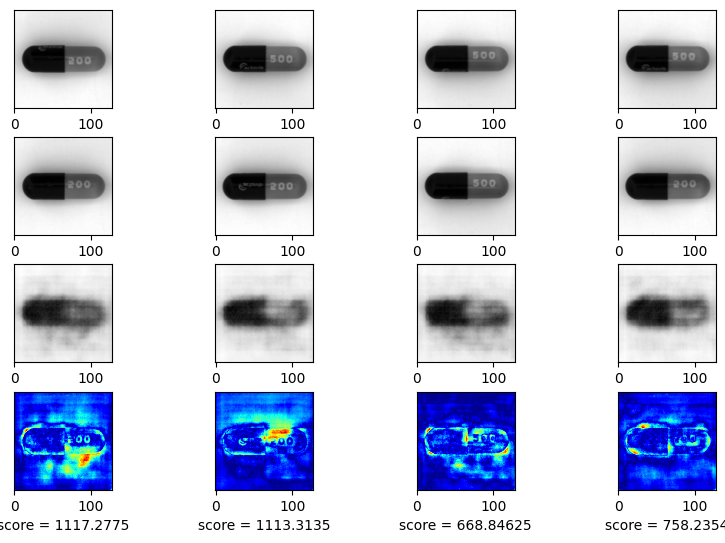

EPOCH 34/110
	 partial train loss (single batch): 0.053737
	 partial train loss (single batch): 0.097833
	 partial train loss (single batch): 0.070802
	 partial train loss (single batch): 0.059984
	 partial train loss (single batch): 0.060585
	 partial train loss (single batch): 0.060564
	 partial train loss (single batch): 0.060474
	 partial train loss (single batch): 0.055662
	 partial train loss (single batch): 0.048936
	 partial train loss (single batch): 0.036062
	 partial train loss (single batch): 0.065448
	 partial train loss (single batch): 0.037666
	 partial train loss (single batch): 0.045623
	 partial train loss (single batch): 0.042501
	 partial train loss (single batch): 0.049258
	 partial train loss (single batch): 0.057733
	 partial train loss (single batch): 0.066020
	 partial train loss (single batch): 0.043165
	 partial train loss (single batch): 0.037320
	 partial train loss (single batch): 0.067925
	 partial train loss (single batch): 0.034163
	 partial train loss 

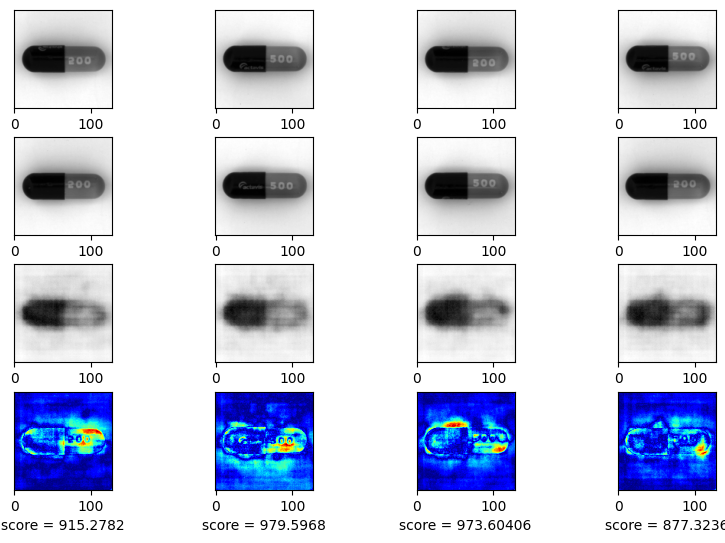

EPOCH 35/110
	 partial train loss (single batch): 0.043374
	 partial train loss (single batch): 0.048968
	 partial train loss (single batch): 0.030616
	 partial train loss (single batch): 0.032706
	 partial train loss (single batch): 0.033231
	 partial train loss (single batch): 0.031604
	 partial train loss (single batch): 0.038926
	 partial train loss (single batch): 0.188122
	 partial train loss (single batch): 0.061689
	 partial train loss (single batch): 0.070245
	 partial train loss (single batch): 0.038524
	 partial train loss (single batch): 0.068930
	 partial train loss (single batch): 0.070764
	 partial train loss (single batch): 0.069929
	 partial train loss (single batch): 0.110389
	 partial train loss (single batch): 0.064272
	 partial train loss (single batch): 0.034582
	 partial train loss (single batch): 0.078489
	 partial train loss (single batch): 0.052047
	 partial train loss (single batch): 0.050786
	 partial train loss (single batch): 0.039443
	 partial train loss 

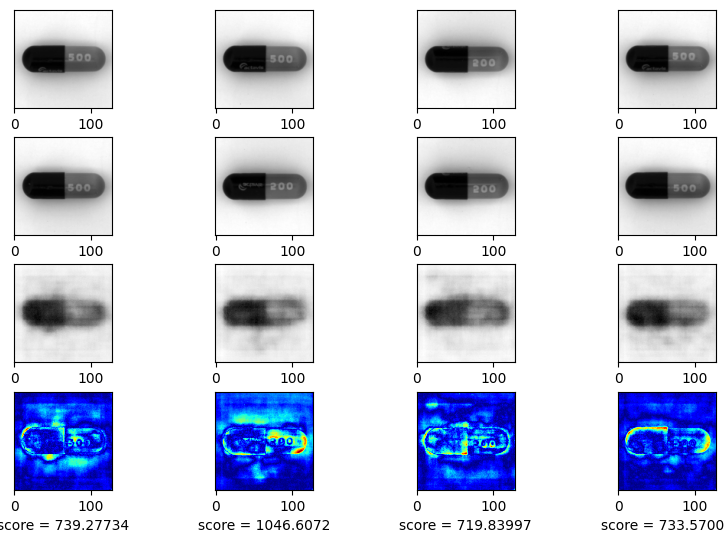

EPOCH 36/110
	 partial train loss (single batch): 0.037889
	 partial train loss (single batch): 0.034417
	 partial train loss (single batch): 0.091737
	 partial train loss (single batch): 0.084653
	 partial train loss (single batch): 0.069966
	 partial train loss (single batch): 0.092101
	 partial train loss (single batch): 0.042122
	 partial train loss (single batch): 0.080955
	 partial train loss (single batch): 0.036794
	 partial train loss (single batch): 0.098168
	 partial train loss (single batch): 0.095312
	 partial train loss (single batch): 0.055212
	 partial train loss (single batch): 0.041364
	 partial train loss (single batch): 0.041311
	 partial train loss (single batch): 0.076606
	 partial train loss (single batch): 0.078308
	 partial train loss (single batch): 0.045292
	 partial train loss (single batch): 0.075525
	 partial train loss (single batch): 0.080087
	 partial train loss (single batch): 0.065004
	 partial train loss (single batch): 0.053085
	 partial train loss 

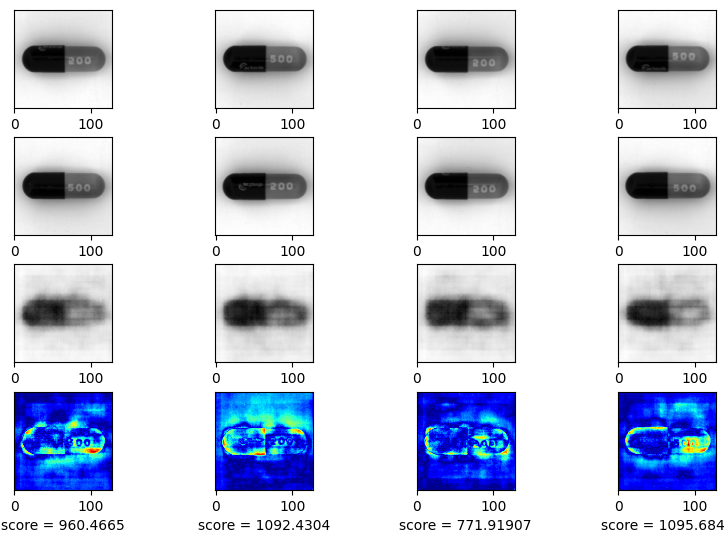

EPOCH 37/110
	 partial train loss (single batch): 0.039397
	 partial train loss (single batch): 0.041328
	 partial train loss (single batch): 0.044302
	 partial train loss (single batch): 0.030438
	 partial train loss (single batch): 0.024641
	 partial train loss (single batch): 0.066086
	 partial train loss (single batch): 0.040025
	 partial train loss (single batch): 0.029651
	 partial train loss (single batch): 0.033775
	 partial train loss (single batch): 0.059912
	 partial train loss (single batch): 0.059386
	 partial train loss (single batch): 0.041436
	 partial train loss (single batch): 0.070764
	 partial train loss (single batch): 0.051381
	 partial train loss (single batch): 0.044067
	 partial train loss (single batch): 0.041036
	 partial train loss (single batch): 0.055921
	 partial train loss (single batch): 0.136977
	 partial train loss (single batch): 0.074100
	 partial train loss (single batch): 0.078147
	 partial train loss (single batch): 0.049191
	 partial train loss 

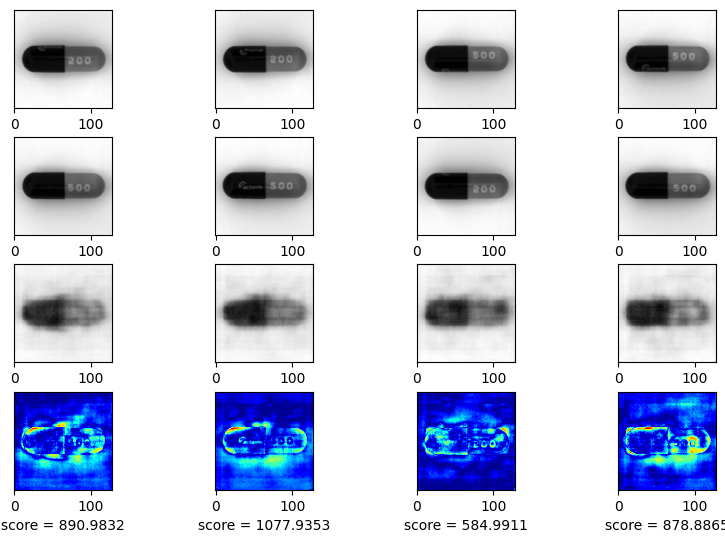

EPOCH 38/110
	 partial train loss (single batch): 0.104583
	 partial train loss (single batch): 0.051158
	 partial train loss (single batch): 0.082511
	 partial train loss (single batch): 0.130891
	 partial train loss (single batch): 0.060195
	 partial train loss (single batch): 0.079913
	 partial train loss (single batch): 0.059839
	 partial train loss (single batch): 0.053707
	 partial train loss (single batch): 0.053195
	 partial train loss (single batch): 0.078018
	 partial train loss (single batch): 0.045175
	 partial train loss (single batch): 0.056396
	 partial train loss (single batch): 0.076684
	 partial train loss (single batch): 0.067650
	 partial train loss (single batch): 0.057845
	 partial train loss (single batch): 0.052820
	 partial train loss (single batch): 0.038624
	 partial train loss (single batch): 0.040681
	 partial train loss (single batch): 0.054172
	 partial train loss (single batch): 0.039607
	 partial train loss (single batch): 0.059067
	 partial train loss 

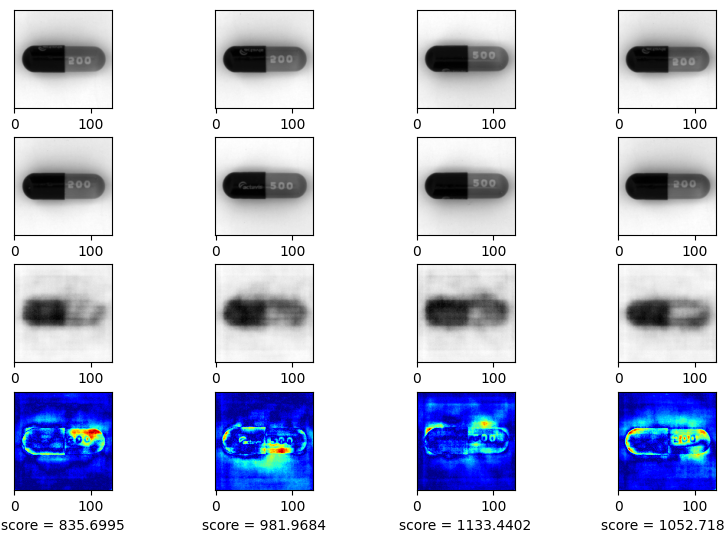

EPOCH 39/110
	 partial train loss (single batch): 0.043799
	 partial train loss (single batch): 0.044370
	 partial train loss (single batch): 0.028296
	 partial train loss (single batch): 0.035954
	 partial train loss (single batch): 0.031720
	 partial train loss (single batch): 0.046418
	 partial train loss (single batch): 0.057921
	 partial train loss (single batch): 0.039869
	 partial train loss (single batch): 0.025701
	 partial train loss (single batch): 0.043535
	 partial train loss (single batch): 0.026443
	 partial train loss (single batch): 0.019035
	 partial train loss (single batch): 0.018631
	 partial train loss (single batch): 0.020939
	 partial train loss (single batch): 0.361207
	 partial train loss (single batch): 0.133276
	 partial train loss (single batch): 0.229646
	 partial train loss (single batch): 0.118783
	 partial train loss (single batch): 0.241938
	 partial train loss (single batch): 0.201088
	 partial train loss (single batch): 0.199012
	 partial train loss 

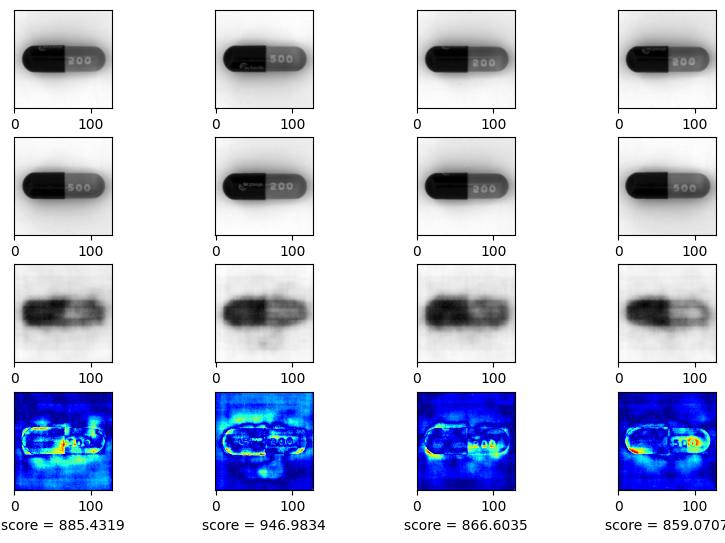

EPOCH 40/110
	 partial train loss (single batch): 0.107614
	 partial train loss (single batch): 0.116283
	 partial train loss (single batch): 0.097766
	 partial train loss (single batch): 0.105297
	 partial train loss (single batch): 0.091520
	 partial train loss (single batch): 0.060811
	 partial train loss (single batch): 0.100719
	 partial train loss (single batch): 0.468839
	 partial train loss (single batch): 0.163123
	 partial train loss (single batch): 0.157739
	 partial train loss (single batch): 0.157340
	 partial train loss (single batch): 0.254703
	 partial train loss (single batch): 0.133091
	 partial train loss (single batch): 0.252917
	 partial train loss (single batch): 0.257964
	 partial train loss (single batch): 0.112655
	 partial train loss (single batch): 0.137553
	 partial train loss (single batch): 0.079461
	 partial train loss (single batch): 0.091631
	 partial train loss (single batch): 0.121737
	 partial train loss (single batch): 0.079074
	 partial train loss 

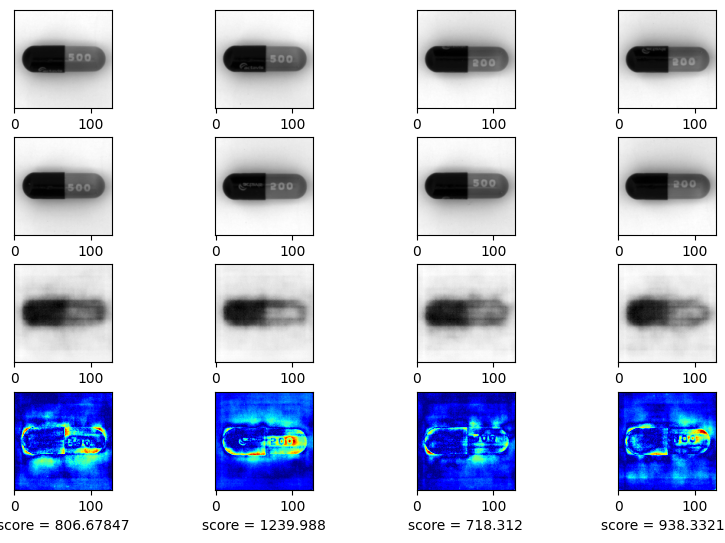

EPOCH 41/110
	 partial train loss (single batch): 0.148751
	 partial train loss (single batch): 0.065683
	 partial train loss (single batch): 0.066365
	 partial train loss (single batch): 0.056948
	 partial train loss (single batch): 0.073400
	 partial train loss (single batch): 0.057105
	 partial train loss (single batch): 0.046957
	 partial train loss (single batch): 0.069005
	 partial train loss (single batch): 0.083560
	 partial train loss (single batch): 0.068112
	 partial train loss (single batch): 0.082154
	 partial train loss (single batch): 0.090819
	 partial train loss (single batch): 0.105548
	 partial train loss (single batch): 0.059796
	 partial train loss (single batch): 0.030290
	 partial train loss (single batch): 0.049448
	 partial train loss (single batch): 0.082584
	 partial train loss (single batch): 0.054987
	 partial train loss (single batch): 0.075292
	 partial train loss (single batch): 0.053915
	 partial train loss (single batch): 0.051952
	 partial train loss 

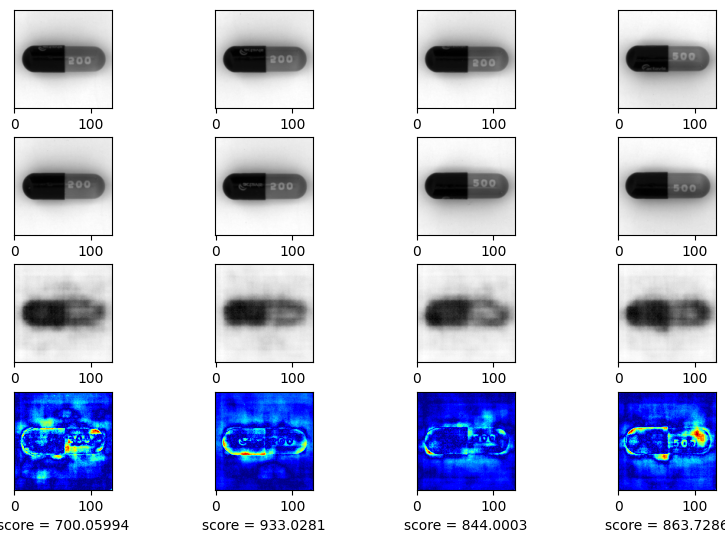

EPOCH 42/110
	 partial train loss (single batch): 0.052918
	 partial train loss (single batch): 0.047951
	 partial train loss (single batch): 0.048022
	 partial train loss (single batch): 0.029659
	 partial train loss (single batch): 0.042030
	 partial train loss (single batch): 0.055341
	 partial train loss (single batch): 0.041969
	 partial train loss (single batch): 0.039706
	 partial train loss (single batch): 0.028195
	 partial train loss (single batch): 0.033369
	 partial train loss (single batch): 0.039447
	 partial train loss (single batch): 0.040733
	 partial train loss (single batch): 0.036080
	 partial train loss (single batch): 0.026594
	 partial train loss (single batch): 0.032626
	 partial train loss (single batch): 0.024892
	 partial train loss (single batch): 0.050256
	 partial train loss (single batch): 0.035934
	 partial train loss (single batch): 0.045300
	 partial train loss (single batch): 0.036021
	 partial train loss (single batch): 0.063673
	 partial train loss 

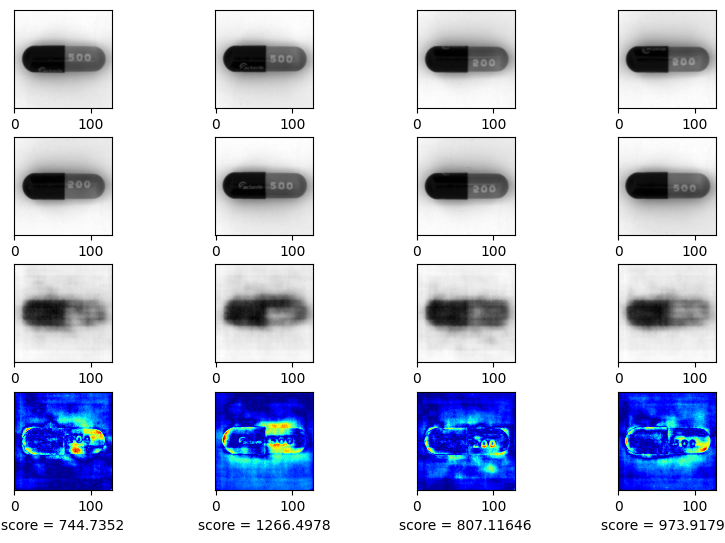

EPOCH 43/110
	 partial train loss (single batch): 0.032977
	 partial train loss (single batch): 0.034744
	 partial train loss (single batch): 0.017764
	 partial train loss (single batch): 0.058251
	 partial train loss (single batch): 0.036947
	 partial train loss (single batch): 0.026325
	 partial train loss (single batch): 0.031777
	 partial train loss (single batch): 0.026614
	 partial train loss (single batch): 0.021762
	 partial train loss (single batch): 0.021399
	 partial train loss (single batch): 0.030494
	 partial train loss (single batch): 0.029595
	 partial train loss (single batch): 0.027445
	 partial train loss (single batch): 0.029742
	 partial train loss (single batch): 0.023838
	 partial train loss (single batch): 0.017026
	 partial train loss (single batch): 0.026891
	 partial train loss (single batch): 0.030707
	 partial train loss (single batch): 0.037450
	 partial train loss (single batch): 0.022566
	 partial train loss (single batch): 0.038075
	 partial train loss 

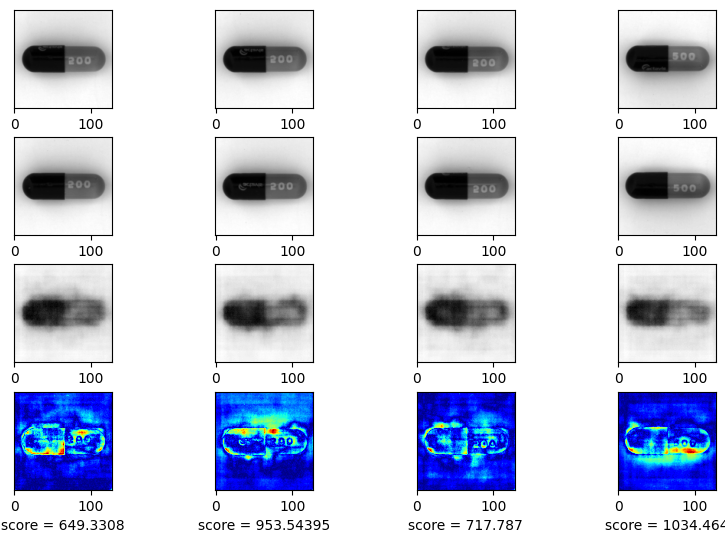

EPOCH 44/110
	 partial train loss (single batch): 0.020826
	 partial train loss (single batch): 0.031967
	 partial train loss (single batch): 0.022552
	 partial train loss (single batch): 0.019874
	 partial train loss (single batch): 0.042335
	 partial train loss (single batch): 0.029241
	 partial train loss (single batch): 0.026533
	 partial train loss (single batch): 0.017889
	 partial train loss (single batch): 0.019378
	 partial train loss (single batch): 0.032398
	 partial train loss (single batch): 0.018944
	 partial train loss (single batch): 0.093233
	 partial train loss (single batch): 0.025293
	 partial train loss (single batch): 0.029212
	 partial train loss (single batch): 0.020558
	 partial train loss (single batch): 0.037953
	 partial train loss (single batch): 0.022744
	 partial train loss (single batch): 0.053903
	 partial train loss (single batch): 0.016648
	 partial train loss (single batch): 0.031606
	 partial train loss (single batch): 0.027971
	 partial train loss 

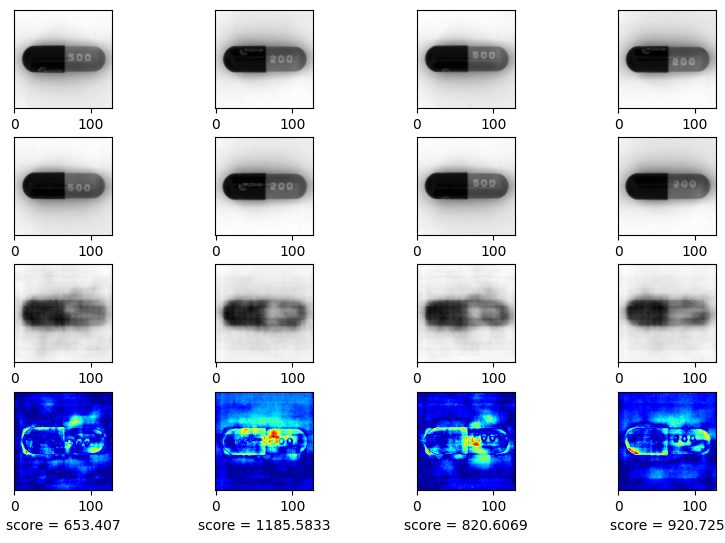

EPOCH 45/110
	 partial train loss (single batch): 0.020957
	 partial train loss (single batch): 0.024743
	 partial train loss (single batch): 0.018044
	 partial train loss (single batch): 0.018983
	 partial train loss (single batch): 0.048849
	 partial train loss (single batch): 0.018255
	 partial train loss (single batch): 0.019614
	 partial train loss (single batch): 0.014764
	 partial train loss (single batch): 0.021819
	 partial train loss (single batch): 0.026921
	 partial train loss (single batch): 0.017700
	 partial train loss (single batch): 0.019701
	 partial train loss (single batch): 0.013808
	 partial train loss (single batch): 0.028474
	 partial train loss (single batch): 0.049580
	 partial train loss (single batch): 0.033328
	 partial train loss (single batch): 0.021848
	 partial train loss (single batch): 0.028270
	 partial train loss (single batch): 0.033165
	 partial train loss (single batch): 0.022613
	 partial train loss (single batch): 0.026988
	 partial train loss 

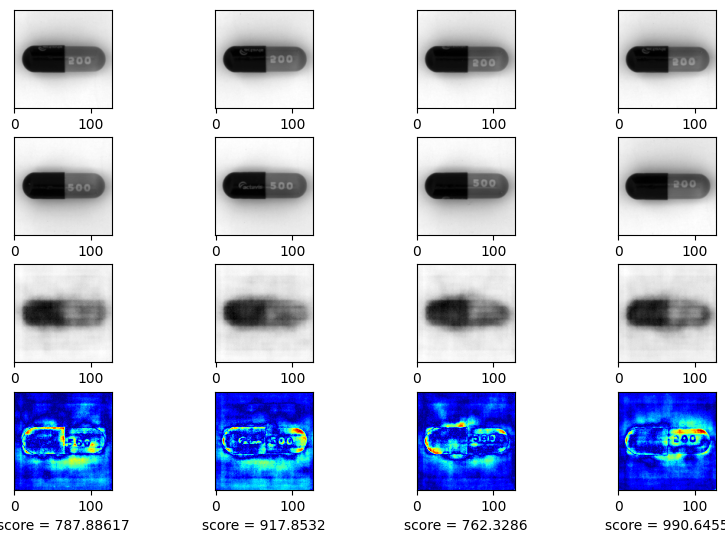

EPOCH 46/110
	 partial train loss (single batch): 0.035652
	 partial train loss (single batch): 0.028939
	 partial train loss (single batch): 0.021018
	 partial train loss (single batch): 0.029427
	 partial train loss (single batch): 0.015057
	 partial train loss (single batch): 0.016802
	 partial train loss (single batch): 0.019364
	 partial train loss (single batch): 0.016568
	 partial train loss (single batch): 0.021346
	 partial train loss (single batch): 0.021747
	 partial train loss (single batch): 0.020412
	 partial train loss (single batch): 0.029128
	 partial train loss (single batch): 0.020071
	 partial train loss (single batch): 0.021329
	 partial train loss (single batch): 0.015716
	 partial train loss (single batch): 0.026623
	 partial train loss (single batch): 0.021737
	 partial train loss (single batch): 0.037328
	 partial train loss (single batch): 0.022706
	 partial train loss (single batch): 0.032227
	 partial train loss (single batch): 0.017653
	 partial train loss 

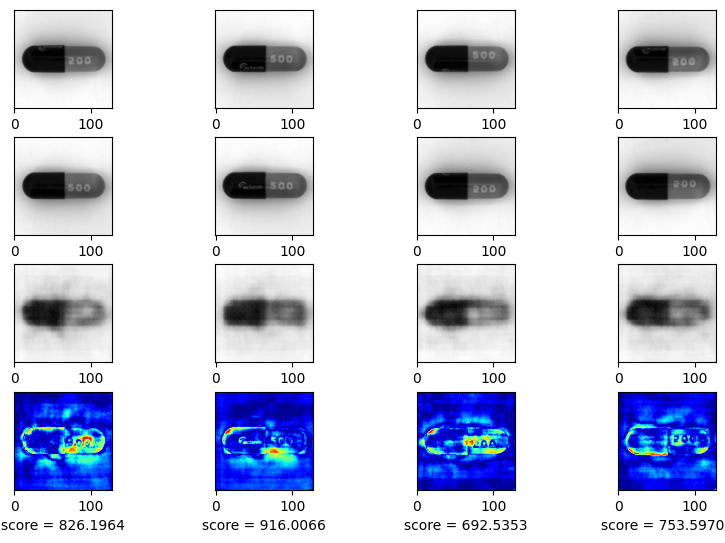

EPOCH 47/110
	 partial train loss (single batch): 0.026335
	 partial train loss (single batch): 0.026658
	 partial train loss (single batch): 0.025931
	 partial train loss (single batch): 0.016131
	 partial train loss (single batch): 0.021020
	 partial train loss (single batch): 0.039620
	 partial train loss (single batch): 0.022156
	 partial train loss (single batch): 0.027350
	 partial train loss (single batch): 0.031766
	 partial train loss (single batch): 0.031431
	 partial train loss (single batch): 0.019264
	 partial train loss (single batch): 0.037220
	 partial train loss (single batch): 0.026372
	 partial train loss (single batch): 0.023561
	 partial train loss (single batch): 0.020471
	 partial train loss (single batch): 0.016531
	 partial train loss (single batch): 0.020872
	 partial train loss (single batch): 0.017989
	 partial train loss (single batch): 0.088876
	 partial train loss (single batch): 0.032960
	 partial train loss (single batch): 0.026845
	 partial train loss 

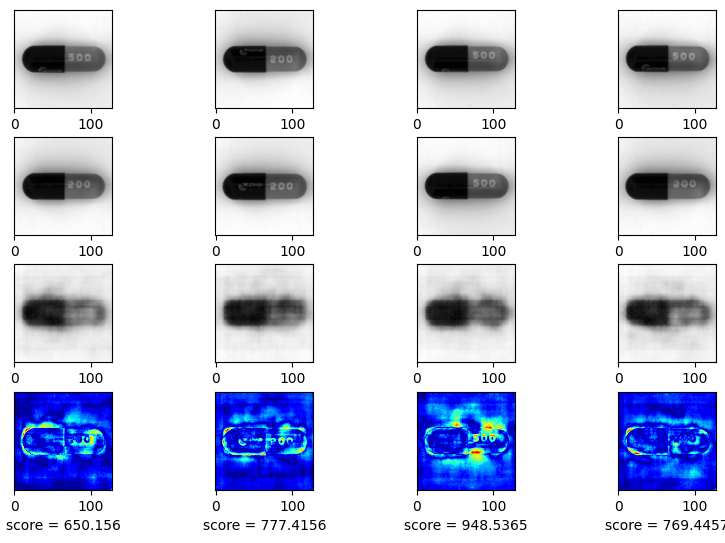

EPOCH 48/110
	 partial train loss (single batch): 0.036882
	 partial train loss (single batch): 0.038569
	 partial train loss (single batch): 0.033709
	 partial train loss (single batch): 0.018922
	 partial train loss (single batch): 0.024849
	 partial train loss (single batch): 0.028592
	 partial train loss (single batch): 0.019700
	 partial train loss (single batch): 0.016989
	 partial train loss (single batch): 0.014523
	 partial train loss (single batch): 0.019841
	 partial train loss (single batch): 0.022558
	 partial train loss (single batch): 0.039200
	 partial train loss (single batch): 0.022349
	 partial train loss (single batch): 0.040972
	 partial train loss (single batch): 0.051300
	 partial train loss (single batch): 0.038981
	 partial train loss (single batch): 0.048103
	 partial train loss (single batch): 0.035109
	 partial train loss (single batch): 0.043778
	 partial train loss (single batch): 0.030104
	 partial train loss (single batch): 0.055007
	 partial train loss 

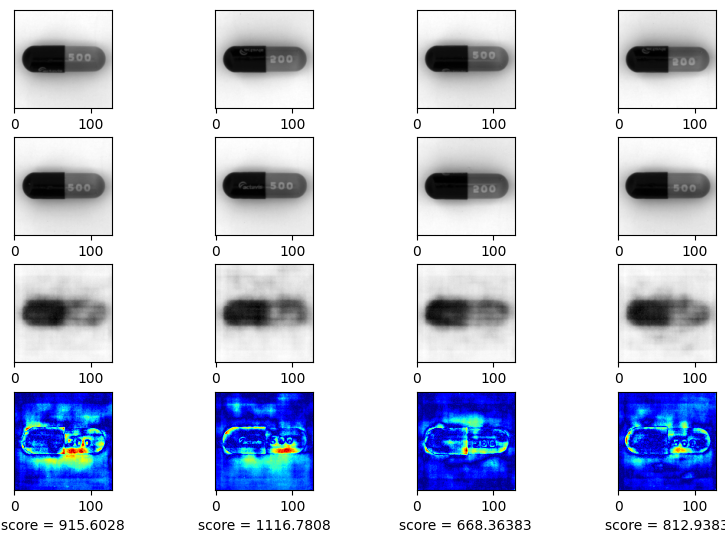

EPOCH 49/110
	 partial train loss (single batch): 0.031837
	 partial train loss (single batch): 0.036594
	 partial train loss (single batch): 0.040068
	 partial train loss (single batch): 0.025466
	 partial train loss (single batch): 0.035999
	 partial train loss (single batch): 0.049275
	 partial train loss (single batch): 0.034220
	 partial train loss (single batch): 0.045027
	 partial train loss (single batch): 0.034678
	 partial train loss (single batch): 0.061318
	 partial train loss (single batch): 0.034245
	 partial train loss (single batch): 0.046477
	 partial train loss (single batch): 0.059973
	 partial train loss (single batch): 0.056956
	 partial train loss (single batch): 0.037300
	 partial train loss (single batch): 0.038045
	 partial train loss (single batch): 0.077941
	 partial train loss (single batch): 0.030636
	 partial train loss (single batch): 0.044883
	 partial train loss (single batch): 0.038731
	 partial train loss (single batch): 0.046315
	 partial train loss 

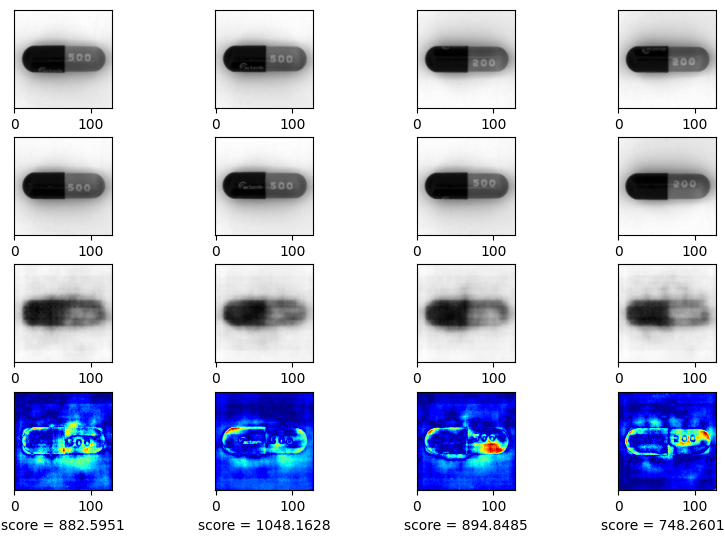

EPOCH 50/110
	 partial train loss (single batch): 0.024787
	 partial train loss (single batch): 0.035310
	 partial train loss (single batch): 0.030051
	 partial train loss (single batch): 0.019799
	 partial train loss (single batch): 0.027485
	 partial train loss (single batch): 0.047345
	 partial train loss (single batch): 0.025103
	 partial train loss (single batch): 0.045288
	 partial train loss (single batch): 0.018730
	 partial train loss (single batch): 0.023984
	 partial train loss (single batch): 0.020052
	 partial train loss (single batch): 0.020051
	 partial train loss (single batch): 0.030781
	 partial train loss (single batch): 0.024388
	 partial train loss (single batch): 0.025264
	 partial train loss (single batch): 0.016233
	 partial train loss (single batch): 0.034475
	 partial train loss (single batch): 0.027138
	 partial train loss (single batch): 0.027476
	 partial train loss (single batch): 0.020094
	 partial train loss (single batch): 0.033493
	 partial train loss 

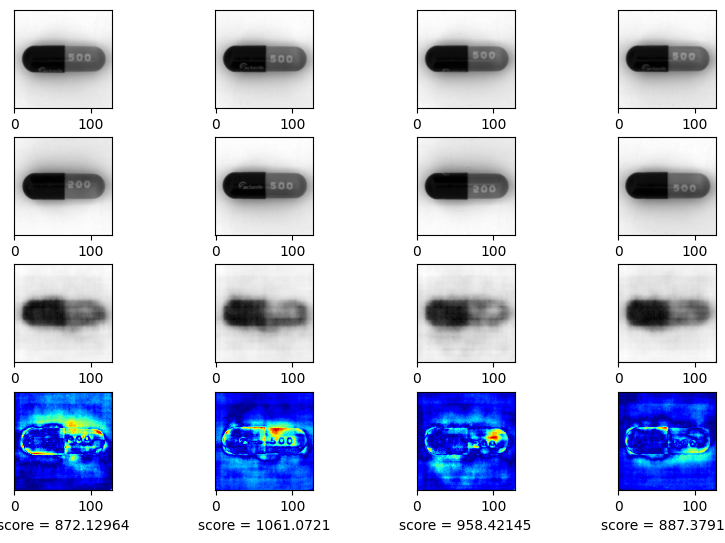

EPOCH 51/110
	 partial train loss (single batch): 0.020939
	 partial train loss (single batch): 0.021130
	 partial train loss (single batch): 0.030764
	 partial train loss (single batch): 0.025830
	 partial train loss (single batch): 0.021148
	 partial train loss (single batch): 0.023586
	 partial train loss (single batch): 0.017557
	 partial train loss (single batch): 0.036679
	 partial train loss (single batch): 0.021524
	 partial train loss (single batch): 0.021233
	 partial train loss (single batch): 0.021505
	 partial train loss (single batch): 0.016866
	 partial train loss (single batch): 0.018400
	 partial train loss (single batch): 0.020541
	 partial train loss (single batch): 0.015591
	 partial train loss (single batch): 0.023968
	 partial train loss (single batch): 0.015123
	 partial train loss (single batch): 0.014088
	 partial train loss (single batch): 0.024353
	 partial train loss (single batch): 0.019829
	 partial train loss (single batch): 0.026893
	 partial train loss 

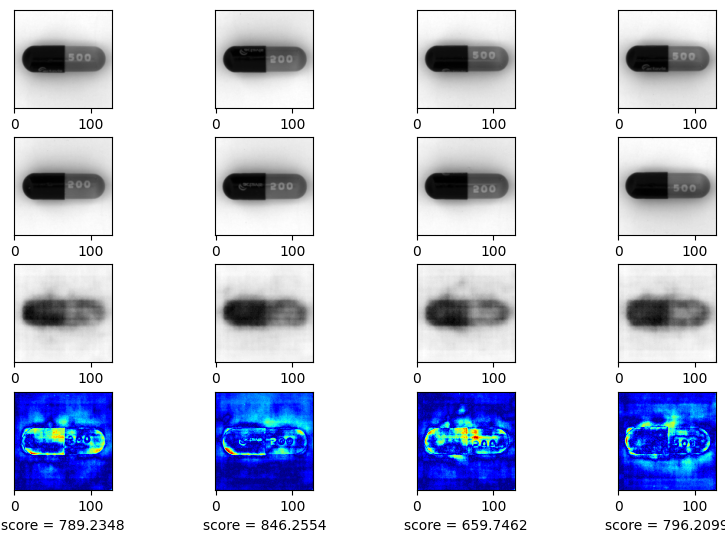

EPOCH 52/110
	 partial train loss (single batch): 0.024192
	 partial train loss (single batch): 0.017831
	 partial train loss (single batch): 0.027148
	 partial train loss (single batch): 0.019089
	 partial train loss (single batch): 0.026249
	 partial train loss (single batch): 0.017666
	 partial train loss (single batch): 0.024990
	 partial train loss (single batch): 0.024220
	 partial train loss (single batch): 0.016587
	 partial train loss (single batch): 0.017071
	 partial train loss (single batch): 0.023594
	 partial train loss (single batch): 0.018676
	 partial train loss (single batch): 0.017819
	 partial train loss (single batch): 0.023235
	 partial train loss (single batch): 0.022352
	 partial train loss (single batch): 0.020380
	 partial train loss (single batch): 0.019453
	 partial train loss (single batch): 0.030214
	 partial train loss (single batch): 0.016356
	 partial train loss (single batch): 0.024163
	 partial train loss (single batch): 0.032531
	 partial train loss 

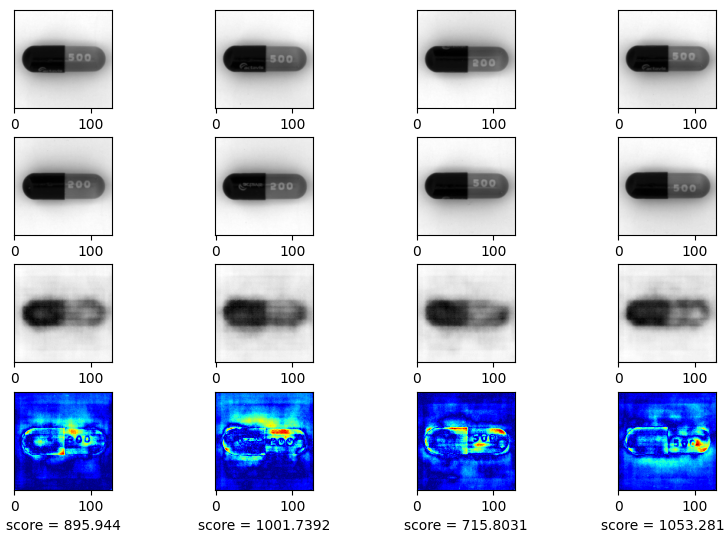

EPOCH 53/110
	 partial train loss (single batch): 0.032635
	 partial train loss (single batch): 0.029269
	 partial train loss (single batch): 0.032049
	 partial train loss (single batch): 0.022459
	 partial train loss (single batch): 0.025937
	 partial train loss (single batch): 0.024418
	 partial train loss (single batch): 0.024273
	 partial train loss (single batch): 0.020925
	 partial train loss (single batch): 0.019813
	 partial train loss (single batch): 0.020383
	 partial train loss (single batch): 0.015406
	 partial train loss (single batch): 0.027576
	 partial train loss (single batch): 0.022297
	 partial train loss (single batch): 0.022530
	 partial train loss (single batch): 0.018194
	 partial train loss (single batch): 0.014563
	 partial train loss (single batch): 0.023525
	 partial train loss (single batch): 0.015062
	 partial train loss (single batch): 0.030489
	 partial train loss (single batch): 0.018944
	 partial train loss (single batch): 0.022305
	 partial train loss 

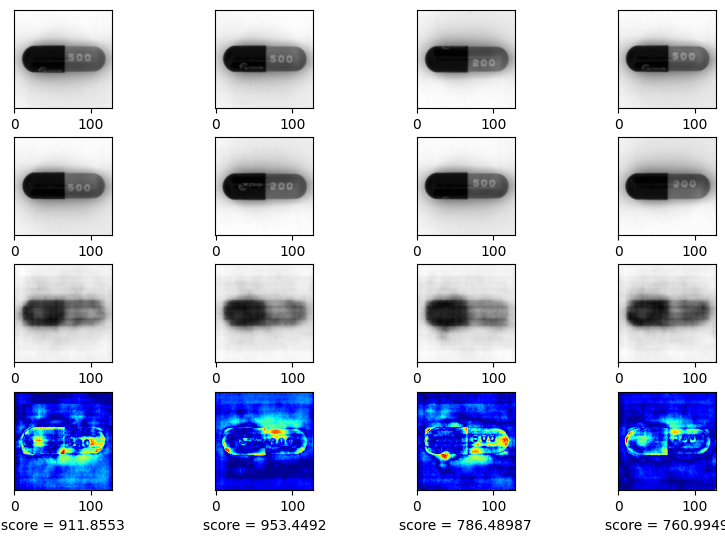

EPOCH 54/110
	 partial train loss (single batch): 0.019765
	 partial train loss (single batch): 0.020833
	 partial train loss (single batch): 0.025149
	 partial train loss (single batch): 0.016292
	 partial train loss (single batch): 0.029720
	 partial train loss (single batch): 0.019339
	 partial train loss (single batch): 0.034019
	 partial train loss (single batch): 0.019581
	 partial train loss (single batch): 0.025040
	 partial train loss (single batch): 0.021078
	 partial train loss (single batch): 0.021908
	 partial train loss (single batch): 0.019783
	 partial train loss (single batch): 0.018949
	 partial train loss (single batch): 0.020828
	 partial train loss (single batch): 0.039979
	 partial train loss (single batch): 0.047056
	 partial train loss (single batch): 0.035120
	 partial train loss (single batch): 0.052221
	 partial train loss (single batch): 0.037123
	 partial train loss (single batch): 0.052831
	 partial train loss (single batch): 0.055101
	 partial train loss 

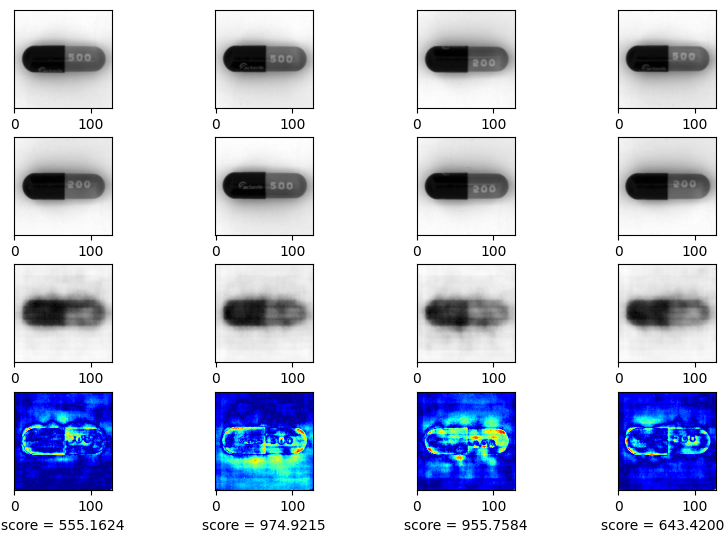

EPOCH 55/110
	 partial train loss (single batch): 0.061962
	 partial train loss (single batch): 0.031923
	 partial train loss (single batch): 0.055845
	 partial train loss (single batch): 0.091786
	 partial train loss (single batch): 0.111097
	 partial train loss (single batch): 0.069513
	 partial train loss (single batch): 0.083692
	 partial train loss (single batch): 0.073222
	 partial train loss (single batch): 0.048276
	 partial train loss (single batch): 0.062480
	 partial train loss (single batch): 0.061234
	 partial train loss (single batch): 0.064867
	 partial train loss (single batch): 0.040890
	 partial train loss (single batch): 0.052000
	 partial train loss (single batch): 0.074679
	 partial train loss (single batch): 0.050786
	 partial train loss (single batch): 0.047567
	 partial train loss (single batch): 0.045065
	 partial train loss (single batch): 0.084348
	 partial train loss (single batch): 0.038252
	 partial train loss (single batch): 0.052605
	 partial train loss 

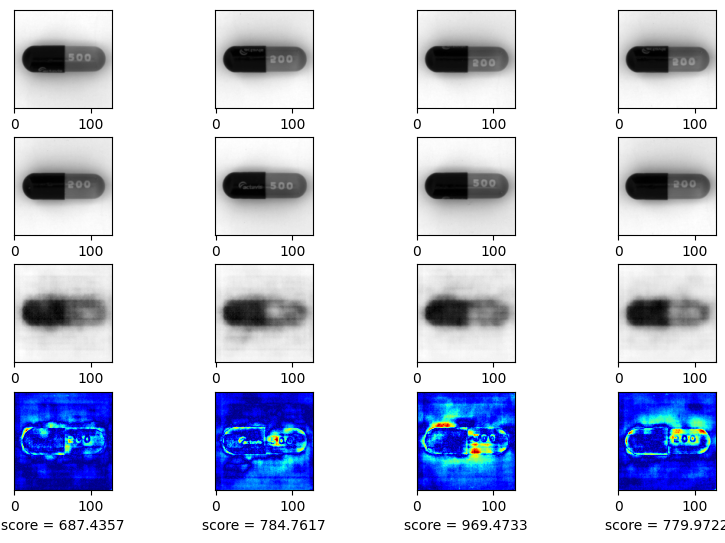

EPOCH 56/110
	 partial train loss (single batch): 0.042891
	 partial train loss (single batch): 0.042987
	 partial train loss (single batch): 0.057232
	 partial train loss (single batch): 0.050809
	 partial train loss (single batch): 0.056637
	 partial train loss (single batch): 0.035450
	 partial train loss (single batch): 0.044086
	 partial train loss (single batch): 0.049858
	 partial train loss (single batch): 0.043025
	 partial train loss (single batch): 0.037651
	 partial train loss (single batch): 0.026304
	 partial train loss (single batch): 0.031454
	 partial train loss (single batch): 0.042045
	 partial train loss (single batch): 0.034089
	 partial train loss (single batch): 0.054299
	 partial train loss (single batch): 0.090260
	 partial train loss (single batch): 0.071566
	 partial train loss (single batch): 0.049905
	 partial train loss (single batch): 0.046854
	 partial train loss (single batch): 0.068986
	 partial train loss (single batch): 0.029450
	 partial train loss 

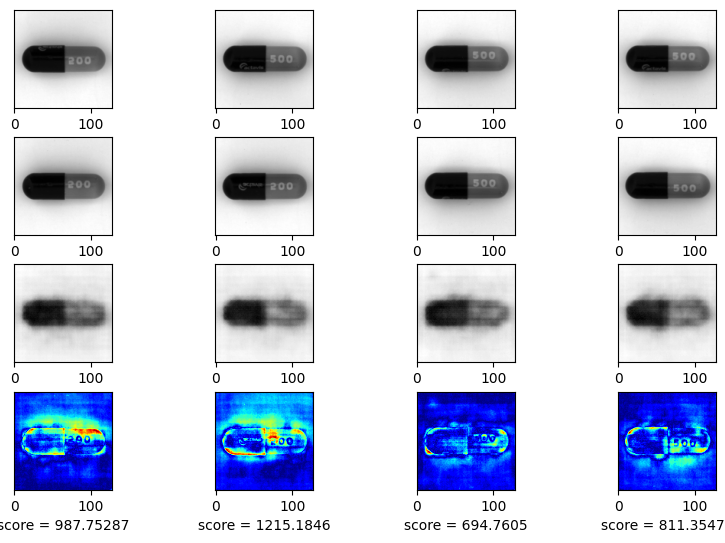

EPOCH 57/110
	 partial train loss (single batch): 0.046066
	 partial train loss (single batch): 0.055779
	 partial train loss (single batch): 0.048003
	 partial train loss (single batch): 0.033038
	 partial train loss (single batch): 0.042461
	 partial train loss (single batch): 0.028780
	 partial train loss (single batch): 0.033663
	 partial train loss (single batch): 0.035537
	 partial train loss (single batch): 0.046586
	 partial train loss (single batch): 0.028754
	 partial train loss (single batch): 0.042613
	 partial train loss (single batch): 0.029620
	 partial train loss (single batch): 0.023711
	 partial train loss (single batch): 0.049645
	 partial train loss (single batch): 0.027061
	 partial train loss (single batch): 0.036646
	 partial train loss (single batch): 0.042553
	 partial train loss (single batch): 0.076099
	 partial train loss (single batch): 0.062289
	 partial train loss (single batch): 0.043782
	 partial train loss (single batch): 0.040069
	 partial train loss 

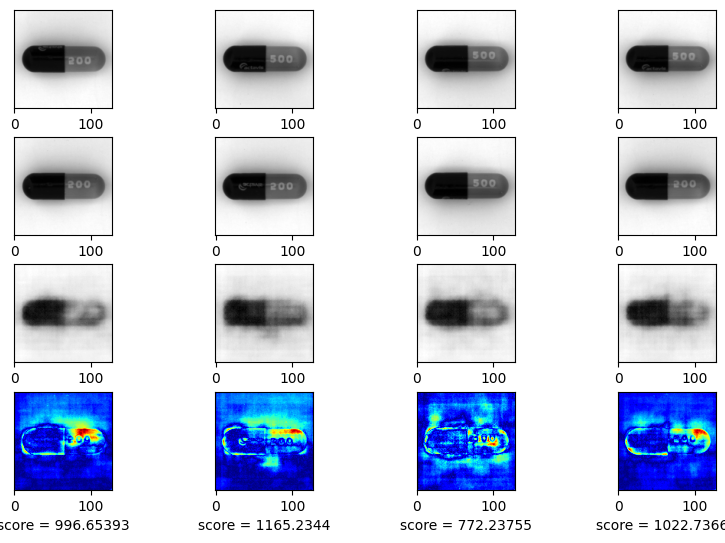

EPOCH 58/110
	 partial train loss (single batch): 0.046439
	 partial train loss (single batch): 0.060633
	 partial train loss (single batch): 0.031378
	 partial train loss (single batch): 0.039555
	 partial train loss (single batch): 0.038010
	 partial train loss (single batch): 0.039886
	 partial train loss (single batch): 0.045901
	 partial train loss (single batch): 0.032315
	 partial train loss (single batch): 0.046530
	 partial train loss (single batch): 0.037120
	 partial train loss (single batch): 0.056114
	 partial train loss (single batch): 0.025707
	 partial train loss (single batch): 0.045472
	 partial train loss (single batch): 0.041232
	 partial train loss (single batch): 0.026315
	 partial train loss (single batch): 0.061768
	 partial train loss (single batch): 0.040628
	 partial train loss (single batch): 0.043166
	 partial train loss (single batch): 0.045832
	 partial train loss (single batch): 0.022998
	 partial train loss (single batch): 0.029360
	 partial train loss 

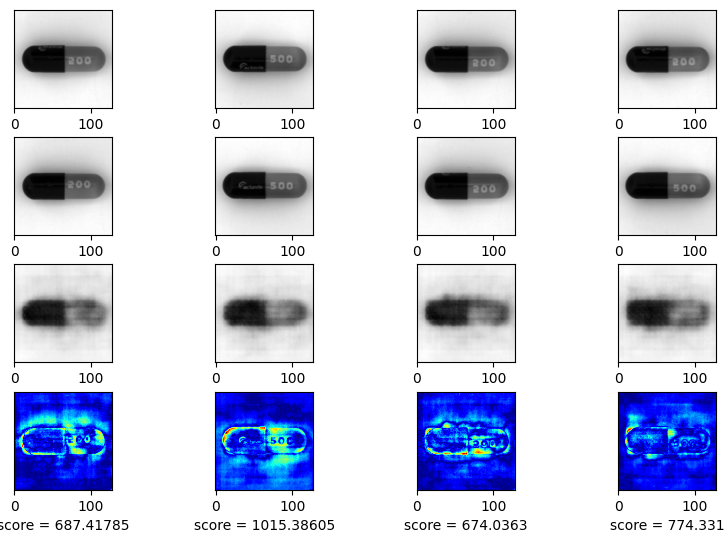

EPOCH 59/110
	 partial train loss (single batch): 0.036838
	 partial train loss (single batch): 0.050526
	 partial train loss (single batch): 0.059724
	 partial train loss (single batch): 0.047284
	 partial train loss (single batch): 0.049233
	 partial train loss (single batch): 0.024617
	 partial train loss (single batch): 0.042680
	 partial train loss (single batch): 0.044785
	 partial train loss (single batch): 0.040768
	 partial train loss (single batch): 0.036434
	 partial train loss (single batch): 0.035018
	 partial train loss (single batch): 0.048365
	 partial train loss (single batch): 0.025911
	 partial train loss (single batch): 0.034338
	 partial train loss (single batch): 0.027133
	 partial train loss (single batch): 0.049139
	 partial train loss (single batch): 0.133204
	 partial train loss (single batch): 0.039744
	 partial train loss (single batch): 0.068360
	 partial train loss (single batch): 0.077292
	 partial train loss (single batch): 0.093208
	 partial train loss 

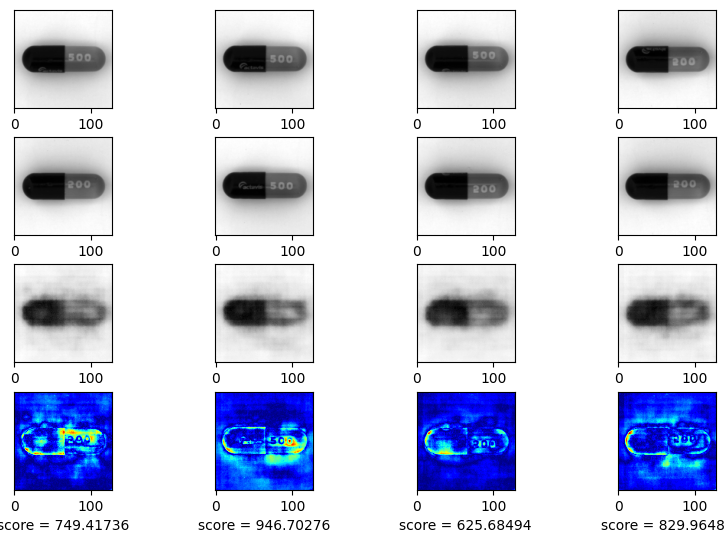

EPOCH 60/110
	 partial train loss (single batch): 0.045913
	 partial train loss (single batch): 0.050044
	 partial train loss (single batch): 0.041961
	 partial train loss (single batch): 0.036147
	 partial train loss (single batch): 0.037415
	 partial train loss (single batch): 0.025946
	 partial train loss (single batch): 0.125364
	 partial train loss (single batch): 0.079204
	 partial train loss (single batch): 0.056349
	 partial train loss (single batch): 0.031321
	 partial train loss (single batch): 0.084342
	 partial train loss (single batch): 0.064491
	 partial train loss (single batch): 0.084302
	 partial train loss (single batch): 0.073817
	 partial train loss (single batch): 0.055043
	 partial train loss (single batch): 0.042806
	 partial train loss (single batch): 0.040625
	 partial train loss (single batch): 0.055204
	 partial train loss (single batch): 0.026815
	 partial train loss (single batch): 0.044804
	 partial train loss (single batch): 0.061989
	 partial train loss 

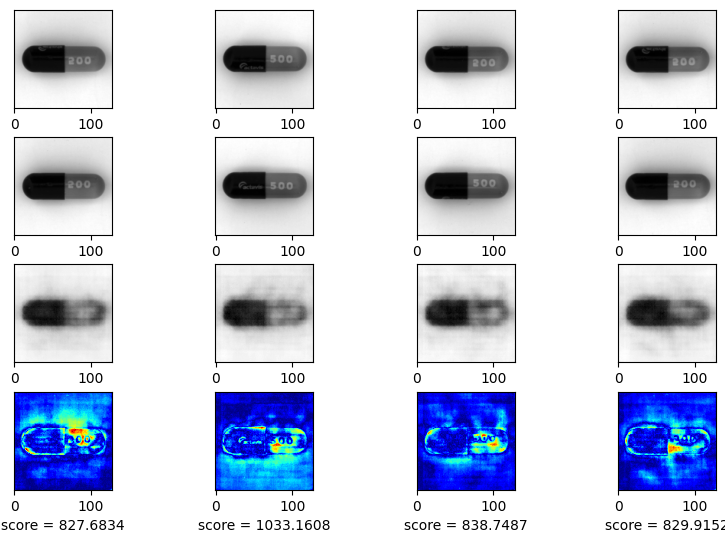

EPOCH 61/110
	 partial train loss (single batch): 0.049879
	 partial train loss (single batch): 0.028674
	 partial train loss (single batch): 0.111710
	 partial train loss (single batch): 0.037409
	 partial train loss (single batch): 0.047058
	 partial train loss (single batch): 0.035519
	 partial train loss (single batch): 0.055577
	 partial train loss (single batch): 0.031609
	 partial train loss (single batch): 0.047469
	 partial train loss (single batch): 0.066119
	 partial train loss (single batch): 0.046929
	 partial train loss (single batch): 0.042805
	 partial train loss (single batch): 0.030437
	 partial train loss (single batch): 0.044185
	 partial train loss (single batch): 0.032632
	 partial train loss (single batch): 0.039031
	 partial train loss (single batch): 0.028064
	 partial train loss (single batch): 0.037783
	 partial train loss (single batch): 0.021341
	 partial train loss (single batch): 0.022921
	 partial train loss (single batch): 0.049118
	 partial train loss 

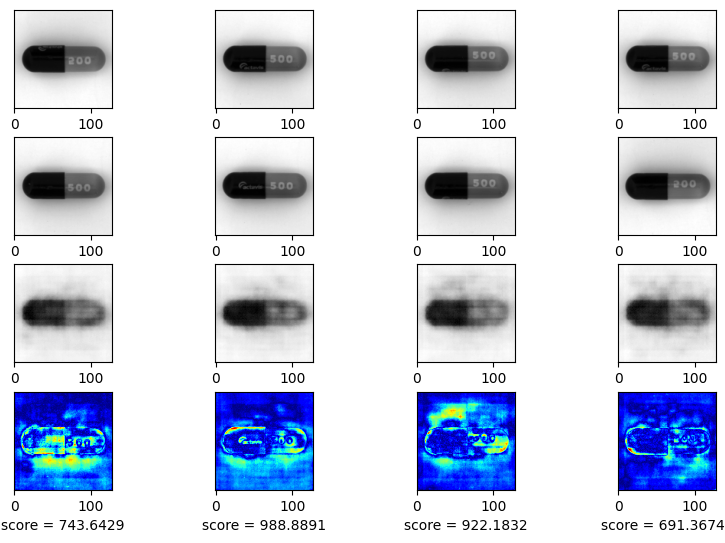

EPOCH 62/110
	 partial train loss (single batch): 0.031645
	 partial train loss (single batch): 0.026693
	 partial train loss (single batch): 0.019229
	 partial train loss (single batch): 0.025572
	 partial train loss (single batch): 0.067270
	 partial train loss (single batch): 0.052514
	 partial train loss (single batch): 0.024003
	 partial train loss (single batch): 0.041468
	 partial train loss (single batch): 0.043062
	 partial train loss (single batch): 0.039786
	 partial train loss (single batch): 0.059891
	 partial train loss (single batch): 0.027758
	 partial train loss (single batch): 0.025407
	 partial train loss (single batch): 0.024039
	 partial train loss (single batch): 0.025336
	 partial train loss (single batch): 0.026352
	 partial train loss (single batch): 0.038935
	 partial train loss (single batch): 0.021238
	 partial train loss (single batch): 0.022022
	 partial train loss (single batch): 0.044766
	 partial train loss (single batch): 0.061892
	 partial train loss 

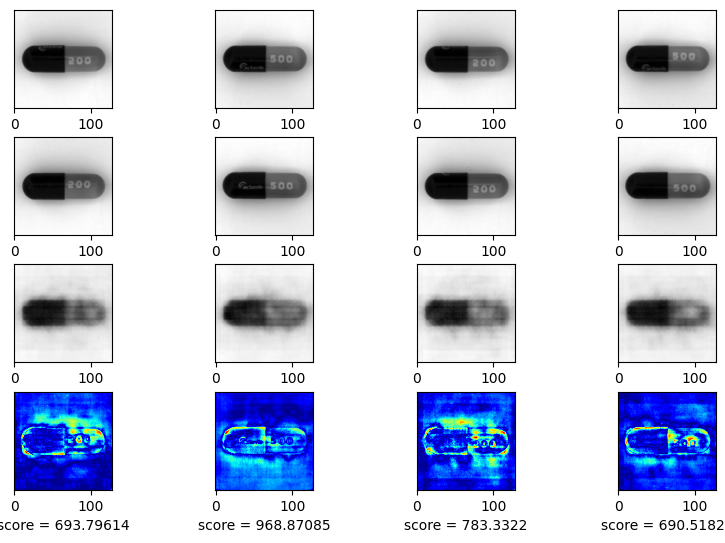

EPOCH 63/110
	 partial train loss (single batch): 0.034908
	 partial train loss (single batch): 0.037869
	 partial train loss (single batch): 0.022698
	 partial train loss (single batch): 0.055677
	 partial train loss (single batch): 0.025813
	 partial train loss (single batch): 0.022505
	 partial train loss (single batch): 0.044885
	 partial train loss (single batch): 0.041920
	 partial train loss (single batch): 0.029903
	 partial train loss (single batch): 0.036748
	 partial train loss (single batch): 0.039387
	 partial train loss (single batch): 0.056508
	 partial train loss (single batch): 0.042546
	 partial train loss (single batch): 0.078532
	 partial train loss (single batch): 0.037682
	 partial train loss (single batch): 0.073903
	 partial train loss (single batch): 0.034286
	 partial train loss (single batch): 0.044505
	 partial train loss (single batch): 0.084988
	 partial train loss (single batch): 0.108686
	 partial train loss (single batch): 0.037858
	 partial train loss 

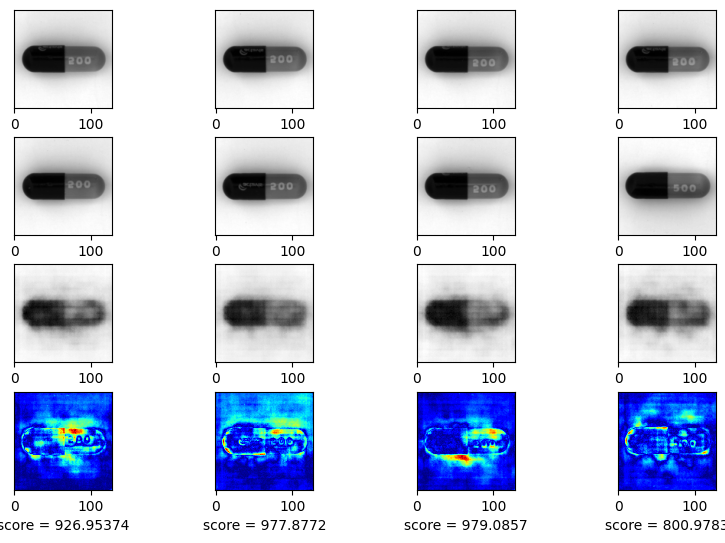

EPOCH 64/110
	 partial train loss (single batch): 0.047817
	 partial train loss (single batch): 0.092535
	 partial train loss (single batch): 0.041631
	 partial train loss (single batch): 0.064456
	 partial train loss (single batch): 0.042764
	 partial train loss (single batch): 0.041680
	 partial train loss (single batch): 0.049059
	 partial train loss (single batch): 0.029182
	 partial train loss (single batch): 0.035316
	 partial train loss (single batch): 0.031099
	 partial train loss (single batch): 0.036140
	 partial train loss (single batch): 0.029959
	 partial train loss (single batch): 0.032580
	 partial train loss (single batch): 0.029609
	 partial train loss (single batch): 0.028103
	 partial train loss (single batch): 0.028045
	 partial train loss (single batch): 0.035291
	 partial train loss (single batch): 0.024514
	 partial train loss (single batch): 0.032080
	 partial train loss (single batch): 0.023993
	 partial train loss (single batch): 0.037450
	 partial train loss 

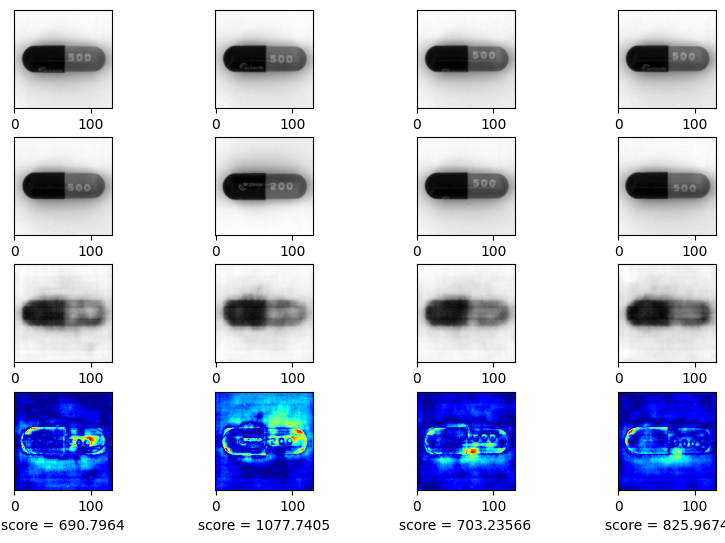

EPOCH 65/110
	 partial train loss (single batch): 0.031840
	 partial train loss (single batch): 0.021632
	 partial train loss (single batch): 0.030020
	 partial train loss (single batch): 0.021859
	 partial train loss (single batch): 0.026448
	 partial train loss (single batch): 0.024075
	 partial train loss (single batch): 0.020756
	 partial train loss (single batch): 0.026565
	 partial train loss (single batch): 0.022045
	 partial train loss (single batch): 0.016690
	 partial train loss (single batch): 0.022901
	 partial train loss (single batch): 0.020672
	 partial train loss (single batch): 0.016874
	 partial train loss (single batch): 0.019876
	 partial train loss (single batch): 0.016444
	 partial train loss (single batch): 0.014324
	 partial train loss (single batch): 0.011115
	 partial train loss (single batch): 0.014813
	 partial train loss (single batch): 0.019934
	 partial train loss (single batch): 0.017346
	 partial train loss (single batch): 0.011837
	 partial train loss 

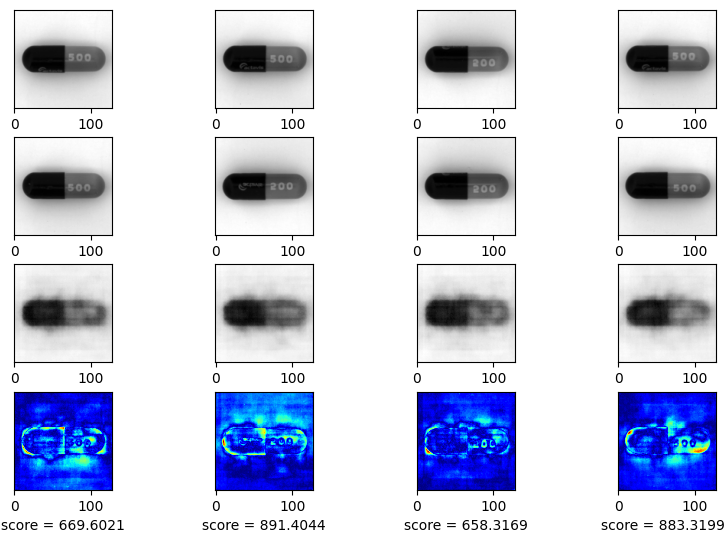

EPOCH 66/110
	 partial train loss (single batch): 0.012525
	 partial train loss (single batch): 0.027798
	 partial train loss (single batch): 0.021604
	 partial train loss (single batch): 0.013818
	 partial train loss (single batch): 0.025613
	 partial train loss (single batch): 0.021096
	 partial train loss (single batch): 0.028302
	 partial train loss (single batch): 0.024422
	 partial train loss (single batch): 0.015722
	 partial train loss (single batch): 0.017780
	 partial train loss (single batch): 0.016657
	 partial train loss (single batch): 0.019885
	 partial train loss (single batch): 0.019746
	 partial train loss (single batch): 0.015983
	 partial train loss (single batch): 0.014406
	 partial train loss (single batch): 0.016141
	 partial train loss (single batch): 0.009828
	 partial train loss (single batch): 0.025527
	 partial train loss (single batch): 0.026660
	 partial train loss (single batch): 0.026749
	 partial train loss (single batch): 0.021411
	 partial train loss 

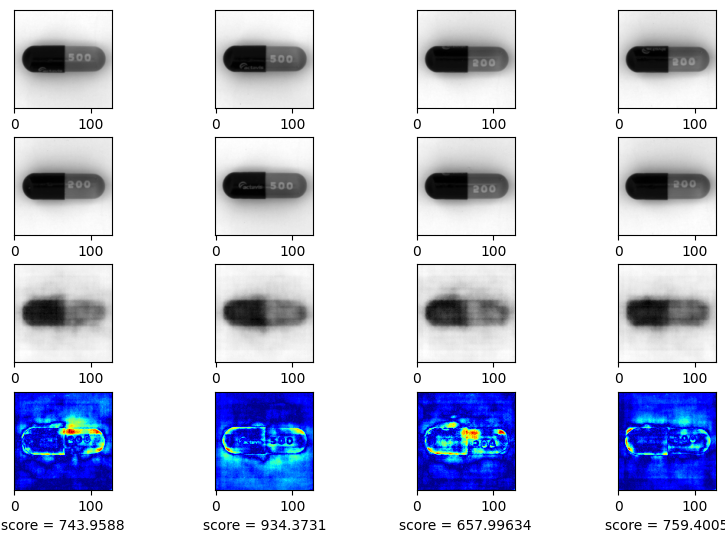

EPOCH 67/110
	 partial train loss (single batch): 0.027099
	 partial train loss (single batch): 0.020203
	 partial train loss (single batch): 0.023852
	 partial train loss (single batch): 0.017068
	 partial train loss (single batch): 0.019472
	 partial train loss (single batch): 0.021972
	 partial train loss (single batch): 0.024357
	 partial train loss (single batch): 0.018867
	 partial train loss (single batch): 0.017193
	 partial train loss (single batch): 0.016398
	 partial train loss (single batch): 0.020272
	 partial train loss (single batch): 0.017160
	 partial train loss (single batch): 0.017513
	 partial train loss (single batch): 0.014224
	 partial train loss (single batch): 0.015232
	 partial train loss (single batch): 0.015124
	 partial train loss (single batch): 0.020651
	 partial train loss (single batch): 0.017429
	 partial train loss (single batch): 0.031342
	 partial train loss (single batch): 0.022166
	 partial train loss (single batch): 0.021180
	 partial train loss 

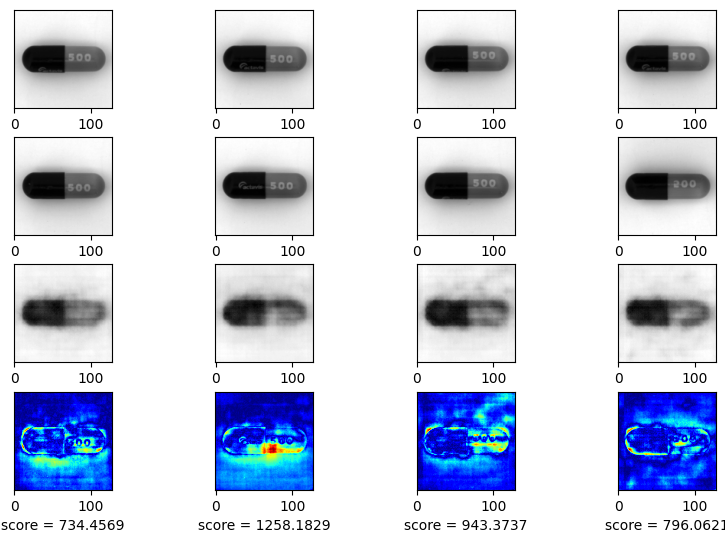

EPOCH 68/110
	 partial train loss (single batch): 0.019341
	 partial train loss (single batch): 0.027806
	 partial train loss (single batch): 0.043094
	 partial train loss (single batch): 0.020635
	 partial train loss (single batch): 0.023983
	 partial train loss (single batch): 0.022910
	 partial train loss (single batch): 0.028014
	 partial train loss (single batch): 0.039383
	 partial train loss (single batch): 0.029669
	 partial train loss (single batch): 0.029884
	 partial train loss (single batch): 0.026342
	 partial train loss (single batch): 0.027594
	 partial train loss (single batch): 0.021241
	 partial train loss (single batch): 0.033678
	 partial train loss (single batch): 0.027415
	 partial train loss (single batch): 0.025473
	 partial train loss (single batch): 0.033648
	 partial train loss (single batch): 0.033321
	 partial train loss (single batch): 0.067221
	 partial train loss (single batch): 0.025067
	 partial train loss (single batch): 0.031434
	 partial train loss 

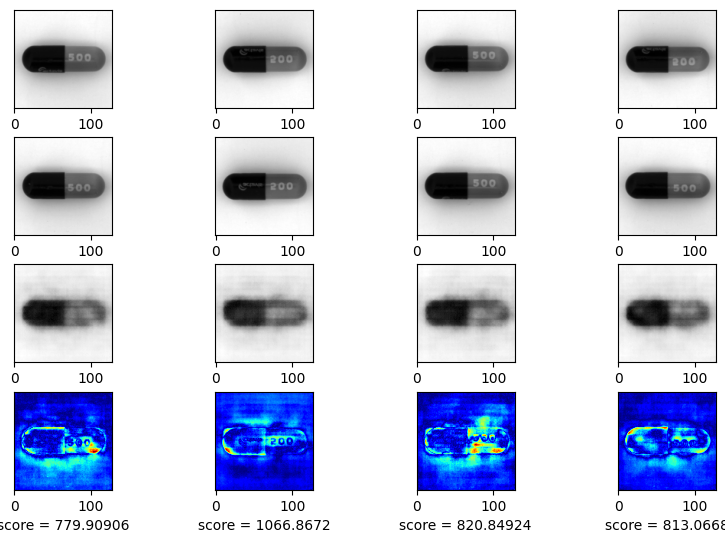

EPOCH 69/110
	 partial train loss (single batch): 0.031288
	 partial train loss (single batch): 0.050447
	 partial train loss (single batch): 0.020625
	 partial train loss (single batch): 0.025670
	 partial train loss (single batch): 0.020289
	 partial train loss (single batch): 0.028675
	 partial train loss (single batch): 0.024780
	 partial train loss (single batch): 0.038762
	 partial train loss (single batch): 0.018975
	 partial train loss (single batch): 0.064466
	 partial train loss (single batch): 0.046206
	 partial train loss (single batch): 0.045385
	 partial train loss (single batch): 0.040138
	 partial train loss (single batch): 0.040577
	 partial train loss (single batch): 0.047884
	 partial train loss (single batch): 0.028649
	 partial train loss (single batch): 0.064187
	 partial train loss (single batch): 0.040897
	 partial train loss (single batch): 0.058088
	 partial train loss (single batch): 0.033877
	 partial train loss (single batch): 0.024573
	 partial train loss 

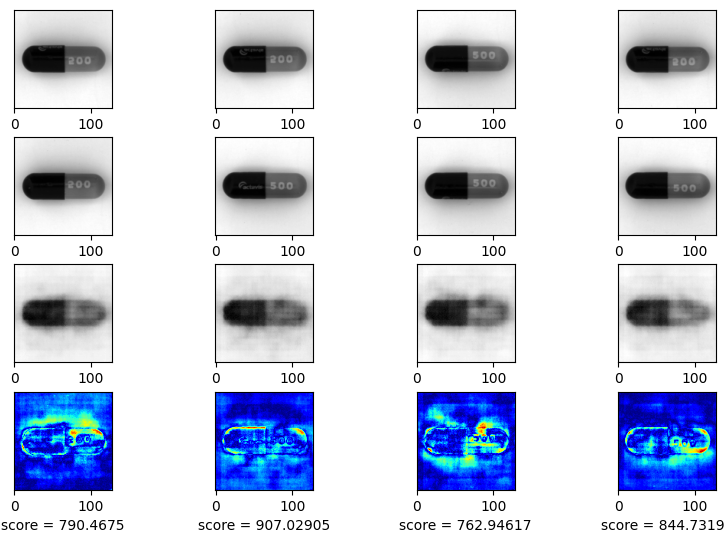

EPOCH 70/110
	 partial train loss (single batch): 0.030970
	 partial train loss (single batch): 0.021437
	 partial train loss (single batch): 0.025188
	 partial train loss (single batch): 0.027835
	 partial train loss (single batch): 0.047177
	 partial train loss (single batch): 0.025188
	 partial train loss (single batch): 0.024236
	 partial train loss (single batch): 0.024641
	 partial train loss (single batch): 0.043888
	 partial train loss (single batch): 0.021412
	 partial train loss (single batch): 0.029201
	 partial train loss (single batch): 0.021589
	 partial train loss (single batch): 0.031339
	 partial train loss (single batch): 0.015463
	 partial train loss (single batch): 0.029821
	 partial train loss (single batch): 0.019920
	 partial train loss (single batch): 0.029402
	 partial train loss (single batch): 0.026811
	 partial train loss (single batch): 0.027235
	 partial train loss (single batch): 0.035824
	 partial train loss (single batch): 0.027554
	 partial train loss 

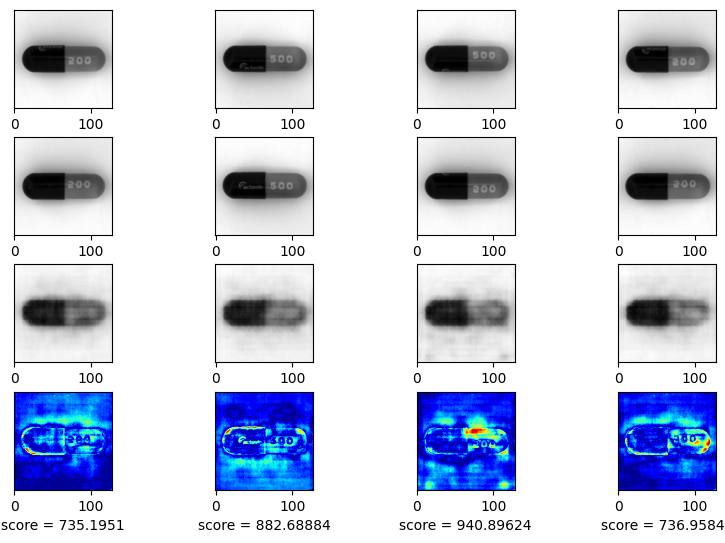

EPOCH 71/110
	 partial train loss (single batch): 0.036369
	 partial train loss (single batch): 0.018561
	 partial train loss (single batch): 0.055843
	 partial train loss (single batch): 0.039537
	 partial train loss (single batch): 0.038821
	 partial train loss (single batch): 0.048361
	 partial train loss (single batch): 0.054184
	 partial train loss (single batch): 0.054125
	 partial train loss (single batch): 0.040748
	 partial train loss (single batch): 0.059736
	 partial train loss (single batch): 0.028666
	 partial train loss (single batch): 0.033654
	 partial train loss (single batch): 0.070201
	 partial train loss (single batch): 0.060781
	 partial train loss (single batch): 0.043925
	 partial train loss (single batch): 0.046429
	 partial train loss (single batch): 0.041799
	 partial train loss (single batch): 0.046342
	 partial train loss (single batch): 0.054119
	 partial train loss (single batch): 0.041401
	 partial train loss (single batch): 0.036328
	 partial train loss 

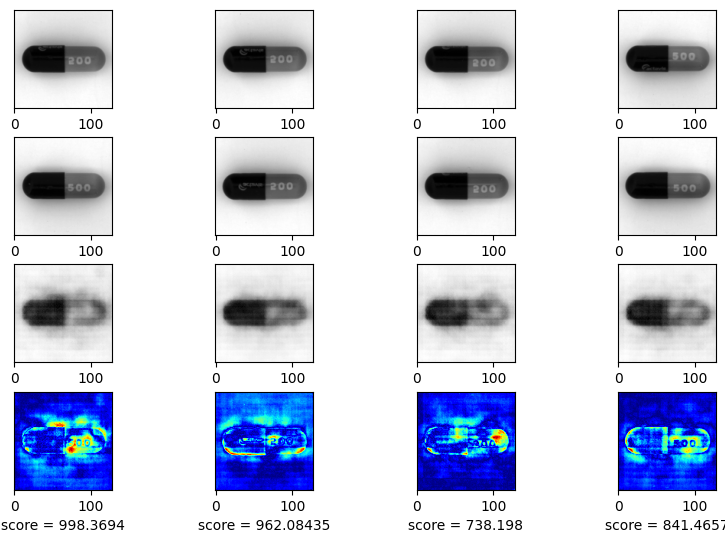

EPOCH 72/110
	 partial train loss (single batch): 0.032945
	 partial train loss (single batch): 0.031906
	 partial train loss (single batch): 0.037464
	 partial train loss (single batch): 0.050565
	 partial train loss (single batch): 0.036861
	 partial train loss (single batch): 0.028496
	 partial train loss (single batch): 0.029177
	 partial train loss (single batch): 0.039907
	 partial train loss (single batch): 0.033377
	 partial train loss (single batch): 0.024061
	 partial train loss (single batch): 0.033193
	 partial train loss (single batch): 0.024145
	 partial train loss (single batch): 0.024535
	 partial train loss (single batch): 0.029937
	 partial train loss (single batch): 0.023261
	 partial train loss (single batch): 0.021178
	 partial train loss (single batch): 0.022138
	 partial train loss (single batch): 0.029933
	 partial train loss (single batch): 0.023628
	 partial train loss (single batch): 0.021028
	 partial train loss (single batch): 0.019530
	 partial train loss 

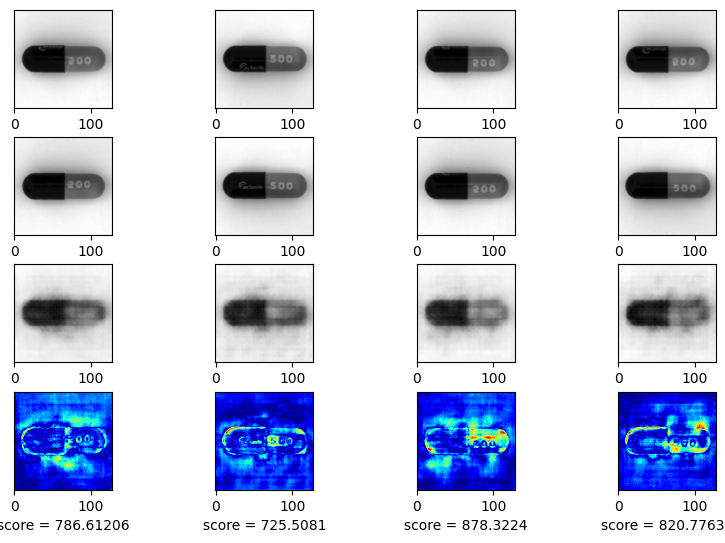

EPOCH 73/110
	 partial train loss (single batch): 0.025431
	 partial train loss (single batch): 0.021837
	 partial train loss (single batch): 0.021244
	 partial train loss (single batch): 0.022369
	 partial train loss (single batch): 0.034963
	 partial train loss (single batch): 0.025903
	 partial train loss (single batch): 0.042337
	 partial train loss (single batch): 0.027812
	 partial train loss (single batch): 0.035461
	 partial train loss (single batch): 0.023156
	 partial train loss (single batch): 0.027408
	 partial train loss (single batch): 0.025868
	 partial train loss (single batch): 0.028202
	 partial train loss (single batch): 0.024955
	 partial train loss (single batch): 0.041400
	 partial train loss (single batch): 0.025850
	 partial train loss (single batch): 0.040390
	 partial train loss (single batch): 0.026251
	 partial train loss (single batch): 0.033532
	 partial train loss (single batch): 0.030233
	 partial train loss (single batch): 0.026085
	 partial train loss 

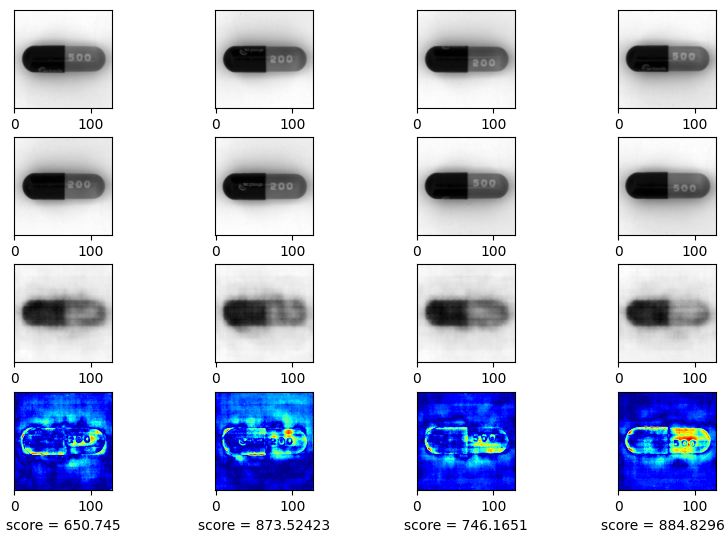

EPOCH 74/110
	 partial train loss (single batch): 0.029126
	 partial train loss (single batch): 0.023027
	 partial train loss (single batch): 0.016494
	 partial train loss (single batch): 0.020493
	 partial train loss (single batch): 0.020319
	 partial train loss (single batch): 0.017283
	 partial train loss (single batch): 0.016758
	 partial train loss (single batch): 0.017842
	 partial train loss (single batch): 0.011711
	 partial train loss (single batch): 0.017432
	 partial train loss (single batch): 0.015659
	 partial train loss (single batch): 0.018825
	 partial train loss (single batch): 0.018170
	 partial train loss (single batch): 0.024547
	 partial train loss (single batch): 0.020133
	 partial train loss (single batch): 0.015690
	 partial train loss (single batch): 0.016286
	 partial train loss (single batch): 0.012676
	 partial train loss (single batch): 0.016759
	 partial train loss (single batch): 0.016888
	 partial train loss (single batch): 0.021421
	 partial train loss 

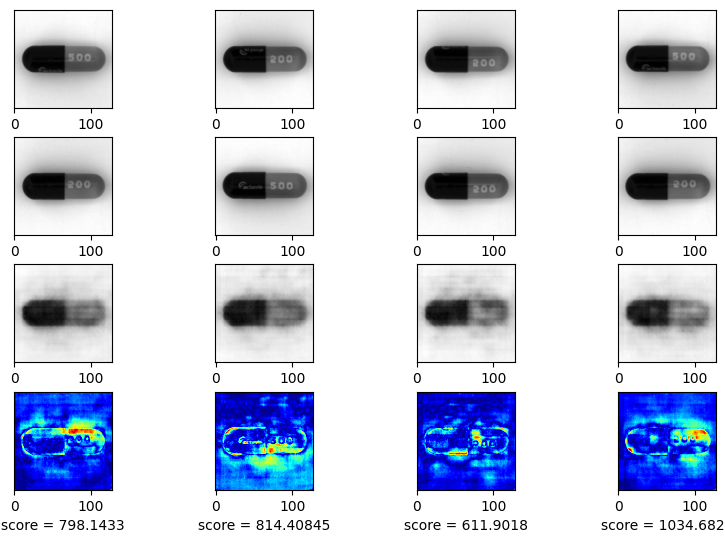

EPOCH 75/110
	 partial train loss (single batch): 0.011981
	 partial train loss (single batch): 0.014165
	 partial train loss (single batch): 0.017000
	 partial train loss (single batch): 0.013010
	 partial train loss (single batch): 0.010741
	 partial train loss (single batch): 0.013829
	 partial train loss (single batch): 0.014501
	 partial train loss (single batch): 0.022324
	 partial train loss (single batch): 0.028089
	 partial train loss (single batch): 0.019329
	 partial train loss (single batch): 0.026921
	 partial train loss (single batch): 0.024536
	 partial train loss (single batch): 0.018834
	 partial train loss (single batch): 0.026680
	 partial train loss (single batch): 0.015900
	 partial train loss (single batch): 0.029490
	 partial train loss (single batch): 0.024367
	 partial train loss (single batch): 0.015936
	 partial train loss (single batch): 0.019769
	 partial train loss (single batch): 0.021384
	 partial train loss (single batch): 0.019180
	 partial train loss 

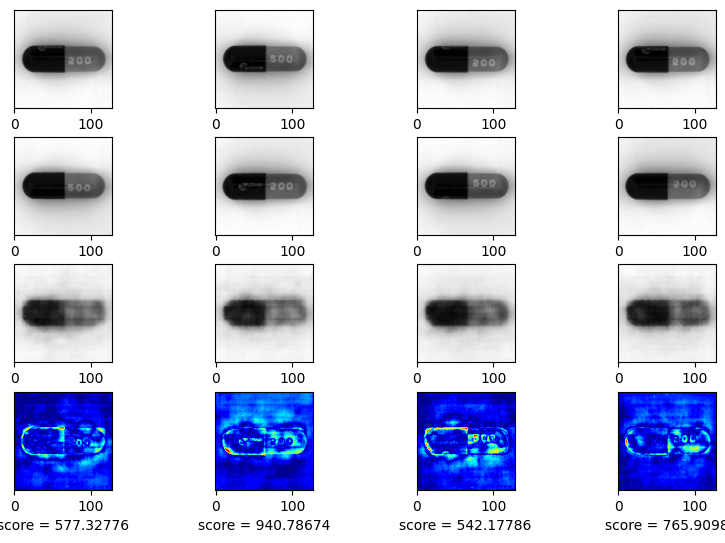

EPOCH 76/110
	 partial train loss (single batch): 0.032316
	 partial train loss (single batch): 0.021444
	 partial train loss (single batch): 0.025760
	 partial train loss (single batch): 0.015327
	 partial train loss (single batch): 0.017767
	 partial train loss (single batch): 0.014954
	 partial train loss (single batch): 0.023451
	 partial train loss (single batch): 0.014570
	 partial train loss (single batch): 0.014734
	 partial train loss (single batch): 0.015256
	 partial train loss (single batch): 0.014850
	 partial train loss (single batch): 0.015200
	 partial train loss (single batch): 0.026244
	 partial train loss (single batch): 0.028876
	 partial train loss (single batch): 0.017365
	 partial train loss (single batch): 0.018388
	 partial train loss (single batch): 0.015882
	 partial train loss (single batch): 0.017729
	 partial train loss (single batch): 0.016131
	 partial train loss (single batch): 0.011713
	 partial train loss (single batch): 0.014908
	 partial train loss 

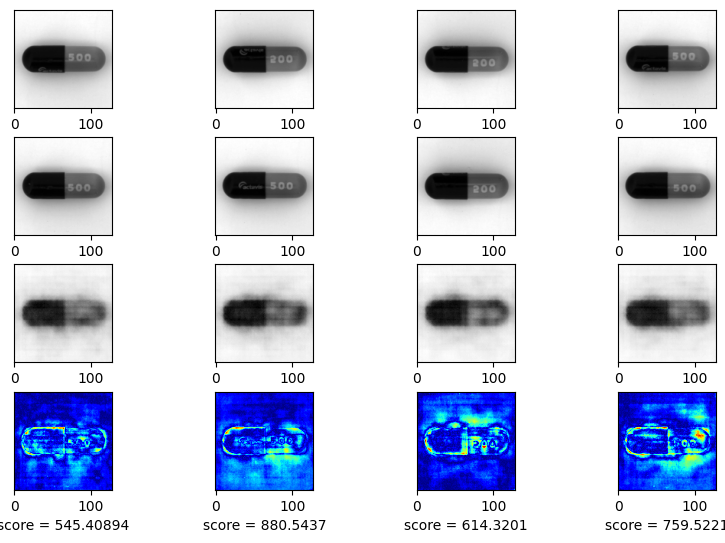

EPOCH 77/110
	 partial train loss (single batch): 0.017367
	 partial train loss (single batch): 0.013512
	 partial train loss (single batch): 0.015090
	 partial train loss (single batch): 0.016135
	 partial train loss (single batch): 0.021057
	 partial train loss (single batch): 0.058161
	 partial train loss (single batch): 0.037886
	 partial train loss (single batch): 0.030170
	 partial train loss (single batch): 0.026197
	 partial train loss (single batch): 0.034533
	 partial train loss (single batch): 0.029140
	 partial train loss (single batch): 0.048103
	 partial train loss (single batch): 0.031046
	 partial train loss (single batch): 0.038149
	 partial train loss (single batch): 0.025289
	 partial train loss (single batch): 0.040690
	 partial train loss (single batch): 0.020986
	 partial train loss (single batch): 0.031934
	 partial train loss (single batch): 0.021548
	 partial train loss (single batch): 0.026145
	 partial train loss (single batch): 0.031715
	 partial train loss 

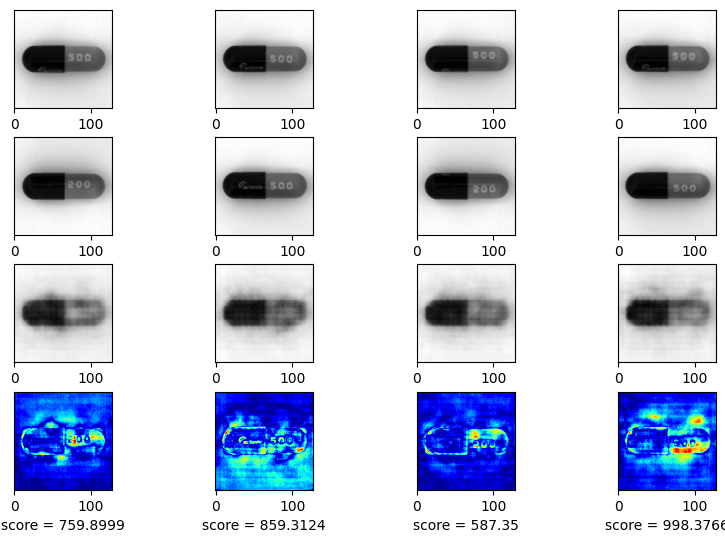

EPOCH 78/110
	 partial train loss (single batch): 0.039321
	 partial train loss (single batch): 0.017986
	 partial train loss (single batch): 0.023919
	 partial train loss (single batch): 0.022678
	 partial train loss (single batch): 0.044706
	 partial train loss (single batch): 0.025151
	 partial train loss (single batch): 0.041495
	 partial train loss (single batch): 0.022821
	 partial train loss (single batch): 0.021337
	 partial train loss (single batch): 0.023191
	 partial train loss (single batch): 0.032262
	 partial train loss (single batch): 0.020837
	 partial train loss (single batch): 0.022119
	 partial train loss (single batch): 0.019750
	 partial train loss (single batch): 0.018590
	 partial train loss (single batch): 0.036468
	 partial train loss (single batch): 0.041289
	 partial train loss (single batch): 0.047347
	 partial train loss (single batch): 0.045415
	 partial train loss (single batch): 0.058016
	 partial train loss (single batch): 0.066778
	 partial train loss 

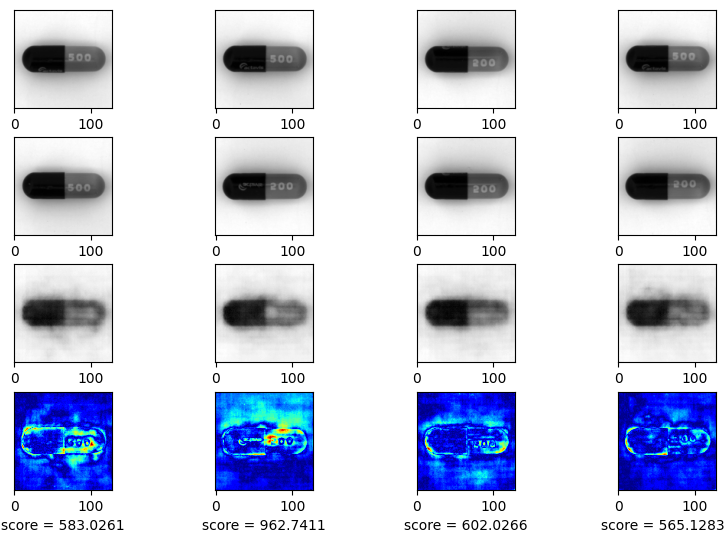

EPOCH 79/110
	 partial train loss (single batch): 0.043734
	 partial train loss (single batch): 0.041902
	 partial train loss (single batch): 0.041646
	 partial train loss (single batch): 0.062034
	 partial train loss (single batch): 0.041527
	 partial train loss (single batch): 0.042152
	 partial train loss (single batch): 0.033034
	 partial train loss (single batch): 0.053929
	 partial train loss (single batch): 0.048616
	 partial train loss (single batch): 0.036890
	 partial train loss (single batch): 0.026852
	 partial train loss (single batch): 0.035859
	 partial train loss (single batch): 0.032297
	 partial train loss (single batch): 0.033395
	 partial train loss (single batch): 0.027107
	 partial train loss (single batch): 0.022764
	 partial train loss (single batch): 0.031277
	 partial train loss (single batch): 0.033183
	 partial train loss (single batch): 0.031658
	 partial train loss (single batch): 0.033651
	 partial train loss (single batch): 0.027749
	 partial train loss 

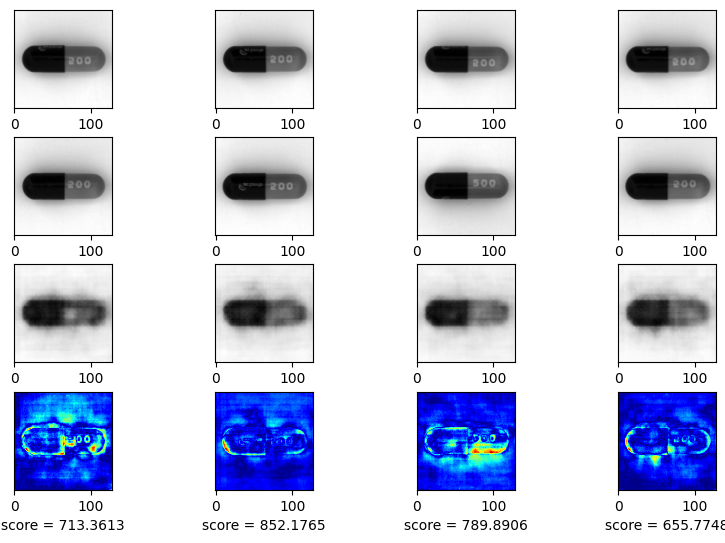

EPOCH 80/110
	 partial train loss (single batch): 0.034938
	 partial train loss (single batch): 0.029990
	 partial train loss (single batch): 0.020093
	 partial train loss (single batch): 0.039820
	 partial train loss (single batch): 0.029395
	 partial train loss (single batch): 0.022408
	 partial train loss (single batch): 0.037894
	 partial train loss (single batch): 0.033107
	 partial train loss (single batch): 0.036610
	 partial train loss (single batch): 0.024052
	 partial train loss (single batch): 0.038216
	 partial train loss (single batch): 0.032836
	 partial train loss (single batch): 0.032542
	 partial train loss (single batch): 0.025323
	 partial train loss (single batch): 0.046937
	 partial train loss (single batch): 0.084373
	 partial train loss (single batch): 0.091590
	 partial train loss (single batch): 0.058524
	 partial train loss (single batch): 0.110074
	 partial train loss (single batch): 0.040862
	 partial train loss (single batch): 0.077549
	 partial train loss 

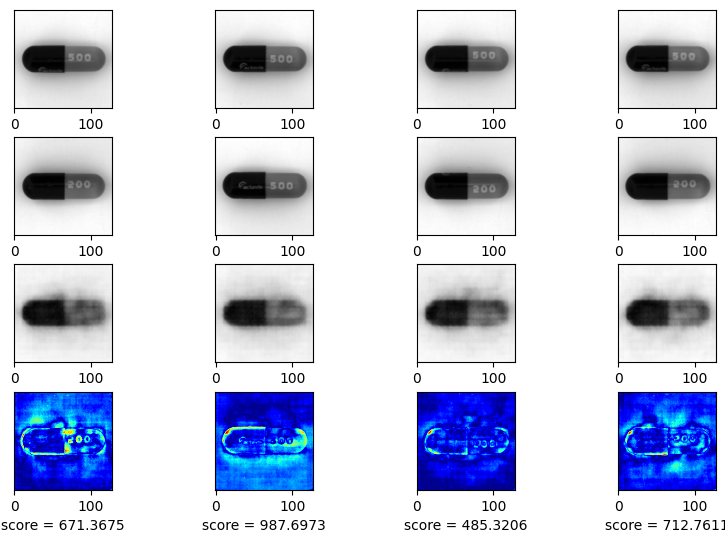

EPOCH 81/110
	 partial train loss (single batch): 0.213060
	 partial train loss (single batch): 0.328394
	 partial train loss (single batch): 0.101174
	 partial train loss (single batch): 0.180969
	 partial train loss (single batch): 0.127580
	 partial train loss (single batch): 0.230052
	 partial train loss (single batch): 0.124658
	 partial train loss (single batch): 0.214039
	 partial train loss (single batch): 0.103376
	 partial train loss (single batch): 0.129959
	 partial train loss (single batch): 0.204167
	 partial train loss (single batch): 0.133152
	 partial train loss (single batch): 0.095076
	 partial train loss (single batch): 0.136761
	 partial train loss (single batch): 0.052671
	 partial train loss (single batch): 0.103486
	 partial train loss (single batch): 0.079962
	 partial train loss (single batch): 0.101147
	 partial train loss (single batch): 0.079751
	 partial train loss (single batch): 0.093932
	 partial train loss (single batch): 0.062417
	 partial train loss 

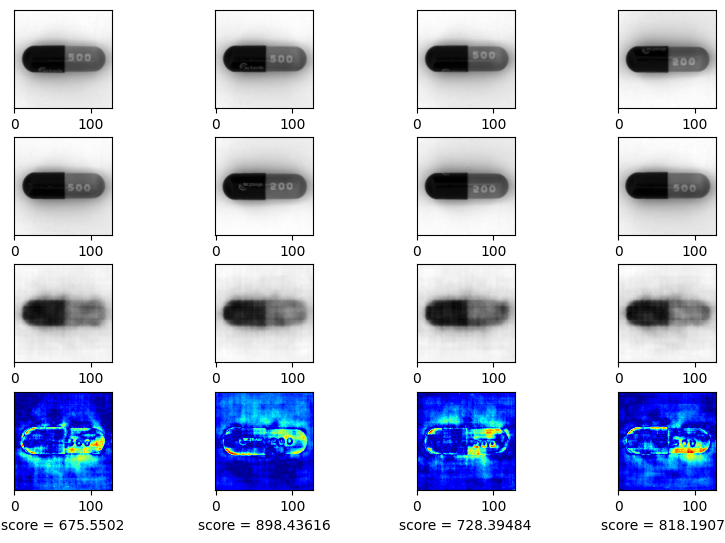

EPOCH 82/110
	 partial train loss (single batch): 0.119841
	 partial train loss (single batch): 0.129503
	 partial train loss (single batch): 0.074230
	 partial train loss (single batch): 0.131828
	 partial train loss (single batch): 0.118801
	 partial train loss (single batch): 0.146978
	 partial train loss (single batch): 0.080119
	 partial train loss (single batch): 0.120988
	 partial train loss (single batch): 0.066778
	 partial train loss (single batch): 0.074451
	 partial train loss (single batch): 0.151549
	 partial train loss (single batch): 0.107033
	 partial train loss (single batch): 0.103227
	 partial train loss (single batch): 0.100431
	 partial train loss (single batch): 0.116349
	 partial train loss (single batch): 0.096604
	 partial train loss (single batch): 0.054486
	 partial train loss (single batch): 0.050629
	 partial train loss (single batch): 0.106156
	 partial train loss (single batch): 0.094004
	 partial train loss (single batch): 0.112778
	 partial train loss 

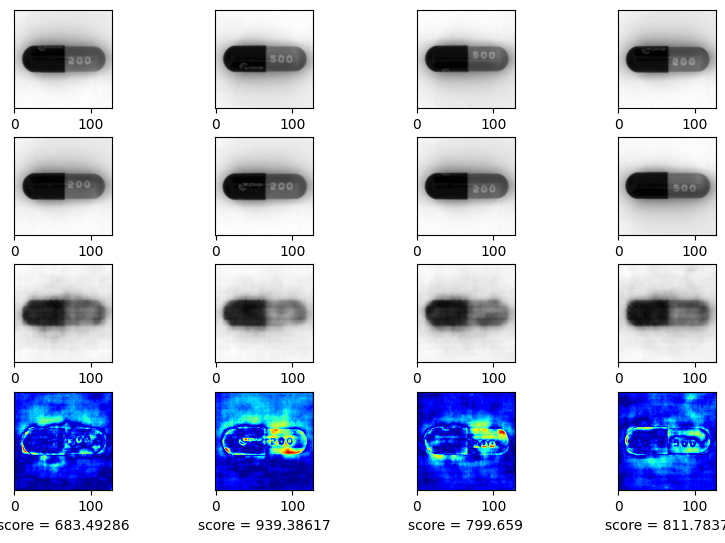

EPOCH 83/110
	 partial train loss (single batch): 0.094122
	 partial train loss (single batch): 0.092219
	 partial train loss (single batch): 0.188483
	 partial train loss (single batch): 0.149908
	 partial train loss (single batch): 0.162977
	 partial train loss (single batch): 0.209620
	 partial train loss (single batch): 0.138143
	 partial train loss (single batch): 0.106185
	 partial train loss (single batch): 0.197909
	 partial train loss (single batch): 0.138354
	 partial train loss (single batch): 0.148719
	 partial train loss (single batch): 0.146309
	 partial train loss (single batch): 0.123440
	 partial train loss (single batch): 0.158336
	 partial train loss (single batch): 0.148585
	 partial train loss (single batch): 0.123858
	 partial train loss (single batch): 0.100592
	 partial train loss (single batch): 0.113636
	 partial train loss (single batch): 0.095412
	 partial train loss (single batch): 0.094710
	 partial train loss (single batch): 0.085442
	 partial train loss 

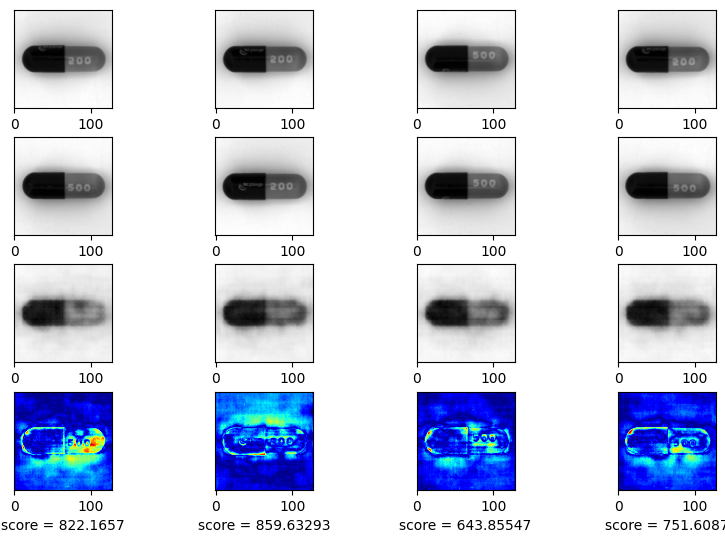

EPOCH 84/110
	 partial train loss (single batch): 0.085329
	 partial train loss (single batch): 0.055263
	 partial train loss (single batch): 0.059749
	 partial train loss (single batch): 0.052240
	 partial train loss (single batch): 0.047418
	 partial train loss (single batch): 0.052728
	 partial train loss (single batch): 0.046401
	 partial train loss (single batch): 0.057968
	 partial train loss (single batch): 0.062618
	 partial train loss (single batch): 0.051903
	 partial train loss (single batch): 0.039871
	 partial train loss (single batch): 0.046850
	 partial train loss (single batch): 0.054795
	 partial train loss (single batch): 0.052546
	 partial train loss (single batch): 0.029785
	 partial train loss (single batch): 0.045342
	 partial train loss (single batch): 0.028067
	 partial train loss (single batch): 0.045915
	 partial train loss (single batch): 0.024794
	 partial train loss (single batch): 0.188867
	 partial train loss (single batch): 0.284885
	 partial train loss 

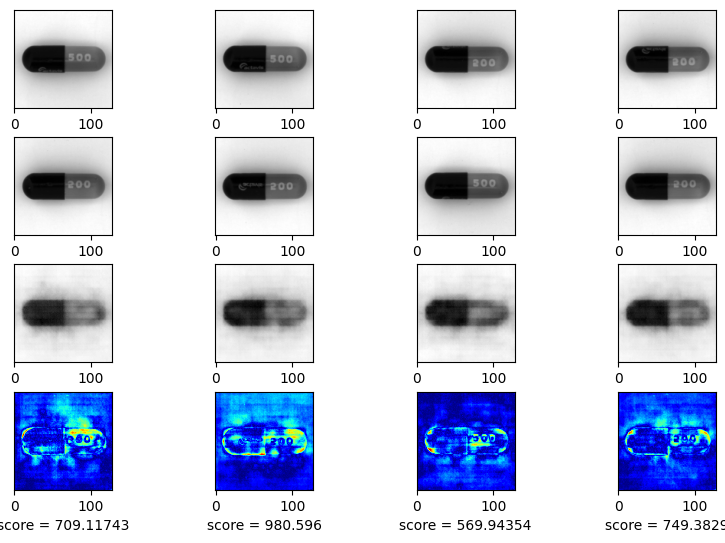

EPOCH 85/110
	 partial train loss (single batch): 0.220360
	 partial train loss (single batch): 0.113636
	 partial train loss (single batch): 0.173998
	 partial train loss (single batch): 0.159570
	 partial train loss (single batch): 0.183894
	 partial train loss (single batch): 0.159366
	 partial train loss (single batch): 0.156619
	 partial train loss (single batch): 0.093428
	 partial train loss (single batch): 0.173750
	 partial train loss (single batch): 0.080240
	 partial train loss (single batch): 0.110587
	 partial train loss (single batch): 0.185489
	 partial train loss (single batch): 0.202381
	 partial train loss (single batch): 0.153002
	 partial train loss (single batch): 0.205321
	 partial train loss (single batch): 0.204244
	 partial train loss (single batch): 0.120891
	 partial train loss (single batch): 0.117614
	 partial train loss (single batch): 0.119156
	 partial train loss (single batch): 0.175959
	 partial train loss (single batch): 0.099976
	 partial train loss 

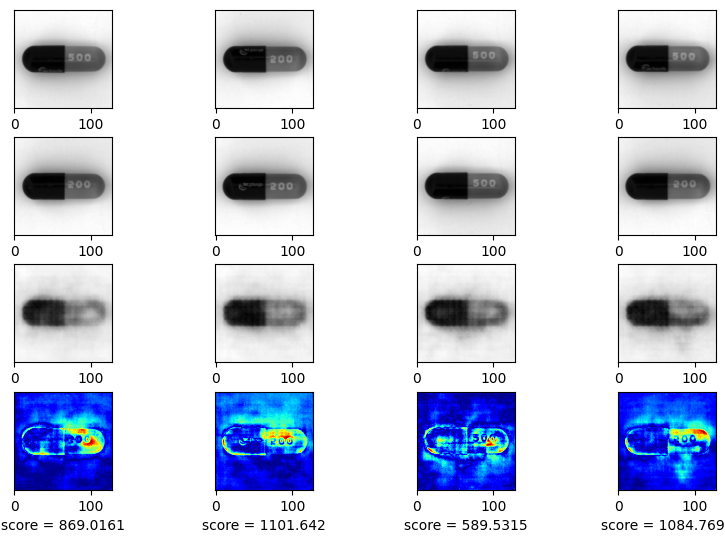

EPOCH 86/110
	 partial train loss (single batch): 0.154954
	 partial train loss (single batch): 0.195236
	 partial train loss (single batch): 0.131874
	 partial train loss (single batch): 0.236380
	 partial train loss (single batch): 0.115484
	 partial train loss (single batch): 0.108772
	 partial train loss (single batch): 0.149321
	 partial train loss (single batch): 0.110344
	 partial train loss (single batch): 0.116231
	 partial train loss (single batch): 0.092338
	 partial train loss (single batch): 0.185664
	 partial train loss (single batch): 0.083178
	 partial train loss (single batch): 0.151734
	 partial train loss (single batch): 0.091146
	 partial train loss (single batch): 0.087423
	 partial train loss (single batch): 0.106594
	 partial train loss (single batch): 0.099600
	 partial train loss (single batch): 0.062571
	 partial train loss (single batch): 0.122158
	 partial train loss (single batch): 0.156283
	 partial train loss (single batch): 0.114429
	 partial train loss 

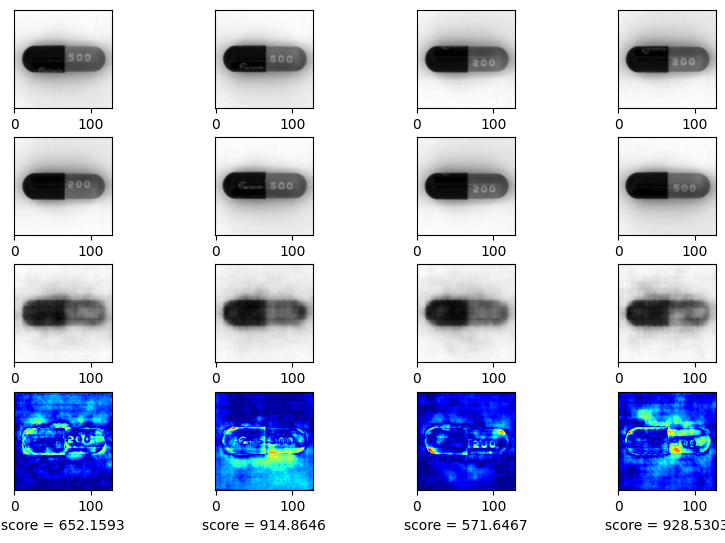

EPOCH 87/110
	 partial train loss (single batch): 0.093933
	 partial train loss (single batch): 0.148382
	 partial train loss (single batch): 0.086729
	 partial train loss (single batch): 0.089584
	 partial train loss (single batch): 0.072517
	 partial train loss (single batch): 0.077248
	 partial train loss (single batch): 0.063638
	 partial train loss (single batch): 0.070443
	 partial train loss (single batch): 0.070985
	 partial train loss (single batch): 0.079371
	 partial train loss (single batch): 0.072883
	 partial train loss (single batch): 0.086799
	 partial train loss (single batch): 2.139163
	 partial train loss (single batch): 1.236292
	 partial train loss (single batch): 1.828518
	 partial train loss (single batch): 2.737940
	 partial train loss (single batch): 4.044196
	 partial train loss (single batch): 0.723115
	 partial train loss (single batch): 0.678053
	 partial train loss (single batch): 0.924366
	 partial train loss (single batch): 0.691905
	 partial train loss 

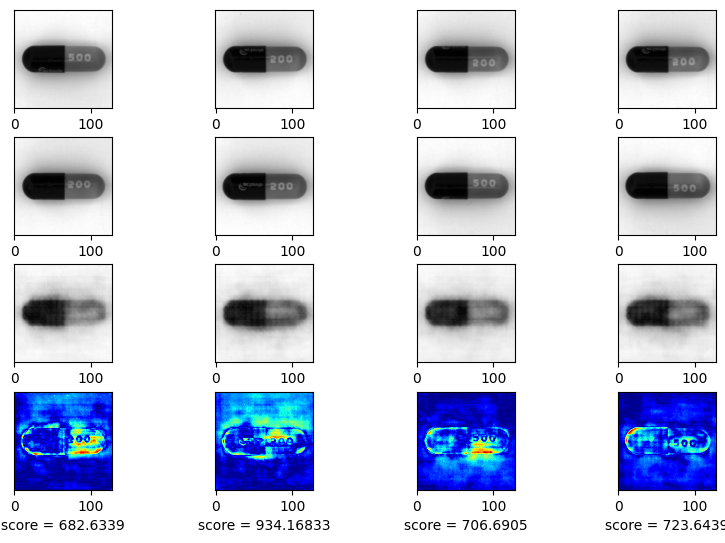

EPOCH 88/110
	 partial train loss (single batch): 2.345785
	 partial train loss (single batch): 0.747242
	 partial train loss (single batch): 2.901117
	 partial train loss (single batch): 0.633101
	 partial train loss (single batch): 0.793347
	 partial train loss (single batch): 1.200756
	 partial train loss (single batch): 3.366176
	 partial train loss (single batch): 1.683948
	 partial train loss (single batch): 0.608545
	 partial train loss (single batch): 1.366751
	 partial train loss (single batch): 0.905353
	 partial train loss (single batch): 0.590093
	 partial train loss (single batch): 0.738978
	 partial train loss (single batch): 1.037281
	 partial train loss (single batch): 0.422586
	 partial train loss (single batch): 0.598541
	 partial train loss (single batch): 0.606593
	 partial train loss (single batch): 0.664792
	 partial train loss (single batch): 0.453082
	 partial train loss (single batch): 0.649482
	 partial train loss (single batch): 0.465172
	 partial train loss 

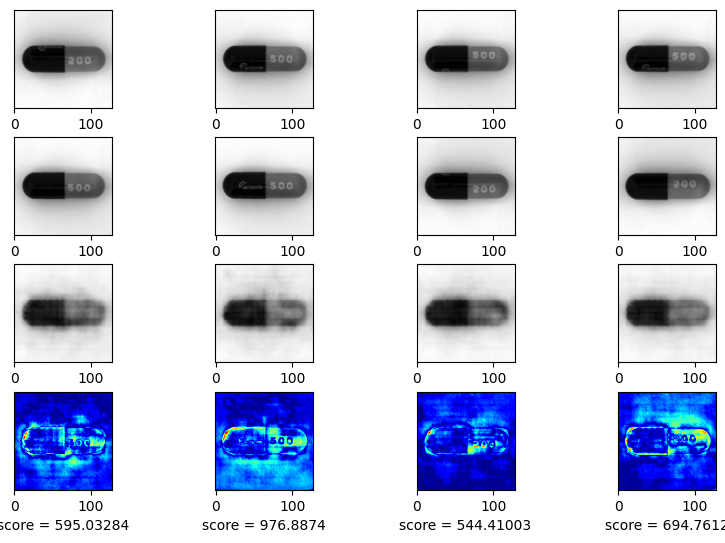

EPOCH 89/110
	 partial train loss (single batch): 0.383281
	 partial train loss (single batch): 0.298942
	 partial train loss (single batch): 0.358290
	 partial train loss (single batch): 0.468116
	 partial train loss (single batch): 0.667889
	 partial train loss (single batch): 0.304249
	 partial train loss (single batch): 0.609962
	 partial train loss (single batch): 0.359346
	 partial train loss (single batch): 0.463883
	 partial train loss (single batch): 0.396108
	 partial train loss (single batch): 0.384532
	 partial train loss (single batch): 0.239864
	 partial train loss (single batch): 0.439739
	 partial train loss (single batch): 0.276633
	 partial train loss (single batch): 0.441119
	 partial train loss (single batch): 0.230213
	 partial train loss (single batch): 0.265750
	 partial train loss (single batch): 0.447852
	 partial train loss (single batch): 0.354395
	 partial train loss (single batch): 0.371055
	 partial train loss (single batch): 0.365069
	 partial train loss 

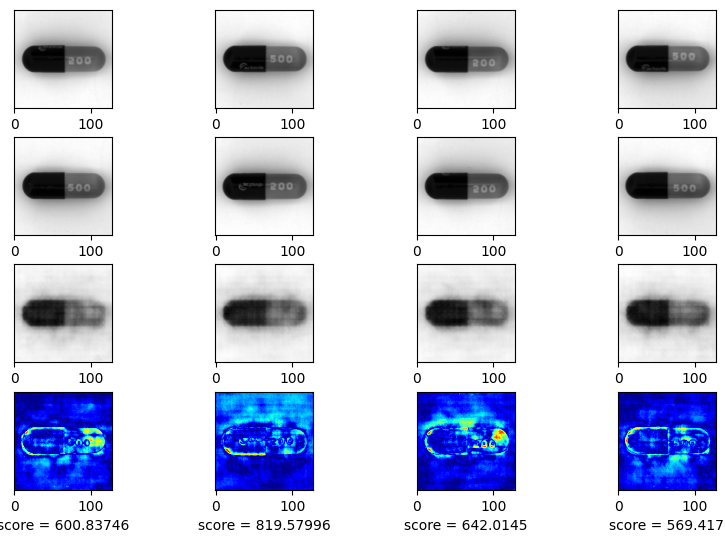

EPOCH 90/110
	 partial train loss (single batch): 0.316065
	 partial train loss (single batch): 0.351852
	 partial train loss (single batch): 0.265746
	 partial train loss (single batch): 0.249240
	 partial train loss (single batch): 0.262686
	 partial train loss (single batch): 0.239327
	 partial train loss (single batch): 0.290533
	 partial train loss (single batch): 0.387969
	 partial train loss (single batch): 0.513471
	 partial train loss (single batch): 0.172526
	 partial train loss (single batch): 0.438626
	 partial train loss (single batch): 0.403503
	 partial train loss (single batch): 0.297397
	 partial train loss (single batch): 0.371186
	 partial train loss (single batch): 0.345661
	 partial train loss (single batch): 0.224009
	 partial train loss (single batch): 0.173272
	 partial train loss (single batch): 0.232783
	 partial train loss (single batch): 0.179609
	 partial train loss (single batch): 0.172742
	 partial train loss (single batch): 0.132340
	 partial train loss 

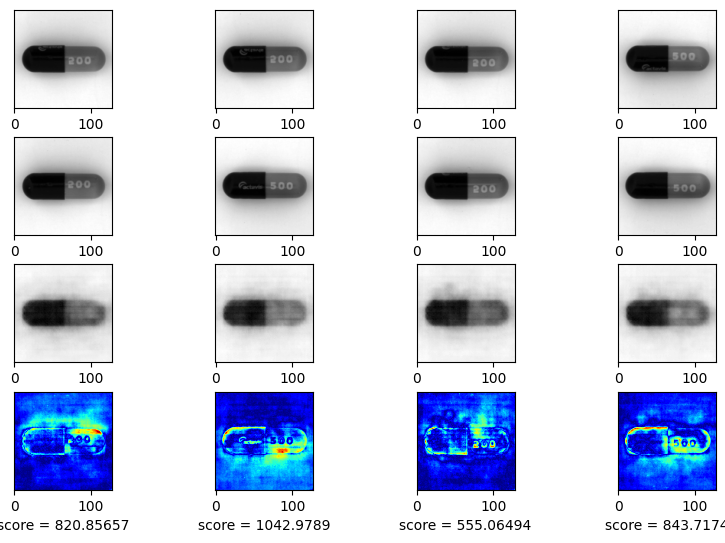

EPOCH 91/110
	 partial train loss (single batch): 0.304635
	 partial train loss (single batch): 0.207935
	 partial train loss (single batch): 0.251884
	 partial train loss (single batch): 0.169669
	 partial train loss (single batch): 0.234454
	 partial train loss (single batch): 0.161424
	 partial train loss (single batch): 0.224723
	 partial train loss (single batch): 0.095556
	 partial train loss (single batch): 0.162954
	 partial train loss (single batch): 0.123762
	 partial train loss (single batch): 0.118410
	 partial train loss (single batch): 0.080161
	 partial train loss (single batch): 0.088174
	 partial train loss (single batch): 0.154306
	 partial train loss (single batch): 0.115778
	 partial train loss (single batch): 0.165491
	 partial train loss (single batch): 0.112610
	 partial train loss (single batch): 0.098565
	 partial train loss (single batch): 0.074253
	 partial train loss (single batch): 0.151276
	 partial train loss (single batch): 0.105312
	 partial train loss 

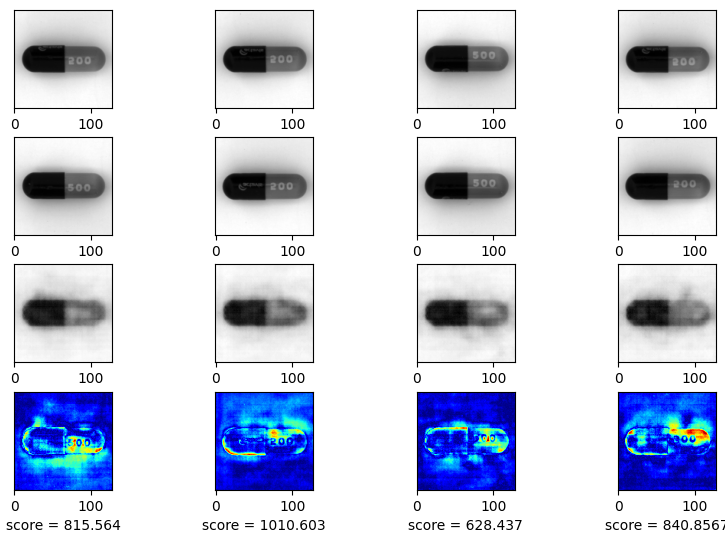

EPOCH 92/110
	 partial train loss (single batch): 0.145496
	 partial train loss (single batch): 0.217341
	 partial train loss (single batch): 0.365011
	 partial train loss (single batch): 0.095520
	 partial train loss (single batch): 0.231509
	 partial train loss (single batch): 0.378078
	 partial train loss (single batch): 0.159288
	 partial train loss (single batch): 0.152301
	 partial train loss (single batch): 0.488728
	 partial train loss (single batch): 0.571484
	 partial train loss (single batch): 0.146830
	 partial train loss (single batch): 0.504057
	 partial train loss (single batch): 0.141059
	 partial train loss (single batch): 0.228597
	 partial train loss (single batch): 0.188747
	 partial train loss (single batch): 0.327399
	 partial train loss (single batch): 0.158256
	 partial train loss (single batch): 0.262370
	 partial train loss (single batch): 0.136047
	 partial train loss (single batch): 0.169644
	 partial train loss (single batch): 0.160126
	 partial train loss 

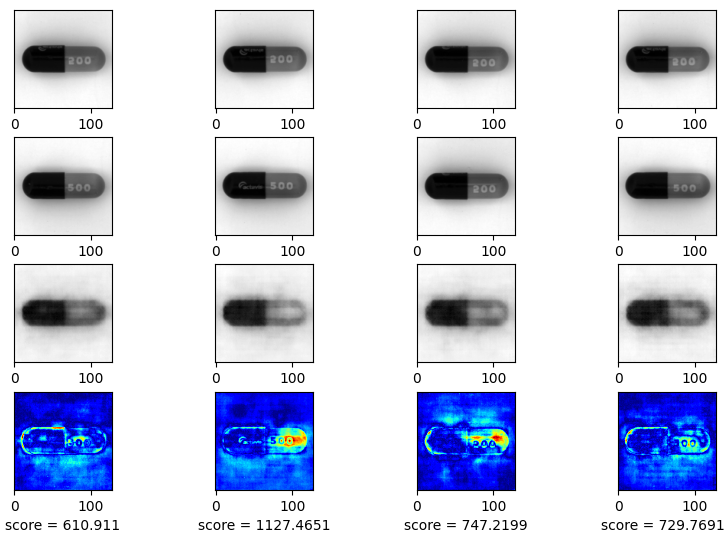

EPOCH 93/110
	 partial train loss (single batch): 0.246689
	 partial train loss (single batch): 0.146348
	 partial train loss (single batch): 0.134409
	 partial train loss (single batch): 0.222756
	 partial train loss (single batch): 0.147540
	 partial train loss (single batch): 0.176648
	 partial train loss (single batch): 0.186988
	 partial train loss (single batch): 0.142031
	 partial train loss (single batch): 0.124267
	 partial train loss (single batch): 0.101803
	 partial train loss (single batch): 0.183345
	 partial train loss (single batch): 0.140302
	 partial train loss (single batch): 0.091087
	 partial train loss (single batch): 0.089360
	 partial train loss (single batch): 0.105987
	 partial train loss (single batch): 0.062553
	 partial train loss (single batch): 0.080100
	 partial train loss (single batch): 0.089009
	 partial train loss (single batch): 0.095216
	 partial train loss (single batch): 0.111217
	 partial train loss (single batch): 0.081231
	 partial train loss 

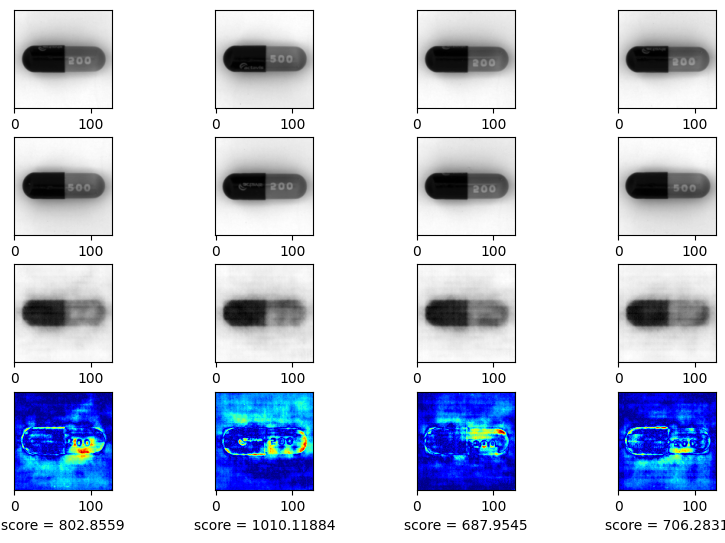

EPOCH 94/110
	 partial train loss (single batch): 0.128007
	 partial train loss (single batch): 0.059411
	 partial train loss (single batch): 0.090516
	 partial train loss (single batch): 0.073459
	 partial train loss (single batch): 0.082134
	 partial train loss (single batch): 0.050327
	 partial train loss (single batch): 0.082544
	 partial train loss (single batch): 0.053345
	 partial train loss (single batch): 0.069277
	 partial train loss (single batch): 0.058737
	 partial train loss (single batch): 0.068221
	 partial train loss (single batch): 0.051141
	 partial train loss (single batch): 0.039895
	 partial train loss (single batch): 0.078998
	 partial train loss (single batch): 0.036558
	 partial train loss (single batch): 0.056272
	 partial train loss (single batch): 0.084749
	 partial train loss (single batch): 0.053562
	 partial train loss (single batch): 0.035070
	 partial train loss (single batch): 0.043413
	 partial train loss (single batch): 0.039013
	 partial train loss 

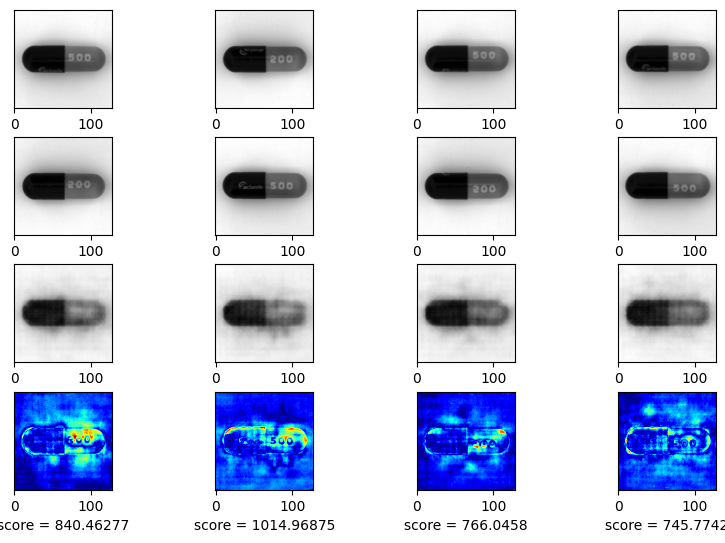

EPOCH 95/110
	 partial train loss (single batch): 0.046670
	 partial train loss (single batch): 0.034366
	 partial train loss (single batch): 0.040988
	 partial train loss (single batch): 0.035786
	 partial train loss (single batch): 0.042574
	 partial train loss (single batch): 0.040043
	 partial train loss (single batch): 0.032793
	 partial train loss (single batch): 0.036019
	 partial train loss (single batch): 0.055016
	 partial train loss (single batch): 0.050575
	 partial train loss (single batch): 0.035639
	 partial train loss (single batch): 0.053152
	 partial train loss (single batch): 0.032122
	 partial train loss (single batch): 0.040187
	 partial train loss (single batch): 0.039556
	 partial train loss (single batch): 0.052572
	 partial train loss (single batch): 0.032590
	 partial train loss (single batch): 0.027299
	 partial train loss (single batch): 0.028048
	 partial train loss (single batch): 0.060066
	 partial train loss (single batch): 0.036449
	 partial train loss 

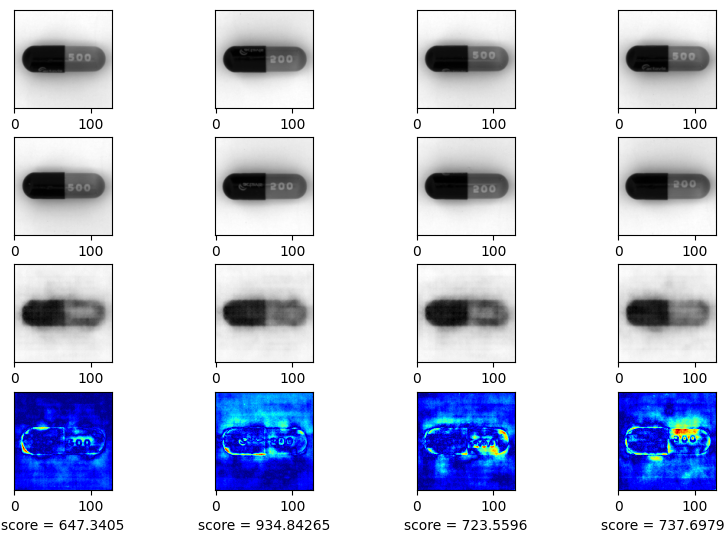

EPOCH 96/110
	 partial train loss (single batch): 0.099420
	 partial train loss (single batch): 0.065975
	 partial train loss (single batch): 0.058742
	 partial train loss (single batch): 0.096884
	 partial train loss (single batch): 0.121763
	 partial train loss (single batch): 0.050879
	 partial train loss (single batch): 0.075521
	 partial train loss (single batch): 0.054225
	 partial train loss (single batch): 0.099375
	 partial train loss (single batch): 0.062626
	 partial train loss (single batch): 0.074323
	 partial train loss (single batch): 0.034890
	 partial train loss (single batch): 0.115471
	 partial train loss (single batch): 0.041330
	 partial train loss (single batch): 0.067224
	 partial train loss (single batch): 0.089278
	 partial train loss (single batch): 0.080421
	 partial train loss (single batch): 0.054311
	 partial train loss (single batch): 0.041271
	 partial train loss (single batch): 0.053304
	 partial train loss (single batch): 0.033499
	 partial train loss 

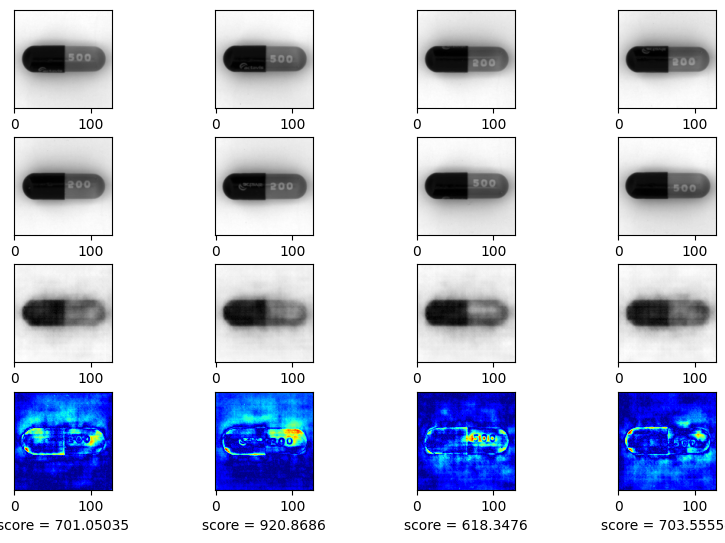

EPOCH 97/110
	 partial train loss (single batch): 0.052253
	 partial train loss (single batch): 0.029569
	 partial train loss (single batch): 0.086871
	 partial train loss (single batch): 0.066195
	 partial train loss (single batch): 0.038146
	 partial train loss (single batch): 0.085868
	 partial train loss (single batch): 0.050062
	 partial train loss (single batch): 0.038333
	 partial train loss (single batch): 0.048569
	 partial train loss (single batch): 0.050801
	 partial train loss (single batch): 0.052858
	 partial train loss (single batch): 0.065989
	 partial train loss (single batch): 0.036463
	 partial train loss (single batch): 0.029697
	 partial train loss (single batch): 0.068781
	 partial train loss (single batch): 0.075735
	 partial train loss (single batch): 0.049422
	 partial train loss (single batch): 0.080286
	 partial train loss (single batch): 0.060313
	 partial train loss (single batch): 0.065097
	 partial train loss (single batch): 0.066852
	 partial train loss 

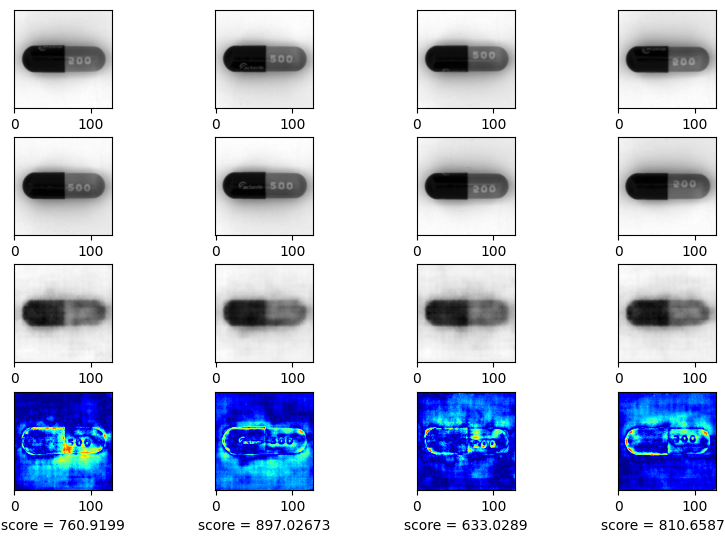

EPOCH 98/110
	 partial train loss (single batch): 0.066079
	 partial train loss (single batch): 0.047240
	 partial train loss (single batch): 0.056761
	 partial train loss (single batch): 0.054704
	 partial train loss (single batch): 0.037332
	 partial train loss (single batch): 0.058243
	 partial train loss (single batch): 0.035914
	 partial train loss (single batch): 0.052441
	 partial train loss (single batch): 0.042371
	 partial train loss (single batch): 0.039659
	 partial train loss (single batch): 0.043721
	 partial train loss (single batch): 0.031891
	 partial train loss (single batch): 0.046421
	 partial train loss (single batch): 0.045042
	 partial train loss (single batch): 0.035141
	 partial train loss (single batch): 0.048284
	 partial train loss (single batch): 0.035154
	 partial train loss (single batch): 0.053620
	 partial train loss (single batch): 0.027586
	 partial train loss (single batch): 0.030690
	 partial train loss (single batch): 0.039526
	 partial train loss 

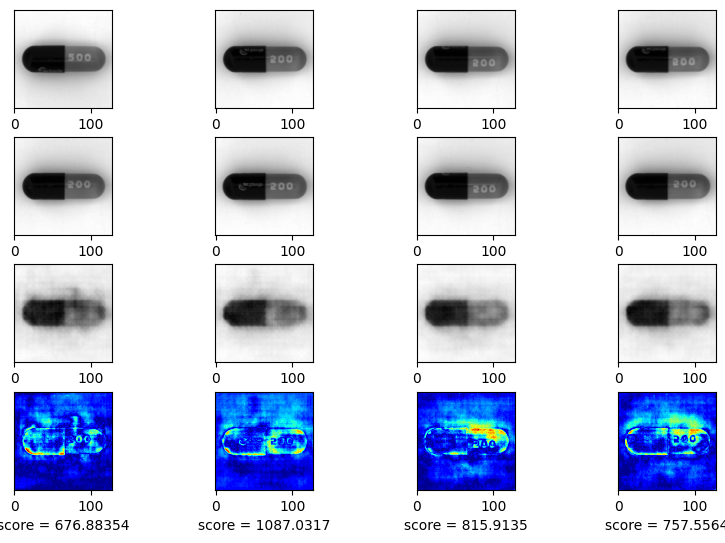

EPOCH 99/110
	 partial train loss (single batch): 0.043684
	 partial train loss (single batch): 0.031677
	 partial train loss (single batch): 0.069486
	 partial train loss (single batch): 0.054734
	 partial train loss (single batch): 0.032639
	 partial train loss (single batch): 0.029580
	 partial train loss (single batch): 0.035536
	 partial train loss (single batch): 0.048325
	 partial train loss (single batch): 0.035566
	 partial train loss (single batch): 0.024308
	 partial train loss (single batch): 0.048932
	 partial train loss (single batch): 0.054550
	 partial train loss (single batch): 0.028847
	 partial train loss (single batch): 0.033239
	 partial train loss (single batch): 0.037331
	 partial train loss (single batch): 0.033832
	 partial train loss (single batch): 0.035256
	 partial train loss (single batch): 0.038660
	 partial train loss (single batch): 0.037881
	 partial train loss (single batch): 0.037604
	 partial train loss (single batch): 0.044813
	 partial train loss 

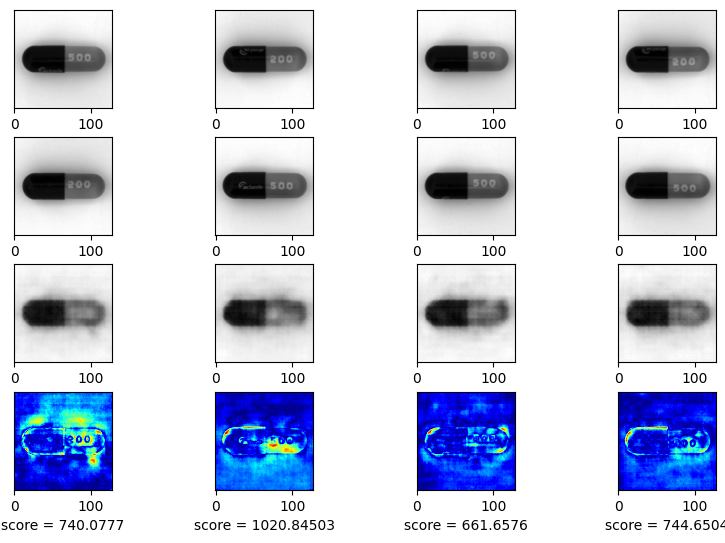

EPOCH 100/110
	 partial train loss (single batch): 0.041681
	 partial train loss (single batch): 0.036309
	 partial train loss (single batch): 0.033372
	 partial train loss (single batch): 0.033986
	 partial train loss (single batch): 0.041571
	 partial train loss (single batch): 0.035099
	 partial train loss (single batch): 0.021880
	 partial train loss (single batch): 0.046017
	 partial train loss (single batch): 0.027989
	 partial train loss (single batch): 0.032757
	 partial train loss (single batch): 0.025937
	 partial train loss (single batch): 0.030339
	 partial train loss (single batch): 0.027136
	 partial train loss (single batch): 0.027550
	 partial train loss (single batch): 0.032992
	 partial train loss (single batch): 0.077713
	 partial train loss (single batch): 0.060656
	 partial train loss (single batch): 0.072176
	 partial train loss (single batch): 0.063274
	 partial train loss (single batch): 0.081125
	 partial train loss (single batch): 0.074775
	 partial train loss

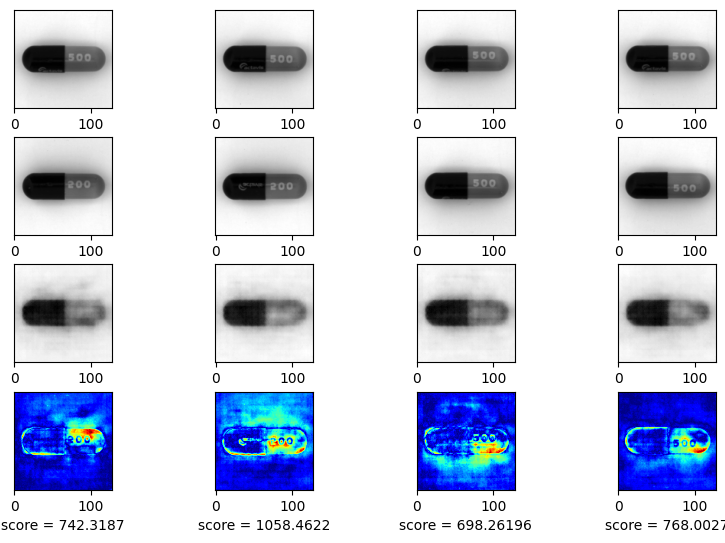

EPOCH 101/110
	 partial train loss (single batch): 0.059994
	 partial train loss (single batch): 0.057169
	 partial train loss (single batch): 0.068590
	 partial train loss (single batch): 0.038185
	 partial train loss (single batch): 0.056703
	 partial train loss (single batch): 0.060899
	 partial train loss (single batch): 0.053641
	 partial train loss (single batch): 0.039122
	 partial train loss (single batch): 0.045588
	 partial train loss (single batch): 0.042045
	 partial train loss (single batch): 0.043683
	 partial train loss (single batch): 0.051322
	 partial train loss (single batch): 0.037029
	 partial train loss (single batch): 0.032415
	 partial train loss (single batch): 0.047967
	 partial train loss (single batch): 0.033281
	 partial train loss (single batch): 0.032437
	 partial train loss (single batch): 0.032936
	 partial train loss (single batch): 0.028237
	 partial train loss (single batch): 0.020871
	 partial train loss (single batch): 0.035785
	 partial train loss

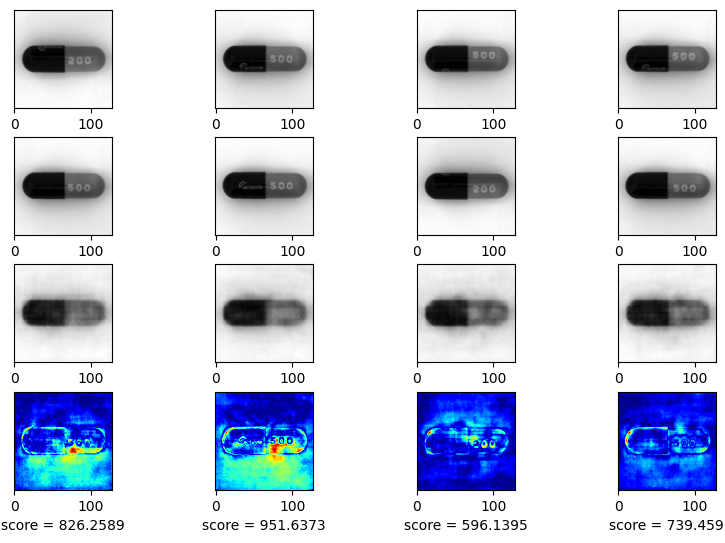

EPOCH 102/110
	 partial train loss (single batch): 0.029072
	 partial train loss (single batch): 0.030605
	 partial train loss (single batch): 0.022198
	 partial train loss (single batch): 0.021185
	 partial train loss (single batch): 0.025883
	 partial train loss (single batch): 0.019420
	 partial train loss (single batch): 0.024076
	 partial train loss (single batch): 0.027495
	 partial train loss (single batch): 0.027785
	 partial train loss (single batch): 0.023108
	 partial train loss (single batch): 0.017607
	 partial train loss (single batch): 0.024128
	 partial train loss (single batch): 0.014644
	 partial train loss (single batch): 0.017295
	 partial train loss (single batch): 0.026325
	 partial train loss (single batch): 0.015724
	 partial train loss (single batch): 0.021117
	 partial train loss (single batch): 0.018382
	 partial train loss (single batch): 0.017117
	 partial train loss (single batch): 0.014189
	 partial train loss (single batch): 0.015630
	 partial train loss

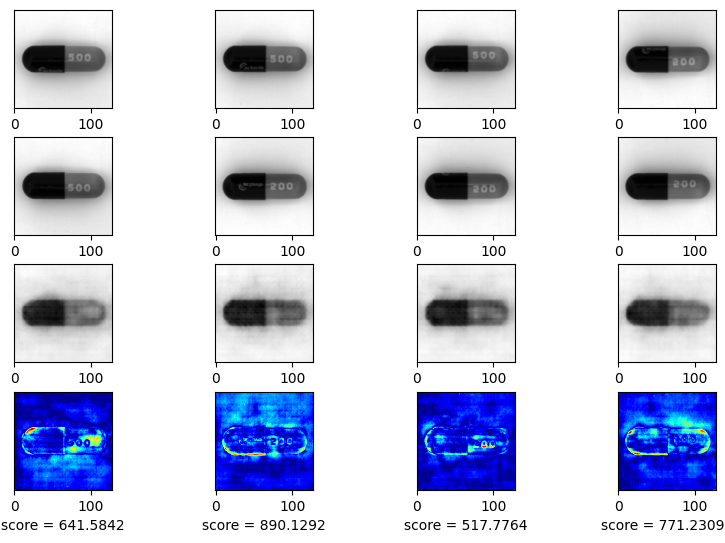

EPOCH 103/110
	 partial train loss (single batch): 0.020969
	 partial train loss (single batch): 0.013525
	 partial train loss (single batch): 0.009511
	 partial train loss (single batch): 0.019590
	 partial train loss (single batch): 0.017132
	 partial train loss (single batch): 0.011756
	 partial train loss (single batch): 0.013366
	 partial train loss (single batch): 0.011793
	 partial train loss (single batch): 0.009728
	 partial train loss (single batch): 0.011276
	 partial train loss (single batch): 0.009461
	 partial train loss (single batch): 0.012618
	 partial train loss (single batch): 0.010157
	 partial train loss (single batch): 0.015475
	 partial train loss (single batch): 0.013469
	 partial train loss (single batch): 0.012252
	 partial train loss (single batch): 0.008447
	 partial train loss (single batch): 0.011897
	 partial train loss (single batch): 0.011855
	 partial train loss (single batch): 0.011184
	 partial train loss (single batch): 0.011596
	 partial train loss

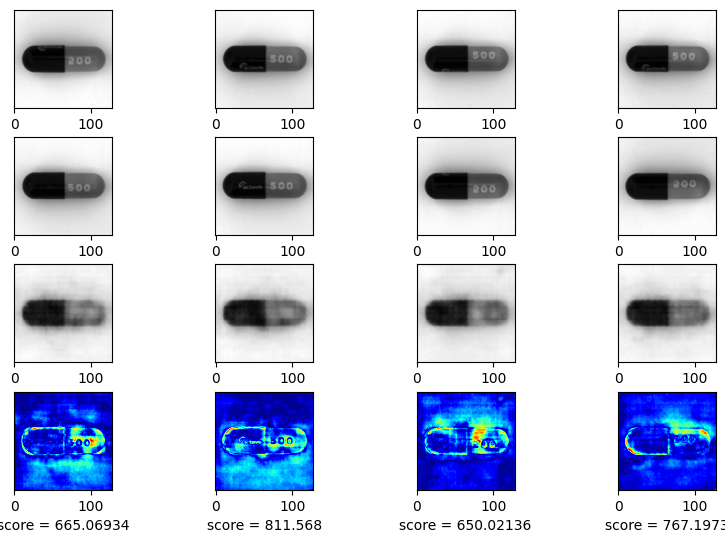

EPOCH 104/110
	 partial train loss (single batch): 0.009449
	 partial train loss (single batch): 0.016581
	 partial train loss (single batch): 0.013053
	 partial train loss (single batch): 0.011518
	 partial train loss (single batch): 0.017257
	 partial train loss (single batch): 0.016953
	 partial train loss (single batch): 0.025996
	 partial train loss (single batch): 0.015295
	 partial train loss (single batch): 0.035270
	 partial train loss (single batch): 0.021048
	 partial train loss (single batch): 0.022662
	 partial train loss (single batch): 0.024782
	 partial train loss (single batch): 0.017316
	 partial train loss (single batch): 0.021321
	 partial train loss (single batch): 0.016830
	 partial train loss (single batch): 0.016782
	 partial train loss (single batch): 0.014319
	 partial train loss (single batch): 0.015712
	 partial train loss (single batch): 0.013822
	 partial train loss (single batch): 0.013879
	 partial train loss (single batch): 0.014428
	 partial train loss

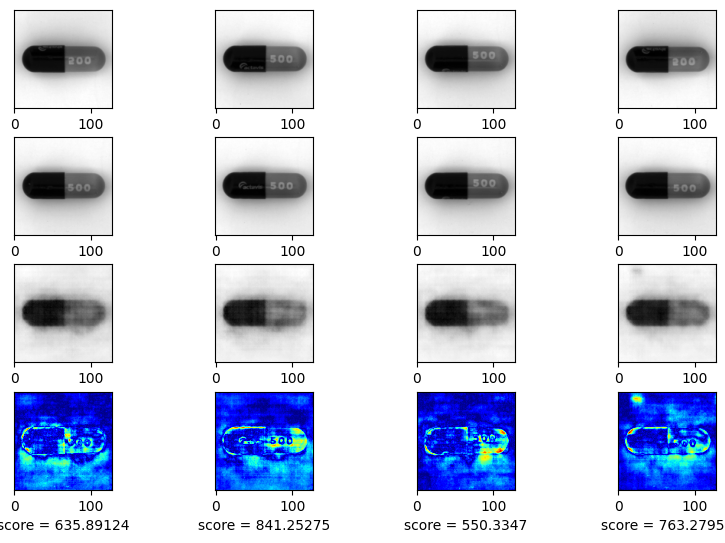

EPOCH 105/110
	 partial train loss (single batch): 0.031396
	 partial train loss (single batch): 0.019117
	 partial train loss (single batch): 0.017584
	 partial train loss (single batch): 0.021250
	 partial train loss (single batch): 0.009567
	 partial train loss (single batch): 0.017495
	 partial train loss (single batch): 0.025433
	 partial train loss (single batch): 0.022907
	 partial train loss (single batch): 0.033498
	 partial train loss (single batch): 0.044046
	 partial train loss (single batch): 0.073262
	 partial train loss (single batch): 0.048316
	 partial train loss (single batch): 0.079484
	 partial train loss (single batch): 0.068843
	 partial train loss (single batch): 0.057740
	 partial train loss (single batch): 0.063804
	 partial train loss (single batch): 0.048483
	 partial train loss (single batch): 0.087802
	 partial train loss (single batch): 0.038464
	 partial train loss (single batch): 0.065787
	 partial train loss (single batch): 0.057031
	 partial train loss

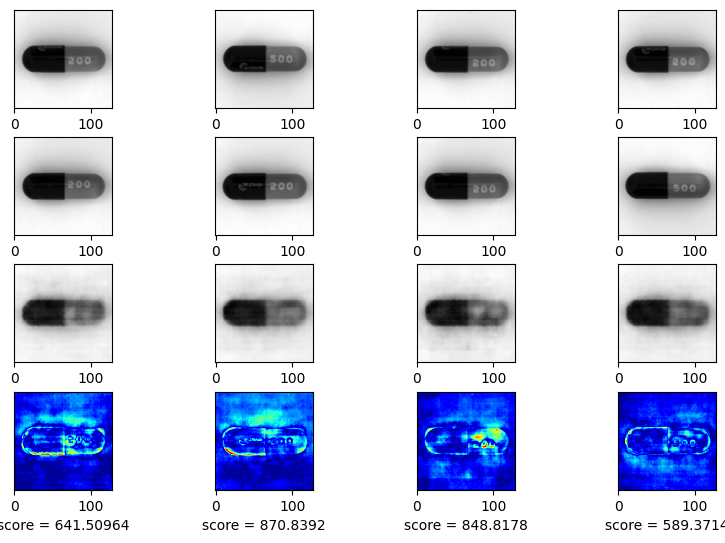

EPOCH 106/110
	 partial train loss (single batch): 0.092312
	 partial train loss (single batch): 0.052115
	 partial train loss (single batch): 0.149456
	 partial train loss (single batch): 0.309926
	 partial train loss (single batch): 0.228926
	 partial train loss (single batch): 0.326918
	 partial train loss (single batch): 0.269979
	 partial train loss (single batch): 0.380307
	 partial train loss (single batch): 0.475652
	 partial train loss (single batch): 0.184779
	 partial train loss (single batch): 0.354366
	 partial train loss (single batch): 0.359460
	 partial train loss (single batch): 0.226783
	 partial train loss (single batch): 0.237883
	 partial train loss (single batch): 0.333002
	 partial train loss (single batch): 0.479431
	 partial train loss (single batch): 0.184964
	 partial train loss (single batch): 0.517286
	 partial train loss (single batch): 0.247721
	 partial train loss (single batch): 0.301067
	 partial train loss (single batch): 0.208428
	 partial train loss

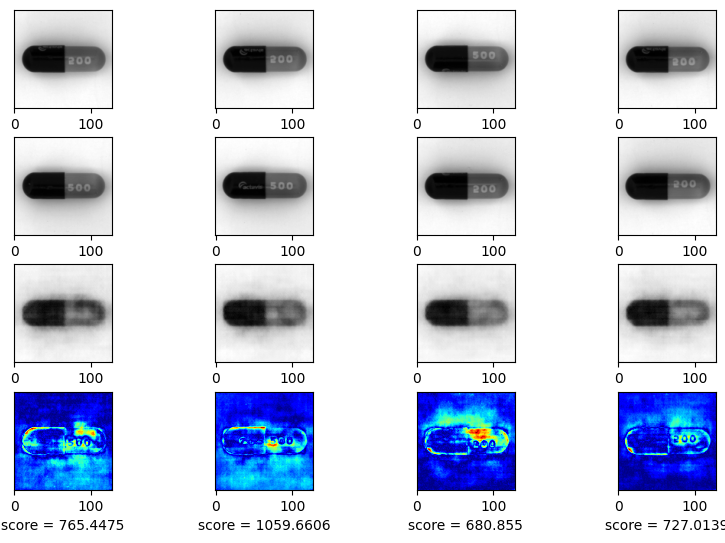

EPOCH 107/110
	 partial train loss (single batch): 0.262904
	 partial train loss (single batch): 0.240949
	 partial train loss (single batch): 0.166082
	 partial train loss (single batch): 0.198336
	 partial train loss (single batch): 0.155730
	 partial train loss (single batch): 0.133395
	 partial train loss (single batch): 0.164447
	 partial train loss (single batch): 0.107081
	 partial train loss (single batch): 0.134537
	 partial train loss (single batch): 0.106553
	 partial train loss (single batch): 0.260839
	 partial train loss (single batch): 0.113532
	 partial train loss (single batch): 0.198579
	 partial train loss (single batch): 0.152241
	 partial train loss (single batch): 0.185030
	 partial train loss (single batch): 0.100043
	 partial train loss (single batch): 0.122358
	 partial train loss (single batch): 0.150988
	 partial train loss (single batch): 0.179768
	 partial train loss (single batch): 0.139710
	 partial train loss (single batch): 0.246202
	 partial train loss

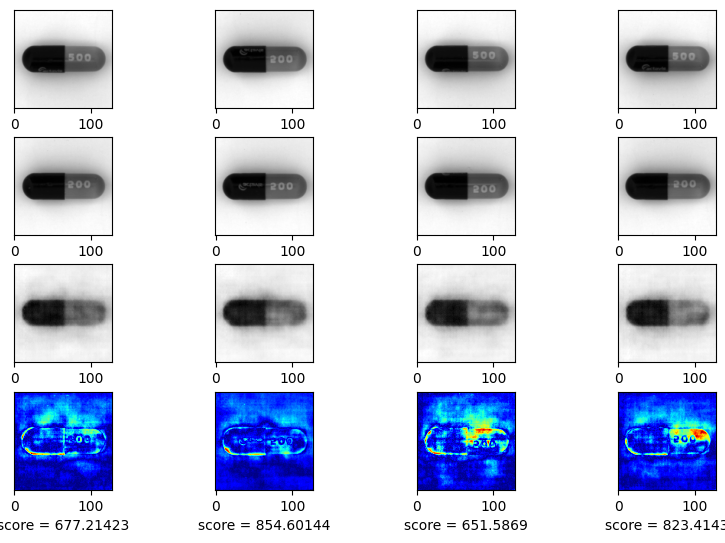

EPOCH 108/110
	 partial train loss (single batch): 0.164250
	 partial train loss (single batch): 0.176393
	 partial train loss (single batch): 0.144683
	 partial train loss (single batch): 0.140629
	 partial train loss (single batch): 0.135423
	 partial train loss (single batch): 0.098573
	 partial train loss (single batch): 0.089344
	 partial train loss (single batch): 0.112624
	 partial train loss (single batch): 0.137459
	 partial train loss (single batch): 0.090492
	 partial train loss (single batch): 0.104279
	 partial train loss (single batch): 0.058021
	 partial train loss (single batch): 0.109014
	 partial train loss (single batch): 0.085459
	 partial train loss (single batch): 0.086475
	 partial train loss (single batch): 0.066438
	 partial train loss (single batch): 0.095909
	 partial train loss (single batch): 0.045760
	 partial train loss (single batch): 0.065330
	 partial train loss (single batch): 0.054519
	 partial train loss (single batch): 0.093020
	 partial train loss

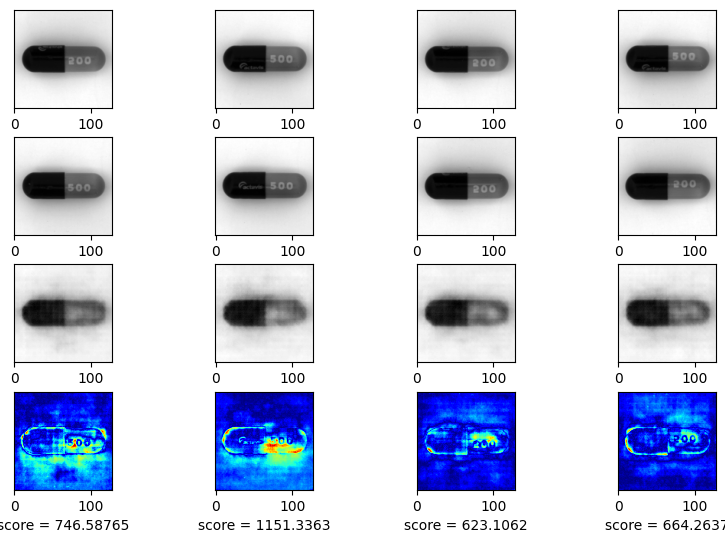

EPOCH 109/110
	 partial train loss (single batch): 0.057657
	 partial train loss (single batch): 0.062362
	 partial train loss (single batch): 0.059194
	 partial train loss (single batch): 0.049863
	 partial train loss (single batch): 0.037556
	 partial train loss (single batch): 0.041504
	 partial train loss (single batch): 0.058601
	 partial train loss (single batch): 0.054860
	 partial train loss (single batch): 0.063723
	 partial train loss (single batch): 0.044502
	 partial train loss (single batch): 0.052956
	 partial train loss (single batch): 0.044257
	 partial train loss (single batch): 0.053839
	 partial train loss (single batch): 0.042650
	 partial train loss (single batch): 0.053900
	 partial train loss (single batch): 0.057907
	 partial train loss (single batch): 0.056450
	 partial train loss (single batch): 0.040827
	 partial train loss (single batch): 0.046901
	 partial train loss (single batch): 0.043146
	 partial train loss (single batch): 0.043987
	 partial train loss

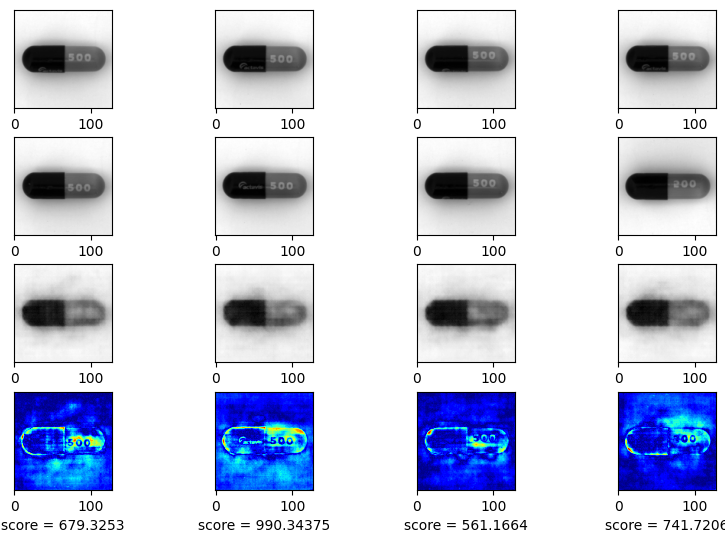

EPOCH 110/110
	 partial train loss (single batch): 0.030331
	 partial train loss (single batch): 0.033333
	 partial train loss (single batch): 0.029763
	 partial train loss (single batch): 0.023161
	 partial train loss (single batch): 0.029457
	 partial train loss (single batch): 0.025074
	 partial train loss (single batch): 0.032624
	 partial train loss (single batch): 0.018162
	 partial train loss (single batch): 0.041547
	 partial train loss (single batch): 0.022037
	 partial train loss (single batch): 0.036385
	 partial train loss (single batch): 0.026286
	 partial train loss (single batch): 0.031266
	 partial train loss (single batch): 0.038538
	 partial train loss (single batch): 0.103044
	 partial train loss (single batch): 0.080098
	 partial train loss (single batch): 0.029429
	 partial train loss (single batch): 0.050027
	 partial train loss (single batch): 0.046936
	 partial train loss (single batch): 0.056373
	 partial train loss (single batch): 0.038901
	 partial train loss

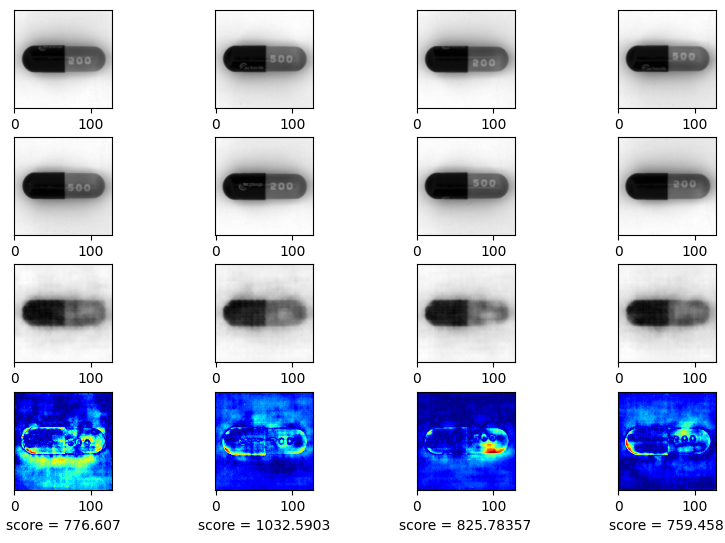

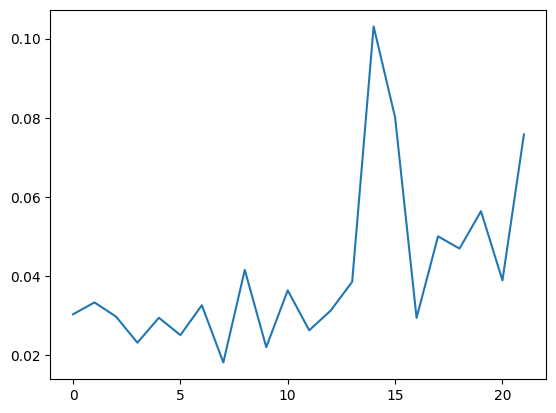

In [ ]:
import dill
from pytorch_msssim import SSIM, MS_SSIM
num_epochs =110
#loss_fn = nn.L1Loss()
loss_fn = nn.MSELoss()
history_da={'train_loss':[], 'val_loss':[], 'pair_train_loss':[], 'score': []}

#autoencoder = torch.load( 'Denoise_autoencoder.pth', pickle_module = dill)

for epoch in range(num_epochs):
  print('EPOCH %d/%d' % (epoch + 1, num_epochs))

  pair_train_loss, train_loss = train_epoch(
      autoencoder=vae,
      device=device,
      dataloader=capsule_trainloader,
      optimizer=optimizer,
      loss_fn =loss_fn
  )

  val_loss = test_epoch(
      autoencoder=vae,
      device=device,
      dataloader=capsule_validloader,
      loss_fn = loss_fn
  )
  # Print Validationloss
  history_da['train_loss'].append(train_loss)
  history_da['val_loss'].append(val_loss)
  print('\n EPOCH {}/{} \t train loss {:.3f} \t val loss {:.3f}'.format(epoch + 1, num_epochs,pair_train_loss,val_loss))
  plot_ae_outputs_den(vae)
plt.plot(train_loss)
torch.save(vae, 'vae_capsule_ssim.pth',pickle_module = dill)





In [ ]:
from skimage.metrics import structural_similarity as ski_ssim
from pytorch_msssim import SSIM, MS_SSIM
import dill
autoencoder = torch.load('vae_capsule_ssim.pth',pickle_module = dill)
test_transform = transforms.Compose([transforms.Resize([224,224]),transforms.Grayscale(),transforms.ToTensor()])

def image_reconstructed_plot(model: torch.nn.Module,
                             image_path: str,
                             transform=None,
                             device: torch.device = device):

    """ Plots image before and after passing through autoencoder, and SSIM contour """

    fig, ax = plt.subplots(1, 3)
    plt.gray()

    img = Image.open(image_path)

    if transform:
        img_transformed = transform(img)

    model.to(device)
    model.eval()
    with torch.inference_mode():
        input_image = img_transformed.unsqueeze(dim=0).to(device)
        print(input_image.shape)
        reconstructed , _, _= model(input_image)

    original = img_transformed.permute(1, 2, 0).cpu()

    #defect = image_path.split("/")

    ax[0].imshow(original)
    ax[0].set_title(f"original_imge")
    ax[0].axis("off")

    reconstructed = reconstructed.squeeze(0).permute(1, 2, 0).cpu()
    ax[1].imshow(reconstructed)
    ax[1].set_title("Reconstructed")
    ax[1].axis("off")

    img_old = np.array(original.squeeze(2))
    print(type(img_old))
    img_new = np.array(reconstructed.squeeze(2))
    _, S = ski_ssim(img_old, img_new, full=True,data_range=1.0, channel_axis=False)

    ax[2].imshow(1-S, vmax = 1, cmap='jet')
    ax[2].set_title("SSIM")
    ax[2].axis("off")

    plt.axis(False)
    plt.show()
    ssim_score, dim = ssim(img_old, img_new, full=True,data_range=1.0)
    print('ssim_score: ',ssim_score)

In [ ]:
ctest_good_image = mvtec_path / "capsule/test/good/000.png"
ctest_f_image = mvtec_path / "capsule/test/faulty_imprint/000.png"
ctest_p_image = mvtec_path / "capsule/test/poke/000.png"
ctest_sc_image = mvtec_path / "capsule/test/scratch/000.png"
ctest_sq_image = mvtec_path / "capsule/test/squeeze/000.png"

torch.Size([1, 1, 224, 224])
<class 'numpy.ndarray'>


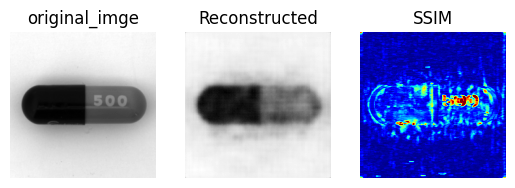

ssim_score:  0.863777502208427
torch.Size([1, 1, 224, 224])
<class 'numpy.ndarray'>


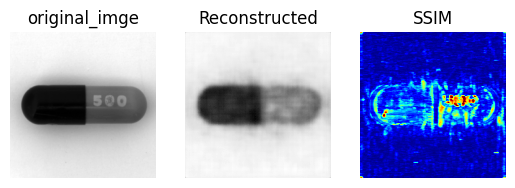

ssim_score:  0.8592688190037789
torch.Size([1, 1, 224, 224])
<class 'numpy.ndarray'>


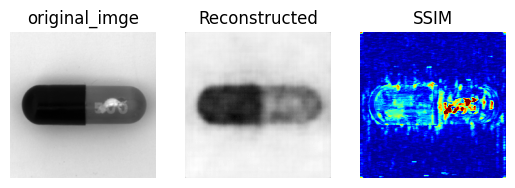

ssim_score:  0.8495315696730243
torch.Size([1, 1, 224, 224])
<class 'numpy.ndarray'>


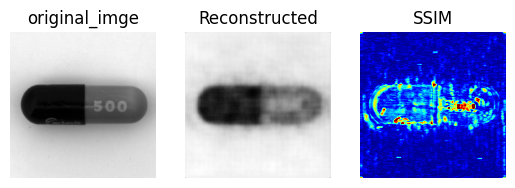

ssim_score:  0.8510217027019465
torch.Size([1, 1, 224, 224])
<class 'numpy.ndarray'>


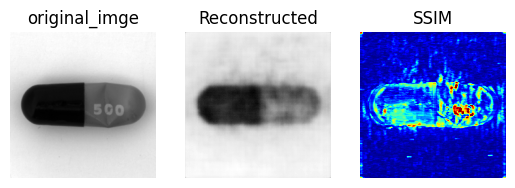

ssim_score:  0.8263980721357391


In [ ]:
image_reconstructed_plot(autoencoder, ctest_good_image, transform = test_transform)
image_reconstructed_plot(autoencoder, ctest_f_image, transform = test_transform)
image_reconstructed_plot(autoencoder, ctest_p_image, transform = test_transform)
image_reconstructed_plot(autoencoder, ctest_sc_image, transform = test_transform)
image_reconstructed_plot(autoencoder, ctest_sq_image, transform = test_transform)